# Network Analysis

## Data Interpretation

**Participants**

    The Dataset is composed of 34 adults (age 20-66)
    Participants are bilingual speakers who can speak both Spanish (L1) and Basque (Ln/L2)
    Participants are separated into advanced (16) and basic (18) language groups (dependent on proficiency of Basque)

**Tasks**

Performed semantic animacy judgment task (decide whether something is living or non living) via button presses using dominant hand

    Single words (nouns) were presented visually and auditorily 
    Three runs per language (6 runs total)
    Each run had 48 stimuli with intermixed reading and listening trials 
    Visual stimuli displayed for 1000 ms at a visual angle of 4° - 6°
    Auditory stimuli had a mean duration of 565 ms (𝛔 = 86 ms)
    Baseline condition consisted of a fixed cross in the center of the screen

# Module A

## Average ICA Vizualization

### Quantitative analysis of spatial overlap between ICA

## L1

This performs quantitative analysis of spatial overlap between ICA (Independent Component Analysis) components from fMRI data and a parcellated brain atlas (specifically the 1000-parcel Schaefer Yeo 7-network atlas).

In [5]:
import os
import glob
import numpy as np
import nibabel as nib
import pandas as pd
from nilearn import image, masking, plotting
from nilearn.image import resample_to_img

# Paths
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_L1_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

# Step 1: Load ICA Components (sorted)
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# Step 2: Load atlas
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# Step 3: Load network labels from the text file (1000 lines)
with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

# Parse network name from label line (format: "7Networks_LH_Vis_1")
network_names = [label.split('_')[2] for label in labels]  # e.g., Vis, SomMot, DorsAttn, SalVentAttn, Limbic, Cont, Default

# Step 4: Map each parcel to a Yeo network (1–7 based on network_names)
unique_networks = sorted(set(network_names), key=network_names.index)  # preserve order
network_id_map = {name: idx+1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names])  # length 1000

# Step 5: Create a 3D map where each voxel's value = Yeo network ID (1–7)
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):  # parcel indices are from 1 to 1000
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

# Step 6: For each ICA component, compute overlap with each network
results = []

for comp_idx, comp_img in enumerate(ica_imgs):
    # Resample to match atlas
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()

    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold
    
    for net_id in range(1, 8):  # networks 1 to 7
        network_voxels = atlas_network_map == net_id
        overlap = np.sum(active_voxels & network_voxels)
        results.append({
            "Component": f"ICA_{comp_idx+1}",
            "Network_ID": net_id,
            "Network_Name": [k for k, v in network_id_map.items() if v == net_id][0],
            "Overlap_Voxels": overlap
        })

# Step 7: Convert to DataFrame for easier analysis
df = pd.DataFrame(results)
df_pivot = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)

# Print / save results
print(df_pivot)

# Optional: Save to CSV
df_pivot.to_csv("ica_network_overlap_L1.csv")

Network_Name  Cont  Default  DorsAttn  Limbic  SalVentAttn  SomMot   Vis
Component                                                               
ICA_1         3427     5820      3151    1291         2108    6707  2780
ICA_10        3817     8124      2967    1213         2274    5912  1753
ICA_2         6767     6607      1898       0         2393     328  7147
ICA_3         4345     8506      2800    1089         2819    5783  1361
ICA_4         3006     4219      5369     306         2331    9183  1937
ICA_5         2221     5500      1985    1382         2344    6739  4513
ICA_6         5797     7332      3176    1221         2818    6329  1787
ICA_7         3803     9872      1097    3125         2072    3134  2237
ICA_8         6231     8260      1321    2706         2827    3578  1127
ICA_9         1833     7141      3008    1015         1078    2835  6770


/Users/onilarasanjala/mambaforge/envs/neuro_project/lib/python3.9/site-packages/nilearn/plotting/find_cuts.py:143: UserWarning: Could not determine cut coords: All voxels were masked by the thresholding. Returning the center of mass instead.
  warnings.warn(
/Users/onilarasanjala/mambaforge/envs/neuro_project/lib/python3.9/site-packages/nilearn/plotting/displays/_slicers.py:382: UserWarning: empty mask
  get_mask_bounds(new_img_like(img, not_mask, affine))


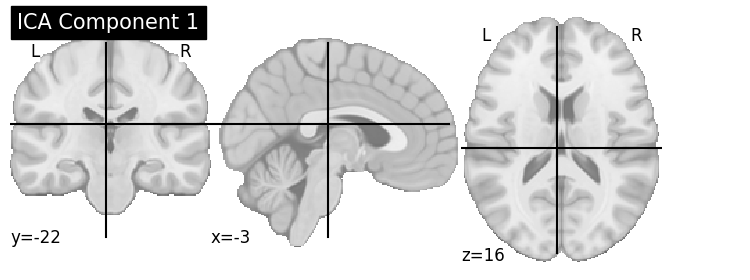

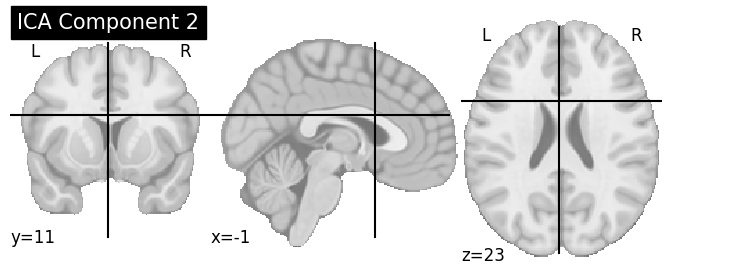

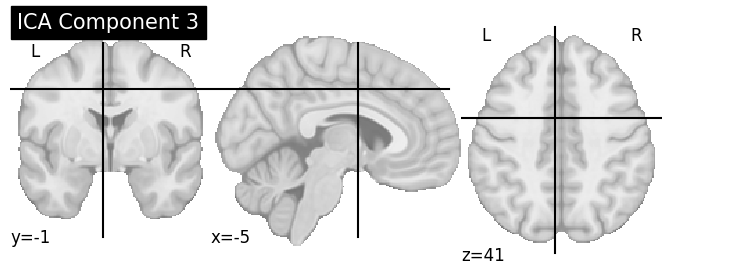

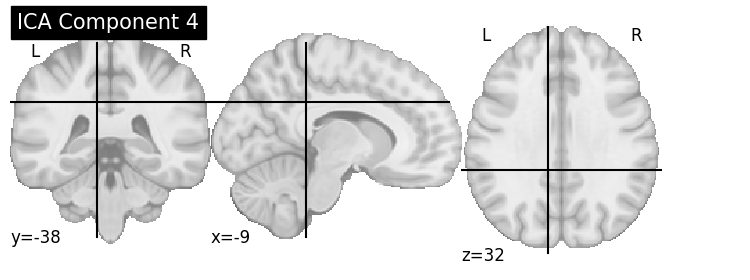

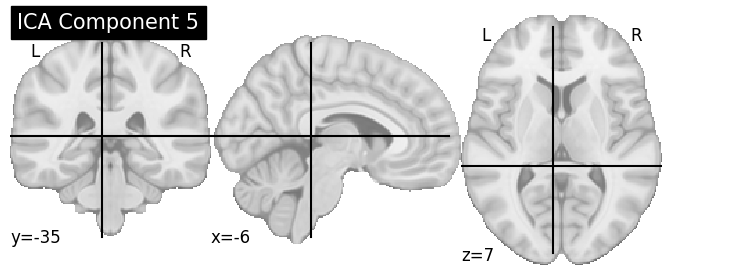

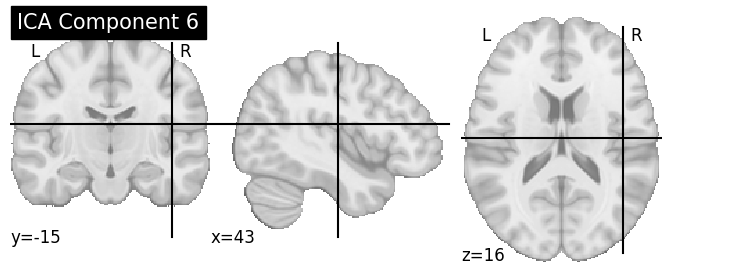

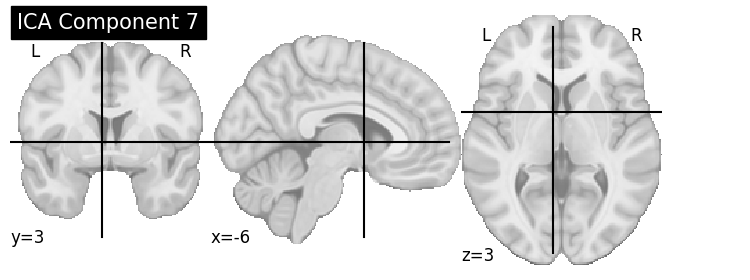

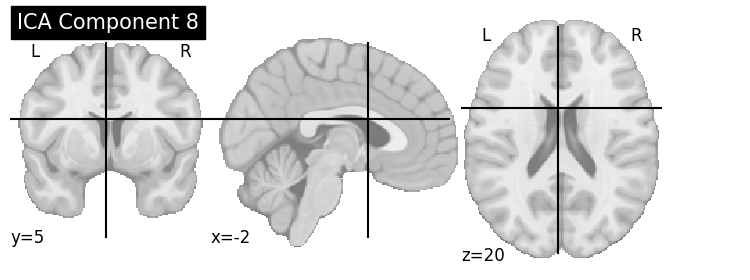

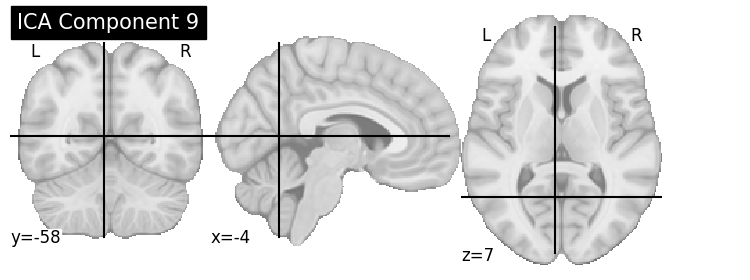

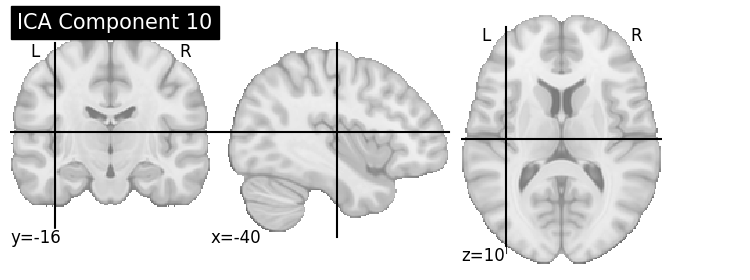

In [6]:
from nilearn.plotting import plot_stat_map

for i, comp_img in enumerate(ica_imgs):
    plot_stat_map(comp_img, title=f"ICA Component {i+1}", threshold=2.0, display_mode='ortho')

This script takes ICA components and identifies which brain network (from the Yeo 7-network atlas) each component overlaps with the most. It then creates a new 3D brain image where active voxels are labeled by their dominant network and visualizes it as a glass brain plot, showing the spatial distribution of ICA-network mappings.

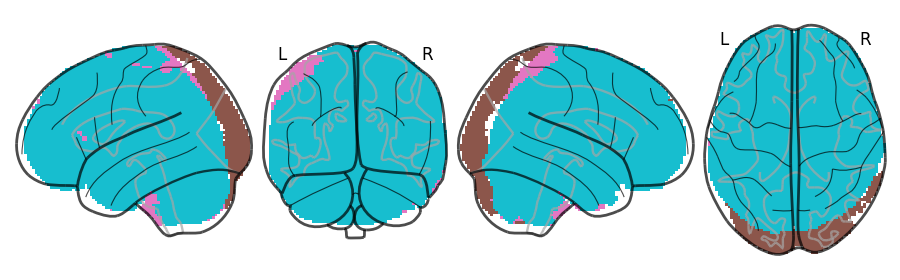

In [9]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from nltools.data import Brain_Data
from nilearn import plotting

# DataFrame `df` from the overlap results
# Find which network each ICA component overlaps with most:
top_networks = df.groupby('Component').apply(lambda x: x.loc[x['Overlap_Voxels'].idxmax()])
top_networks = top_networks.reset_index(drop=True)

# Create a labeled 3D array with same shape as the atlas, initialized to 0
network_labels = np.zeros_like(atlas_data)

for i, row in top_networks.iterrows():
    net_id = row['Network_ID']
    component_index = int(row['Component'].split('_')[1]) - 1  # from ICA_1 to index 0
    comp_img = ica_imgs[component_index]
    
    # Resample component to atlas
    resampled = resample_to_img(comp_img, atlas_img)
    comp_data = resampled.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold
    
    # Assign component ID or net_id to those voxels in output image
    network_labels[active_voxels] = net_id

# Save or display using Brain_Data
net_nifti = nib.Nifti1Image(network_labels, affine=atlas_img.affine)
nx = Brain_Data(net_nifti)
nx.data = nx.data.astype(float)  # make sure it's float for plotting

# Visualization
figdir = "./figures"
os.makedirs(figdir, exist_ok=True)
output_path = os.path.join(figdir, "networks.pdf")

# Choose a color map (e.g., 'tab10' for 10 distinct colors)
network_cmap = plt.get_cmap('tab10')

plotting.plot_glass_brain(nx.to_nifti(), cmap=network_cmap, display_mode='lyrz', output_file=output_path)
plotting.plot_glass_brain(nx.to_nifti(), cmap=network_cmap, display_mode='lyrz')

From the earlier DataFrame df (which contains voxel overlaps between ICA components and Yeo networks), it selects the network with the most overlap for each ICA component.

## Assign each ICA component a unique value and color

This computes how strongly each ICA component overlaps with each of the 7 Yeo brain networks using voxel counts. It builds a table (df_pivot) of overlaps, then visualizes which brain regions are active in each ICA component by coloring active voxels with a unique color for each component. This helps interpret the spatial distribution of ICA-derived networks and their correspondence to known functional networks.

Visualizes voxel-wise network assignment or per-component activation.

Network_Name  Cont  Default  DorsAttn  Limbic  SalVentAttn  SomMot   Vis
Component                                                               
ICA_1         3427     5820      3151    1291         2108    6707  2780
ICA_10        3817     8124      2967    1213         2274    5912  1753
ICA_2         6767     6607      1898       0         2393     328  7147
ICA_3         4345     8506      2800    1089         2819    5783  1361
ICA_4         3006     4219      5369     306         2331    9183  1937
ICA_5         2221     5500      1985    1382         2344    6739  4513
ICA_6         5797     7332      3176    1221         2818    6329  1787
ICA_7         3803     9872      1097    3125         2072    3134  2237
ICA_8         6231     8260      1321    2706         2827    3578  1127
ICA_9         1833     7141      3008    1015         1078    2835  6770


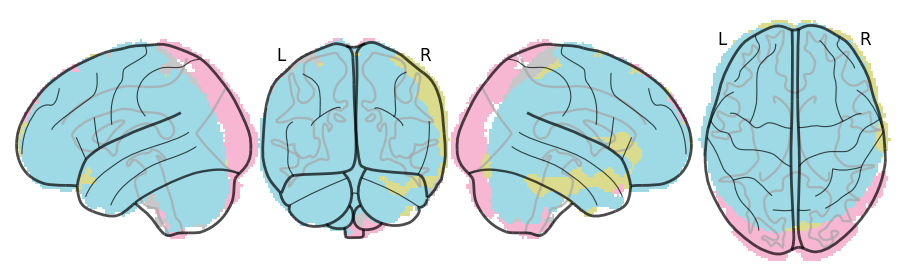

In [171]:
import os
import glob
import numpy as np
import nibabel as nib
import pandas as pd
from nilearn import image, masking, plotting
from nilearn.image import resample_to_img

# Paths
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_L1_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

# Step 1: Load ICA Components (sorted)
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# Step 2: Load atlas
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# Step 3: Load network labels from the text file (1000 lines)
with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

# Parse network name from label line (format: "7Networks_LH_Vis_1")
network_names = [label.split('_')[2] for label in labels]  # e.g., Vis, SomMot, DorsAttn, SalVentAttn, Limbic, Cont, Default

# Step 4: Map each parcel to a Yeo network (1–7 based on network_names)
unique_networks = sorted(set(network_names), key=network_names.index)  # preserve order
network_id_map = {name: idx+1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names])  # length 1000

# Step 5: Create a 3D map where each voxel's value = Yeo network ID (1–7)
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):  # parcel indices are from 1 to 1000
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

# Step 6: For each ICA component, compute overlap with each network
results = []

for comp_idx, comp_img in enumerate(ica_imgs):
    # Resample to match atlas
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()

    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold
    
    for net_id in range(1, 8):  # networks 1 to 7
        network_voxels = atlas_network_map == net_id
        overlap = np.sum(active_voxels & network_voxels)
        results.append({
            "Component": f"ICA_{comp_idx+1}",
            "Network_ID": net_id,
            "Network_Name": [k for k, v in network_id_map.items() if v == net_id][0],
            "Overlap_Voxels": overlap
        })

# Step 7: Convert to DataFrame for easier analysis
df = pd.DataFrame(results)
df_pivot = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)

# Create an empty 3D image for visualization
visualization_img = np.zeros_like(atlas_data)

for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Instead of assigning net_id, assign a unique color code for each component
    visualization_img[active_voxels] = comp_idx + 1  # +1 to avoid 0

# Convert to NIfTI image
from nilearn.image import new_img_like
vis_img = new_img_like(atlas_img, visualization_img)

# Define a colormap with enough colors
from matplotlib.colors import ListedColormap
colors = plt.cm.tab20(np.linspace(0, 1, len(ica_imgs)))
cmap = ListedColormap(colors)

# Plot the image with multiple distinct colors
plotting.plot_glass_brain(vis_img, cmap=cmap, display_mode='lyrz')

# Print / save results
print(df_pivot)

# Optional: Save to CSV
df_pivot.to_csv("ica_network_overlap_L1.csv")

### Assigns labels and colors based on the ICA components, not the networks themselves

Shows which voxels belong to which ICA component based on dominant network

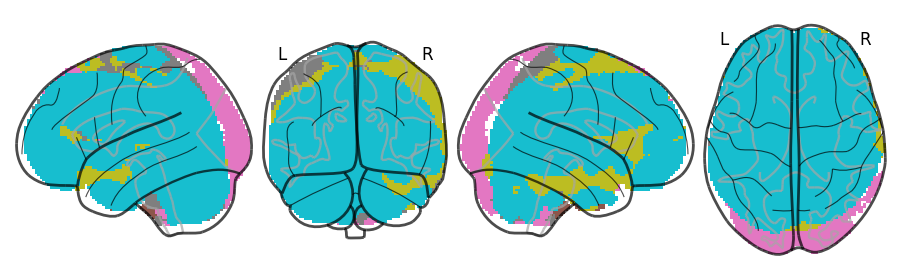

In [172]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from nltools.data import Brain_Data
from nilearn import plotting

# DataFrame `df` from the overlap results
# Find which network each ICA component overlaps with most:
top_networks = df.groupby('Component').apply(lambda x: x.loc[x['Overlap_Voxels'].idxmax()])
top_networks = top_networks.reset_index(drop=True)

# Create a labeled 3D array with same shape as the atlas, initialized to 0
network_labels = np.zeros_like(atlas_data)

for i, row in top_networks.iterrows():
    net_id = row['Network_ID']
    component_index = int(row['Component'].split('_')[1]) - 1  # from ICA_1 to index 0
    comp_img = ica_imgs[component_index]
    
    # Resample component to atlas
    resampled = resample_to_img(comp_img, atlas_img)
    comp_data = resampled.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold
    
    # plot ICA components instead
    network_labels[active_voxels] = component_index + 1

# Save or display using Brain_Data
net_nifti = nib.Nifti1Image(network_labels, affine=atlas_img.affine)
nx = Brain_Data(net_nifti)
nx.data = nx.data.astype(float)  # make sure it's float for plotting

# Visualization
figdir = "./figures"
os.makedirs(figdir, exist_ok=True)
output_path = os.path.join(figdir, "networks.pdf")

# Choose a color map (e.g., 'tab10' for 10 distinct colors)
network_cmap = plt.get_cmap('tab10')

plotting.plot_glass_brain(nx.to_nifti(), cmap=network_cmap, display_mode='lyrz', output_file=output_path)
plotting.plot_glass_brain(nx.to_nifti(), cmap=network_cmap, display_mode='lyrz')

In [173]:
# Save the labeled image as .nii.gz:
nib.save(net_nifti, os.path.join(figdir, "network_label_map.nii.gz"))

/Users/onilarasanjala/mambaforge/envs/neuro_project/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



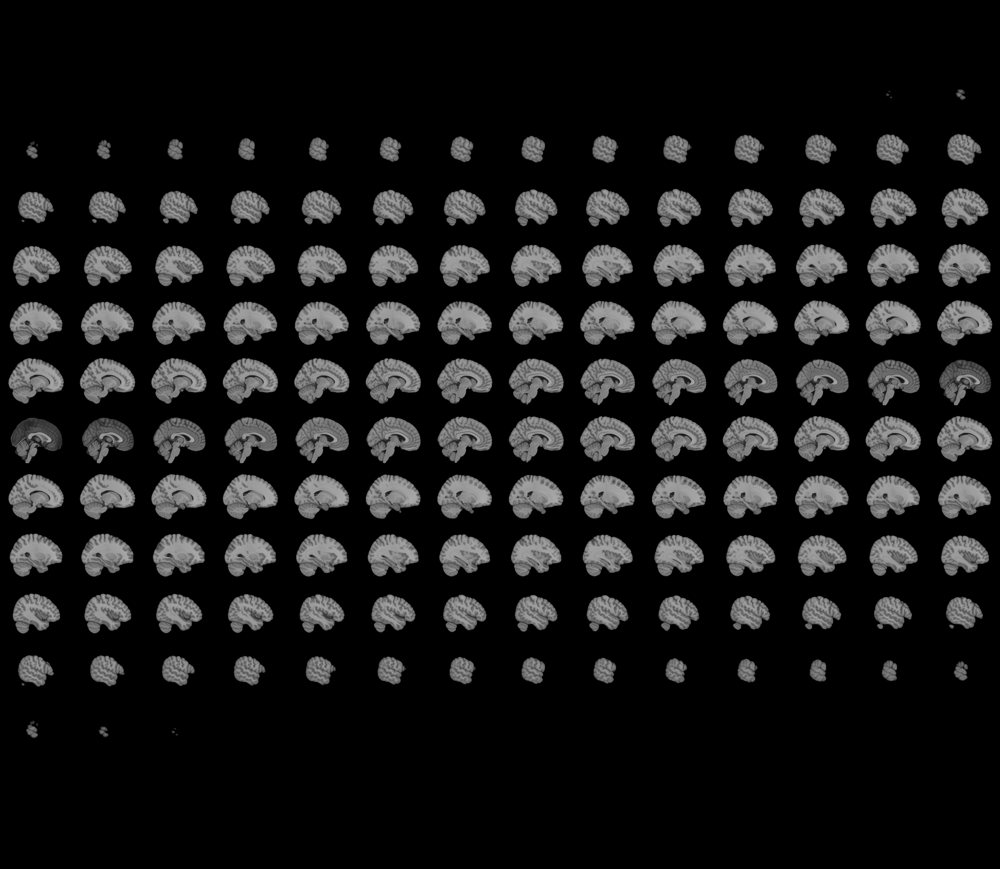
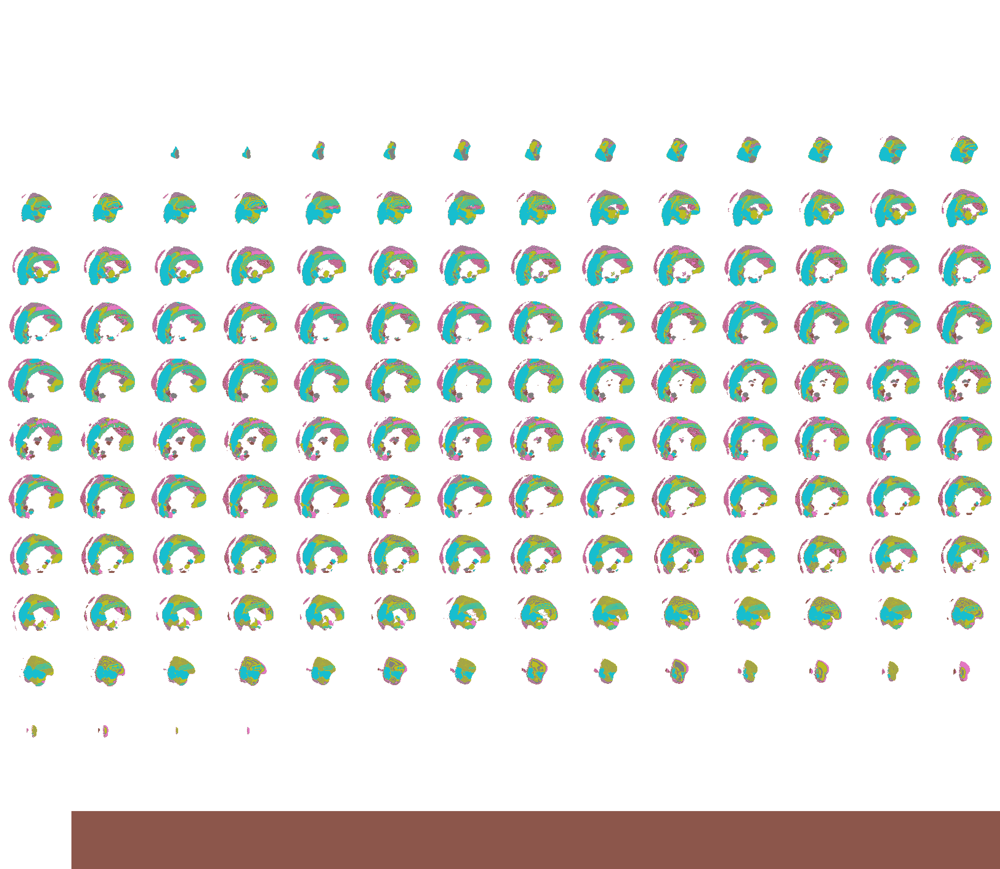

In [174]:
plotting.view_img(nx.to_nifti(), cmap=network_cmap)

/var/folders/t5/2x7db7gn5cvcnqkt970hp7hc0000gn/T/ipykernel_2403/433971021.py:23: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


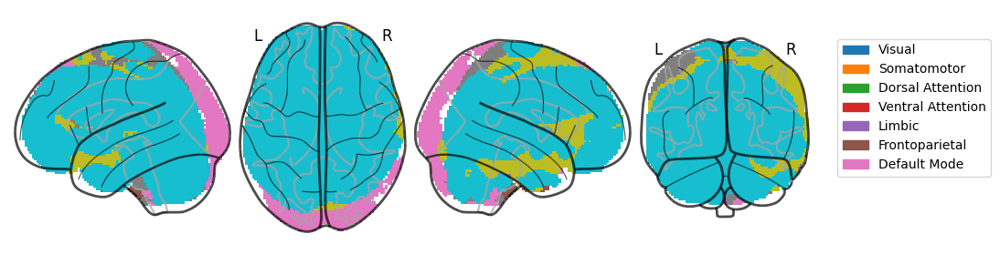

In [175]:
import matplotlib.patches as mpatches

# Create a color list from the same colormap
colors = [network_cmap(i) for i in range(7)]

# Define Yeo 7 network names
yeo_names = [
    "Visual",
    "Somatomotor",
    "Dorsal Attention",
    "Ventral Attention",
    "Limbic",
    "Frontoparietal",
    "Default Mode"
]

# Create custom patches
legend_patches = [mpatches.Patch(color=colors[i], label=yeo_names[i]) for i in range(7)]

# Plot and show the legend
display = plotting.plot_glass_brain(nx.to_nifti(), cmap=network_cmap, display_mode='lzry')
plt.legend(handles=legend_patches, bbox_to_anchor=(1.1, 1.0), loc='upper left')
plt.tight_layout()
plt.show()

Common Pitfall Avoided

In many neuroimaging scripts, mismatches happen when:
	•	The colormap is continuous (plt.cm.viridis) rather than discrete (ListedColormap),
	•	Or color indices don’t match voxel values in the image (e.g., if labels start at 1 but colors are indexed from 0).

I avoided this by explicitly tying color → label → name.

This step was performed to enable labeling of the regions, as the nilearn.plotting.display function does not support direct labeling. Additionally, the color scheme was adjusted to enhance clarity and visualization.

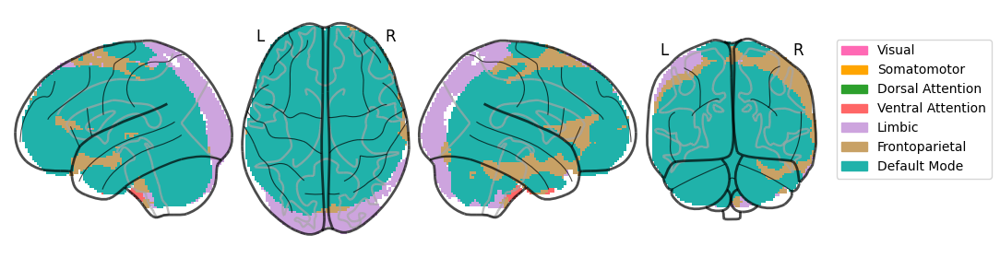

In [176]:
from matplotlib.colors import ListedColormap

# Define exact order of network IDs and colors
network_ids = [1, 2, 3, 4, 5, 6, 7]  # Must match your actual atlas values
network_names = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                 "Limbic", "Frontoparietal", "Default Mode"]

# Manually assign fixed colors (7 distinct colors)
network_colors = [
    "#ff69b4",  # hot pink
    "#ffa500",  # vibrant orange
    "#2ca02c",  # bright light green
    "#ff6666",  # brighter light red
    "#cda4de",  # pastel purple with more color
    "#c8a165",  # warm light brown / caramel
    "#20b2aa"  # deep sky blue
]

# Create a ListedColormap for discrete values
custom_cmap = ListedColormap(network_colors)

# Plot with your new colormap
display = plotting.plot_glass_brain(nx.to_nifti(), cmap=custom_cmap, display_mode='lzry')

# Add a custom legend
import matplotlib.patches as mpatches
legend_patches = [mpatches.Patch(color=network_colors[i], label=network_names[i]) for i in range(len(network_names))]
plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

## Ln

Network_Name  Cont  Default  DorsAttn  Limbic  SalVentAttn  SomMot    Vis
Component                                                                
ICA_1         5405     5496      5733     219         1276    1144  11851
ICA_10        4324    11526      1020    2704         1609    2630   2352
ICA_2         5454     8952      2828    1810         2285    4068    595
ICA_3         2269     5783      3053    1120         1195    2859   4448
ICA_4         2906     5588      3370     496         2136    3429   7495
ICA_5         2634     8547      2703    1716         2520    6456   2216
ICA_6         2080     5896      3411    1872         2258    6807   1917
ICA_7         3117     3973      4230    2062         2581    9858   3162
ICA_8         6078     7486      1281    1397         2854    2186    964
ICA_9         5187     5590      2286     759         2577    4433   5060


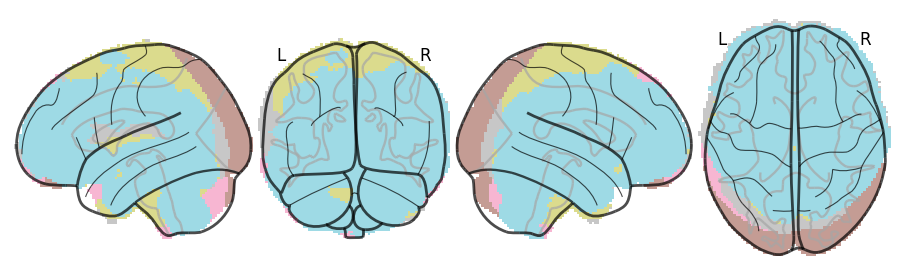

In [177]:
import os
import glob
import numpy as np
import nibabel as nib
import pandas as pd
from nilearn import image, masking, plotting
from nilearn.image import resample_to_img

# Paths
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_Ln_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

# Step 1: Load ICA Components (sorted)
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# Step 2: Load atlas
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# Step 3: Load network labels from the text file (1000 lines)
with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

# Parse network name from label line (format: "7Networks_LH_Vis_1")
network_names = [label.split('_')[2] for label in labels]  # e.g., Vis, SomMot, DorsAttn, SalVentAttn, Limbic, Cont, Default

# Step 4: Map each parcel to a Yeo network (1–7 based on network_names)
unique_networks = sorted(set(network_names), key=network_names.index)  # preserve order
network_id_map = {name: idx+1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names])  # length 1000

# Step 5: Create a 3D map where each voxel's value = Yeo network ID (1–7)
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):  # parcel indices are from 1 to 1000
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

# Step 6: For each ICA component, compute overlap with each network
results = []

for comp_idx, comp_img in enumerate(ica_imgs):
    # Resample to match atlas
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()

    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold
    
    for net_id in range(1, 8):  # networks 1 to 7
        network_voxels = atlas_network_map == net_id
        overlap = np.sum(active_voxels & network_voxels)
        results.append({
            "Component": f"ICA_{comp_idx+1}",
            "Network_ID": net_id,
            "Network_Name": [k for k, v in network_id_map.items() if v == net_id][0],
            "Overlap_Voxels": overlap
        })

# Step 7: Convert to DataFrame for easier analysis
df = pd.DataFrame(results)
df_pivot = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)

# Create an empty 3D image for visualization
visualization_img = np.zeros_like(atlas_data)

for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Instead of assigning net_id, assign a unique color code for each component
    visualization_img[active_voxels] = comp_idx + 1  # +1 to avoid 0

# Convert to NIfTI image
from nilearn.image import new_img_like
vis_img = new_img_like(atlas_img, visualization_img)

# Define a colormap with enough colors
from matplotlib.colors import ListedColormap
colors = plt.cm.tab20(np.linspace(0, 1, len(ica_imgs)))
cmap = ListedColormap(colors)

# Plot the image with multiple distinct colors
plotting.plot_glass_brain(vis_img, cmap=cmap, display_mode='lyrz')

# Print / save results
print(df_pivot)

# Optional: Save to CSV
df_pivot.to_csv("ica_network_overlap_Ln.csv")

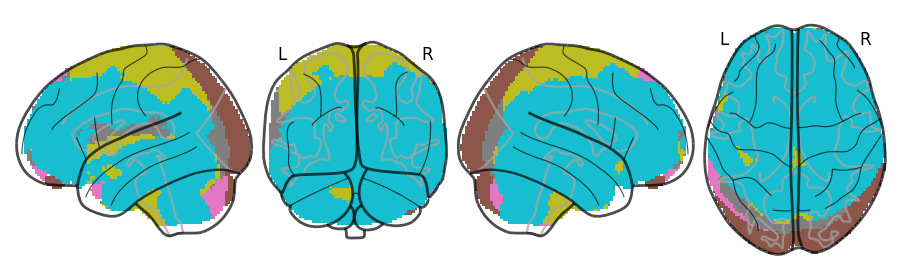

In [178]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from nltools.data import Brain_Data
from nilearn import plotting

# Find which network each ICA component overlaps with most:
top_networks = df.groupby('Component').apply(lambda x: x.loc[x['Overlap_Voxels'].idxmax()])
top_networks = top_networks.reset_index(drop=True)

# Create a labeled 3D array with same shape as the atlas, initialized to 0
network_labels = np.zeros_like(atlas_data)

for i, row in top_networks.iterrows():
    net_id = row['Network_ID']
    component_index = int(row['Component'].split('_')[1]) - 1  # from ICA_1 to index 0
    comp_img = ica_imgs[component_index]
    
    # Resample component to atlas
    resampled = resample_to_img(comp_img, atlas_img)
    comp_data = resampled.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold
    
    # plot ICA components instead
    network_labels[active_voxels] = component_index + 1

# Save or display using Brain_Data
net_nifti = nib.Nifti1Image(network_labels, affine=atlas_img.affine)
nx = Brain_Data(net_nifti)
nx.data = nx.data.astype(float)  # make sure it's float for plotting

# Visualization
figdir = "./figures"
os.makedirs(figdir, exist_ok=True)
output_path = os.path.join(figdir, "networks.pdf")

# Choose a color map (e.g., 'tab10' for 10 distinct colors)
network_cmap = plt.get_cmap('tab10')

plotting.plot_glass_brain(nx.to_nifti(), cmap=network_cmap, display_mode='lyrz', output_file=output_path)
plotting.plot_glass_brain(nx.to_nifti(), cmap=network_cmap, display_mode='lyrz')

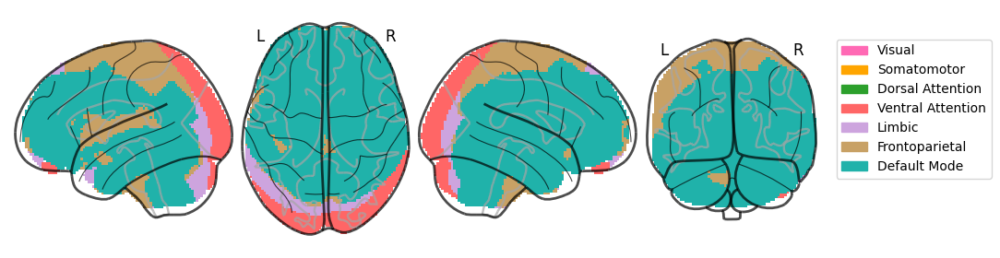

In [179]:
from matplotlib.colors import ListedColormap

# Define exact order of network IDs and colors
network_ids = [1, 2, 3, 4, 5, 6, 7]  # Must match your actual atlas values
network_names = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                 "Limbic", "Frontoparietal", "Default Mode"]

# Manually assign fixed colors (7 distinct colors)
network_colors = [
    "#ff69b4",  # hot pink
    "#ffa500",  # vibrant orange
    "#2ca02c",  # bright light green
    "#ff6666",  # brighter light red
    "#cda4de",  # pastel purple with more color
    "#c8a165",  # warm light brown / caramel
    "#20b2aa"  # deep sky blue
]

# Create a ListedColormap for discrete values
custom_cmap = ListedColormap(network_colors)

# Plot with your new colormap
display = plotting.plot_glass_brain(nx.to_nifti(), cmap=custom_cmap, display_mode='lzry')

# Add a custom legend
import matplotlib.patches as mpatches
legend_patches = [mpatches.Patch(color=network_colors[i], label=network_names[i]) for i in range(len(network_names))]
plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.show()

/Users/onilarasanjala/mambaforge/envs/neuro_project/lib/python3.9/site-packages/numpy/core/fromnumeric.py:758: UserWarning: Warning: 'partition' will ignore the 'mask' of the MaskedArray.
  a.partition(kth, axis=axis, kind=kind, order=order)



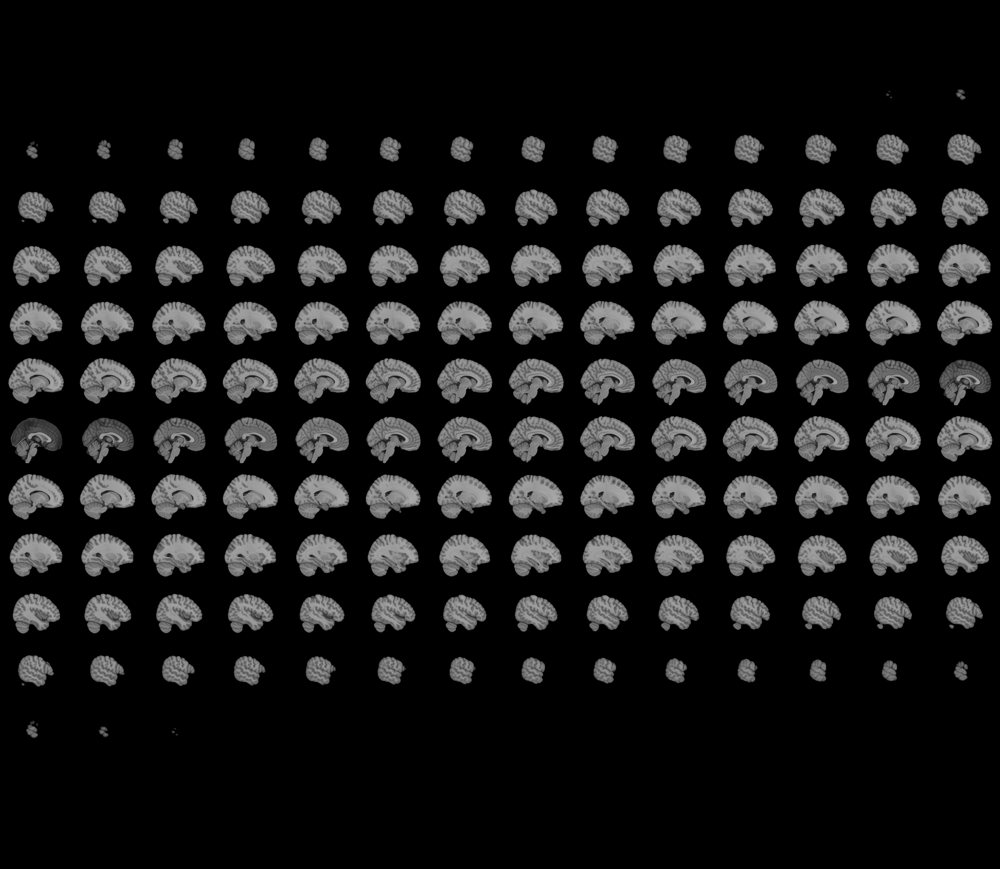
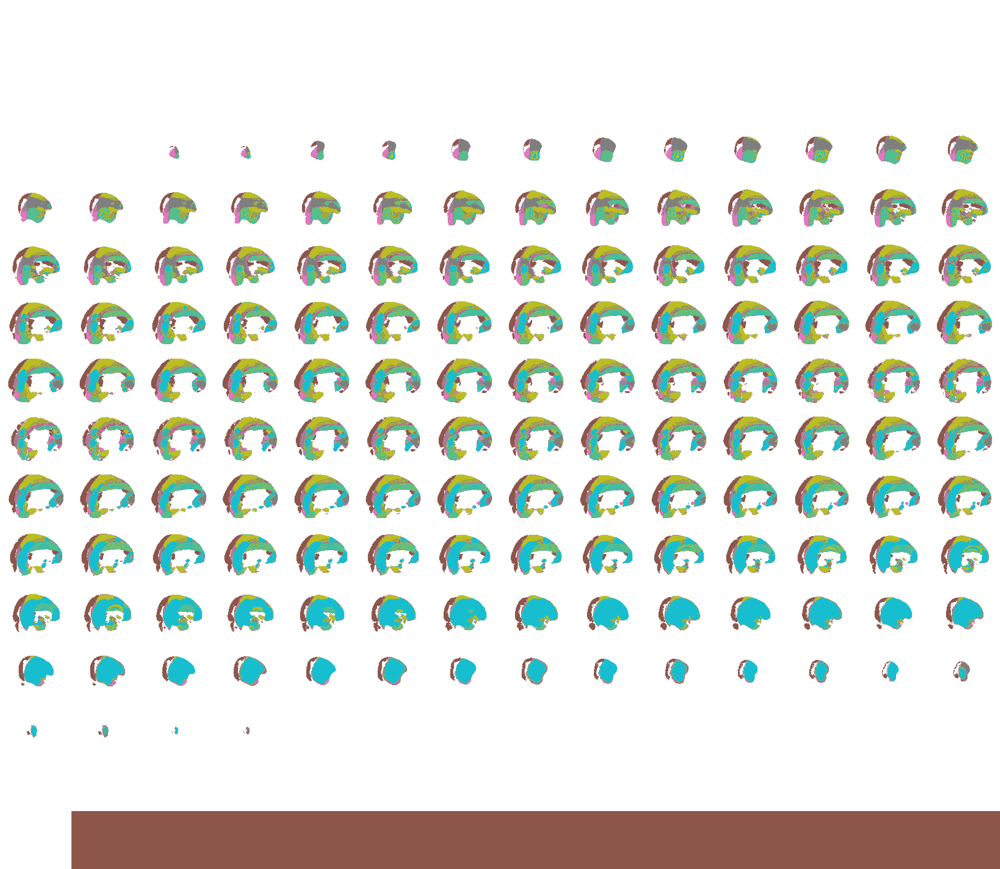

In [180]:
plotting.view_img(nx.to_nifti(), cmap=network_cmap)


Voxel Overlap Table:
Network_Name  Cont  Default  DorsAttn  Limbic  SalVentAttn  SomMot    Vis
Component                                                                
ICA_1         5405     5496      5733     219         1276    1144  11851
ICA_10        4324    11526      1020    2704         1609    2630   2352
ICA_2         5454     8952      2828    1810         2285    4068    595
ICA_3         2269     5783      3053    1120         1195    2859   4448
ICA_4         2906     5588      3370     496         2136    3429   7495
ICA_5         2634     8547      2703    1716         2520    6456   2216
ICA_6         2080     5896      3411    1872         2258    6807   1917
ICA_7         3117     3973      4230    2062         2581    9858   3162
ICA_8         6078     7486      1281    1397         2854    2186    964
ICA_9         5187     5590      2286     759         2577    4433   5060

Top overlapping network for each ICA component:
ICA_1 → Network: Vis (ID: 1)
ICA_10 → Net

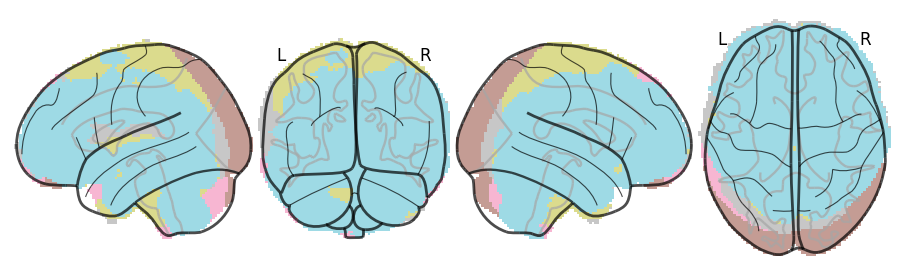

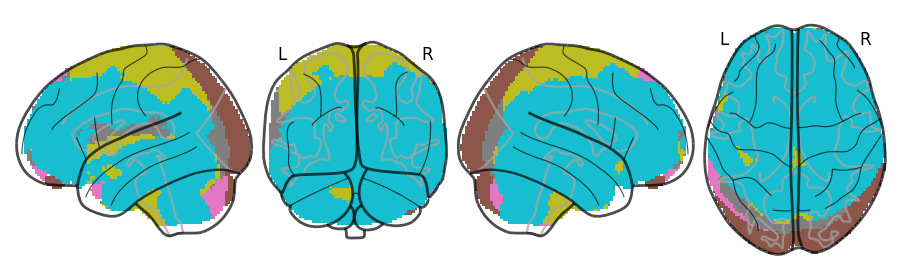

In [126]:
import os
import glob
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from nilearn import image, masking, plotting
from nilearn.image import resample_to_img
from nltools.data import Brain_Data
from matplotlib.colors import ListedColormap

# -------------------------
# Paths
# -------------------------
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_Ln_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

# -------------------------
# Step 1: Load ICA Components
# -------------------------
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# -------------------------
# Step 2: Load atlas
# -------------------------
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# -------------------------
# Step 3: Load labels and parse network names
# -------------------------
with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

network_names = [label.split('_')[2] for label in labels]  # Extract network names
unique_networks = sorted(set(network_names), key=network_names.index)
network_id_map = {name: idx+1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names])  # Length 1000

# -------------------------
# Step 4: Create 3D map with network IDs
# -------------------------
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):  # Parcels are labeled 1 to 1000
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

# -------------------------
# Step 5: Compute overlap of ICA components with networks
# -------------------------
results = []

for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    for net_id in range(1, 8):
        network_voxels = atlas_network_map == net_id
        overlap = np.sum(active_voxels & network_voxels)
        results.append({
            "Component": f"ICA_{comp_idx+1}",
            "Network_ID": net_id,
            "Network_Name": [k for k, v in network_id_map.items() if v == net_id][0],
            "Overlap_Voxels": overlap
        })

# -------------------------
# Step 6: Convert to DataFrame
# -------------------------
df = pd.DataFrame(results)
df_pivot = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)

# Print overlap table
print("\nVoxel Overlap Table:")
print(df_pivot)

# Optional: Save to CSV
df_pivot.to_csv("ica_network_overlap_Ln.csv")

# -------------------------
# Step 7: Glass Brain Plot of Components (colored by component)
# -------------------------
visualization_img = np.zeros_like(atlas_data)

for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold
    visualization_img[active_voxels] = comp_idx + 1

vis_img = image.new_img_like(atlas_img, visualization_img)

colors = plt.cm.tab20(np.linspace(0, 1, len(ica_imgs)))
cmap = ListedColormap(colors)

plotting.plot_glass_brain(vis_img, cmap=cmap, display_mode='lyrz')

# -------------------------
# Step 8: Print top overlapping network per ICA component
# -------------------------
top_networks = df.groupby('Component').apply(lambda x: x.loc[x['Overlap_Voxels'].idxmax()])
top_networks = top_networks.reset_index(drop=True)

print("\nTop overlapping network for each ICA component:")
for _, row in top_networks.iterrows():
    print(f"{row['Component']} → Network: {row['Network_Name']} (ID: {row['Network_ID']})")

# -------------------------
# Step 9: Create labeled image for top networks
# -------------------------
network_labels = np.zeros_like(atlas_data)

for i, row in top_networks.iterrows():
    component_index = int(row['Component'].split('_')[1]) - 1
    comp_img = ica_imgs[component_index]
    resampled = resample_to_img(comp_img, atlas_img)
    comp_data = resampled.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold
    network_labels[active_voxels] = component_index + 1

# Save or display labeled image
net_nifti = nib.Nifti1Image(network_labels, affine=atlas_img.affine)
nx = Brain_Data(net_nifti)
nx.data = nx.data.astype(float)

# Save and show visualization
figdir = "./figures"
os.makedirs(figdir, exist_ok=True)
output_path = os.path.join(figdir, "networks.pdf")

network_cmap = plt.get_cmap('tab10')

plotting.plot_glass_brain(nx.to_nifti(), cmap=network_cmap, display_mode='lyrz', output_file=output_path)
plotting.plot_glass_brain(nx.to_nifti(), cmap=network_cmap, display_mode='lyrz')

Initially, I attempted to label the brain regions using nilearn.plotting.display, but I realized that this function does not support direct labeling. Therefore, I adopted an alternative approach to manually assign labels. The following provides the corresponding label for each color represented on the brain map.

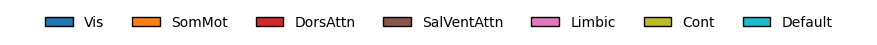

In [107]:
# -------------------------
# Create manual legend
# -------------------------
legend_elements = [Patch(facecolor=colors[i], edgecolor='black', label=unique_networks[i]) 
                   for i in range(len(unique_networks))]

# Show legend in a separate figure
fig_legend = plt.figure(figsize=(9.5, 0.4))
plt.legend(handles=legend_elements, loc='center', ncol=8, fontsize='medium', frameon=False)
plt.axis('off')
plt.tight_layout()
plt.show()

I attempted this approach while developing a processing pipeline, aiming to preserve consistent colors—similar to those displayed here—instead of allowing them to change manually. However, the outcome did not align with my expectations, so I’ve decided to proceed with the original method.

## comparison of what you’re showing — L1 vs Ln

**Key Similarities**

	•	Default Mode Network (blue) is dominant in both L1 and Ln, covering large areas in the medial prefrontal and posterior cingulate     
        cortex regions.
	•	Frontoparietal network (brown) is distributed similarly in lateral prefrontal and parietal regions.
	•	Basic network topographies (e.g. visual at occipital, somatomotor near central sulcus) are preserved in both.

Key Differences

	1.	Ventral Attention (red):
    	•	L1: Very minimal presence.
    	•	Ln: More prominent, especially in lateral regions and ventral frontal cortex.
    	•	→ Interpretation: Ln may have a stronger attentional modulation or more dynamic task-engagement pattern.

	2.	Limbic network (purple):
    	•	Slightly broader in L1, but present in both.
            
	3.	Default Mode coverage:
    	•	L1: Slightly more widespread, especially along midline.
    	•	Ln: Still strong, but possibly more confined to core hubs.

	4.	Somatomotor & Dorsal Attention:
    	•	Minor shifts in coverage or border regions, but no stark reassignments.

Possible Interpretations
	
    •	L1 may represent more global or canonical network structure, while Ln may reflect higher-order or task-specific reconfigurations (e.g., stronger engagement of attention systems).
	
    •	Changes in ventral attention and default mode spread might indicate a functional shift from baseline to task-focused state or individual variation across iterations/layers.

# Module B

## Single ICA Vizualization

### L1

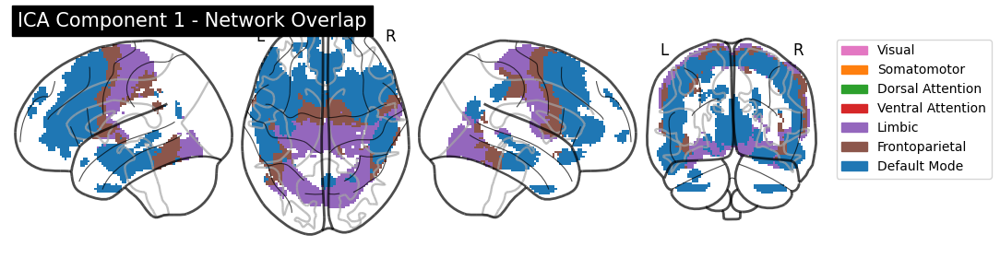

Saved: ./separate_ica_figures_L1/ICA_Component_1_colored.png


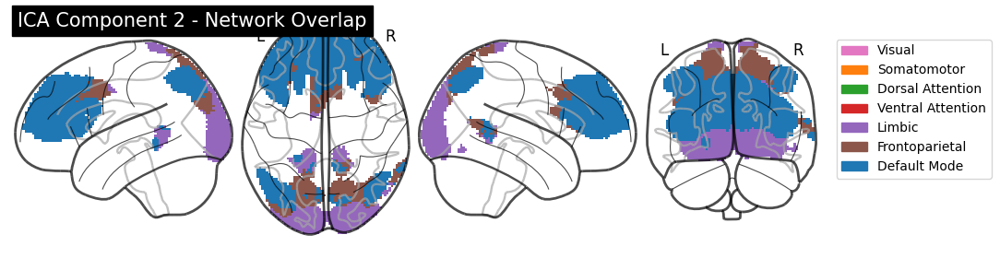

Saved: ./separate_ica_figures_L1/ICA_Component_2_colored.png


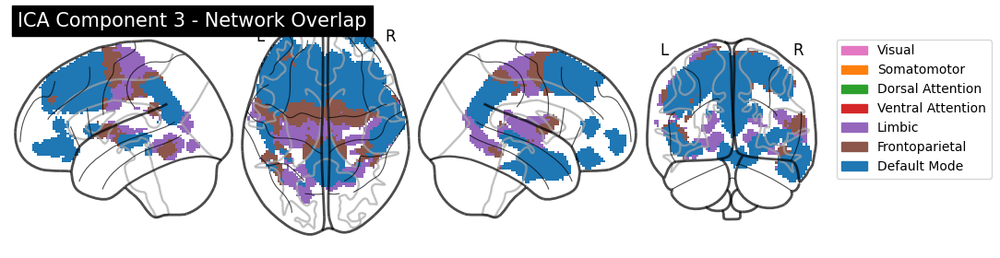

Saved: ./separate_ica_figures_L1/ICA_Component_3_colored.png


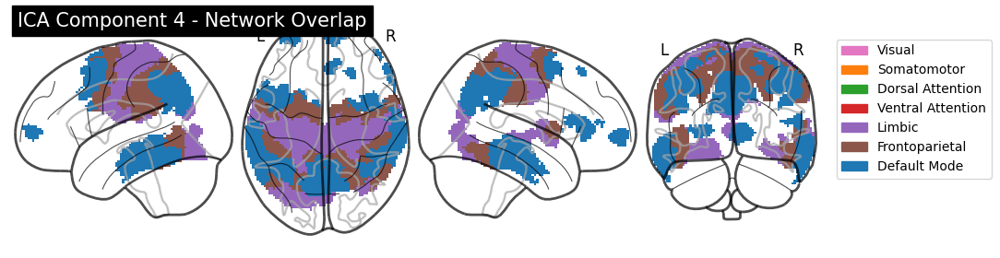

Saved: ./separate_ica_figures_L1/ICA_Component_4_colored.png


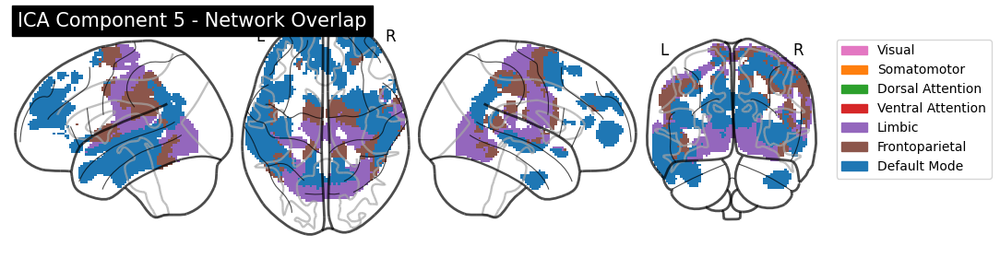

Saved: ./separate_ica_figures_L1/ICA_Component_5_colored.png


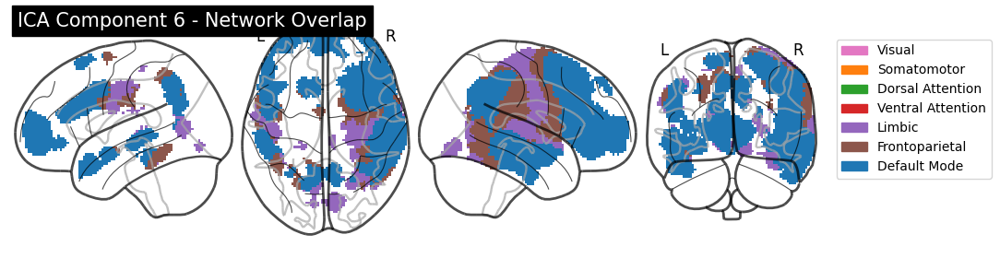

Saved: ./separate_ica_figures_L1/ICA_Component_6_colored.png


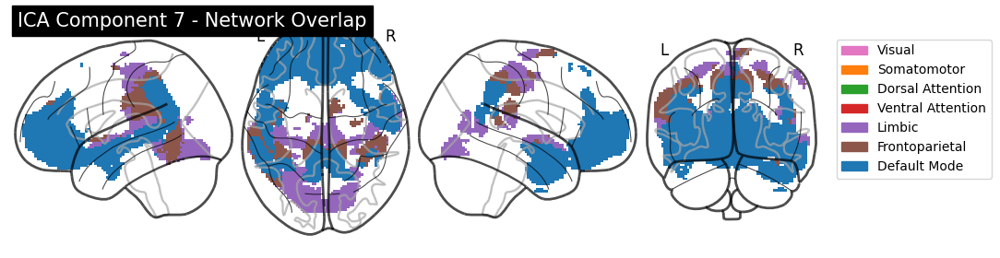

Saved: ./separate_ica_figures_L1/ICA_Component_7_colored.png


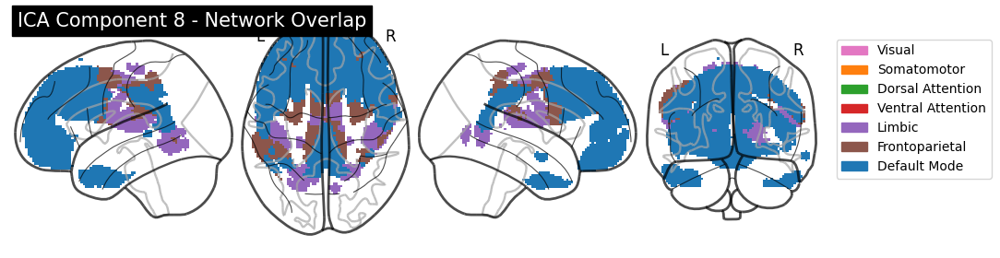

Saved: ./separate_ica_figures_L1/ICA_Component_8_colored.png


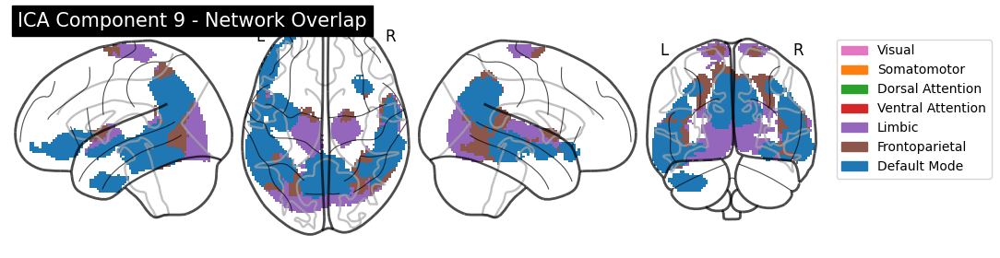

Saved: ./separate_ica_figures_L1/ICA_Component_9_colored.png


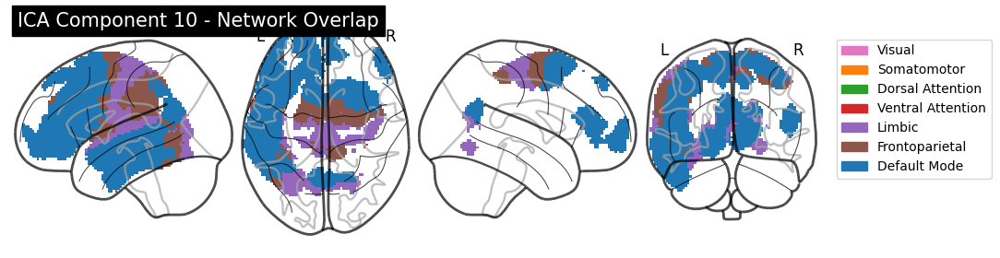

Saved: ./separate_ica_figures_L1/ICA_Component_10_colored.png


In [127]:
import os
import glob
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from nilearn import image, masking, plotting
from nilearn.image import resample_to_img
from matplotlib.colors import ListedColormap
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# Paths
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_L1_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

# Output directory for individual ICA figures
figdir = "./separate_ica_figures_L1"
os.makedirs(figdir, exist_ok=True)

# Load ICA components
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# Load atlas and labels
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# Load and parse network labels
with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

network_names = [label.split('_')[2] for label in labels]
unique_networks = sorted(set(network_names), key=network_names.index)
network_id_map = {name: idx + 1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names])

atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

results = []

for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold
    
    for net_id in range(1, 8):
        network_voxels = atlas_network_map == net_id
        overlap = np.sum(active_voxels & network_voxels)
        results.append({
            "Component": f"ICA_{comp_idx + 1}",
            "Network_ID": net_id,
            "Network_Name": [k for k, v in network_id_map.items() if v == net_id][0],
            "Overlap_Voxels": overlap
        })

df = pd.DataFrame(results)
df_pivot = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)
df_pivot.to_csv("ica_network_overlap_L1(Individual).csv")

# Define exact order of network IDs and colors
network_ids = [1, 2, 3, 4, 5, 6, 7]
network_names = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                 "Limbic", "Frontoparietal", "Default Mode"]
network_colors = [
    "#e377c2",  # pink
    "#ff7f0e",  # orange
    "#2ca02c",  # green
    "#d62728",  # red
    "#9467bd",  # purple
    "#8c564b",  # brown
    "#1f77b4"   # blue
]
custom_cmap = ListedColormap(network_colors)

# Plotting each ICA component's overlap with networks
for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Build labeled network mask (0 = background, others = network ID)
    labeled_map = np.zeros_like(comp_data)
    for net_id in network_ids:
        net_mask = (atlas_network_map == net_id)
        labeled_map[active_voxels & net_mask] = net_id

    labeled_img = nib.Nifti1Image(labeled_map, affine=atlas_img.affine)

    # Display & Save
    display = plotting.plot_glass_brain(
        labeled_img, cmap=custom_cmap, display_mode='lzry', colorbar=False,
        title=f"ICA Component {comp_idx + 1} - Network Overlap"
    )

    # Add custom legend
    legend_patches = [mpatches.Patch(color=network_colors[i], label=network_names[i]) for i in range(len(network_ids))]
    plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Save to file
    output_path = os.path.join(figdir, f"ICA_Component_{comp_idx + 1}_colored.png")
    plt.savefig(output_path, bbox_inches='tight', dpi=150)
    plt.show()
    print(f"Saved: {output_path}")

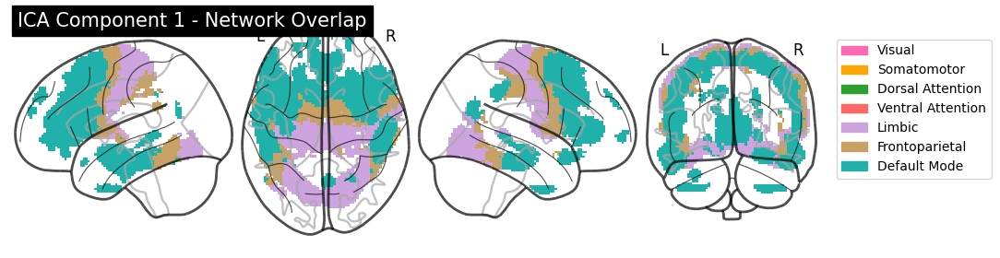

Saved: ./separate_ica_figures_L1/ICA_Component_1_colored.png


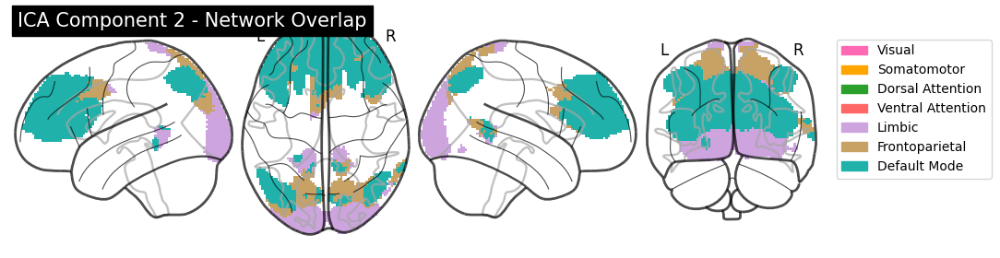

Saved: ./separate_ica_figures_L1/ICA_Component_2_colored.png


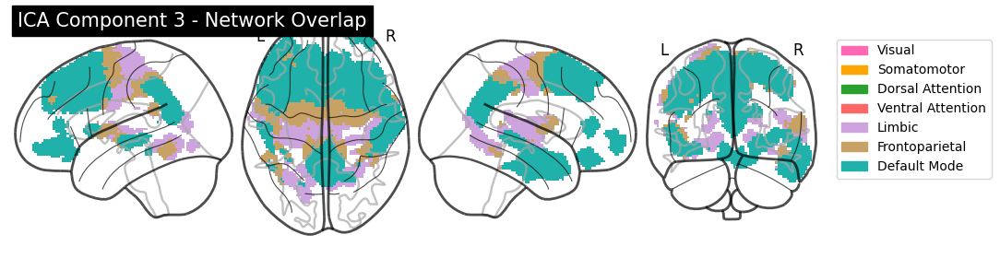

Saved: ./separate_ica_figures_L1/ICA_Component_3_colored.png


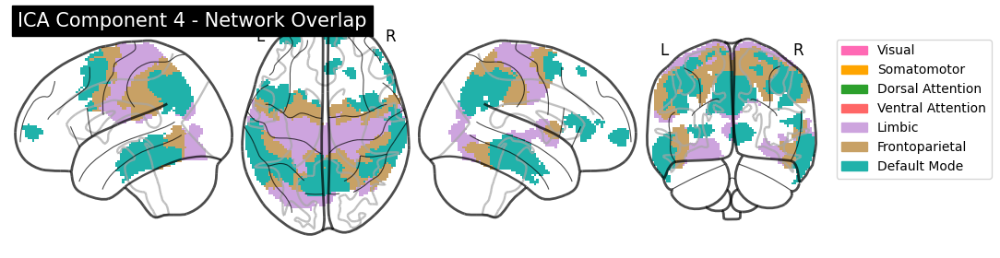

Saved: ./separate_ica_figures_L1/ICA_Component_4_colored.png


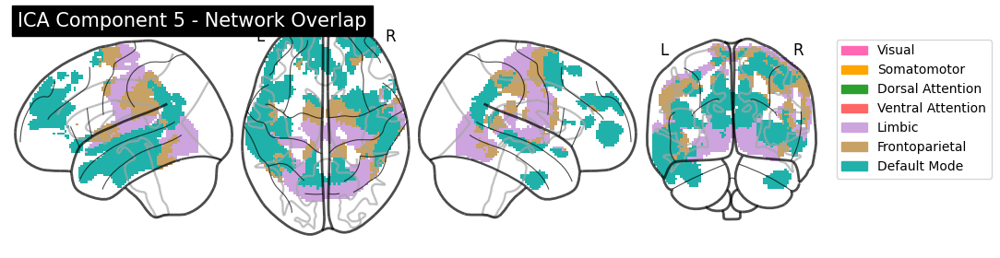

Saved: ./separate_ica_figures_L1/ICA_Component_5_colored.png


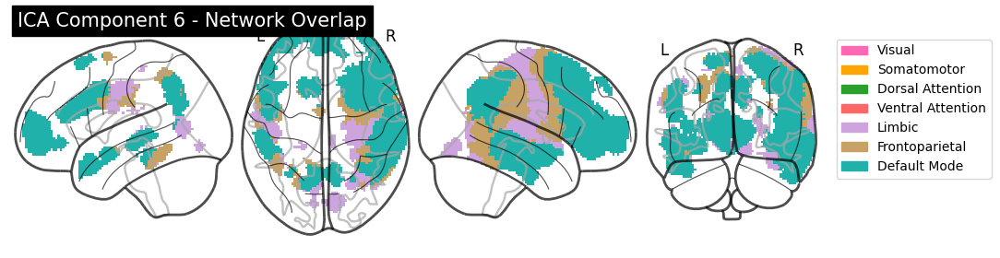

Saved: ./separate_ica_figures_L1/ICA_Component_6_colored.png


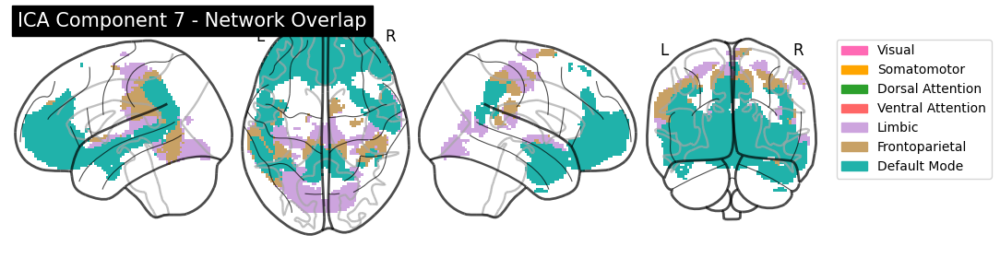

Saved: ./separate_ica_figures_L1/ICA_Component_7_colored.png


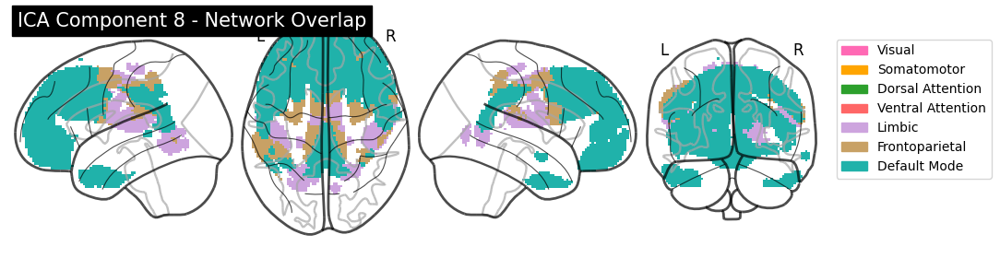

Saved: ./separate_ica_figures_L1/ICA_Component_8_colored.png


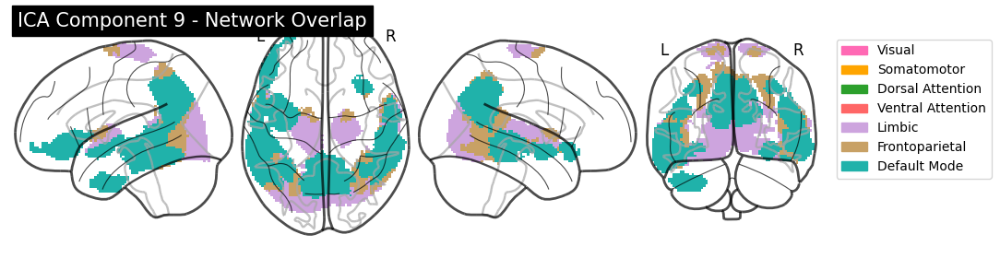

Saved: ./separate_ica_figures_L1/ICA_Component_9_colored.png


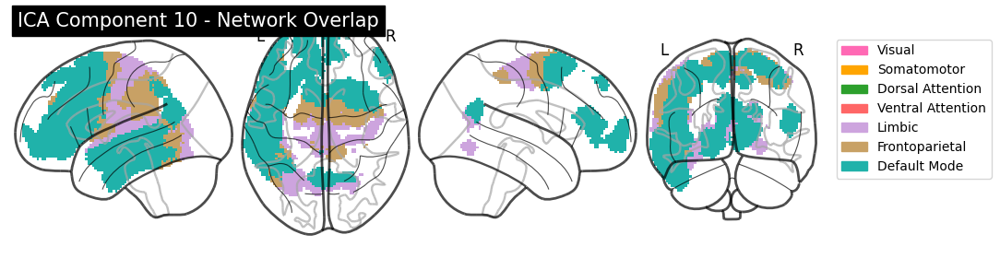

Saved: ./separate_ica_figures_L1/ICA_Component_10_colored.png


In [157]:
import os
import glob
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from nilearn import image, plotting
from nilearn.image import resample_to_img
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# Paths
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_L1_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

# Output directory for individual ICA figures
figdir = "./separate_ica_figures_L1"
os.makedirs(figdir, exist_ok=True)

# Load ICA components
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# Load atlas and labels
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# Load and parse network labels
with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

network_names_all = [label.split('_')[2] for label in labels]
unique_networks = sorted(set(network_names_all), key=network_names_all.index)
network_id_map = {name: idx + 1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names_all])

# Build atlas map where each voxel is labeled with its network ID
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

# Precompute voxel count per network
network_voxel_counts = {}
for net_id in range(1, 8):
    network_voxel_counts[net_id] = np.sum(atlas_network_map == net_id)

# Results list
results = []

# Analyze each ICA component
for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    for net_id in range(1, 8):
        network_voxels = atlas_network_map == net_id
        shared_voxels = np.sum(active_voxels & network_voxels)
        percent_overlap = (shared_voxels / network_voxel_counts[net_id]) * 100 if network_voxel_counts[net_id] > 0 else 0

        results.append({
            "Component": f"ICA_{comp_idx + 1}",
            "Network_ID": net_id,
            "Network_Name": [k for k, v in network_id_map.items() if v == net_id][0],
            "Overlap_Voxels": shared_voxels,
            "Percent_Overlap": percent_overlap
        })

# Save CSVs
df = pd.DataFrame(results)

# Save voxel counts
df_voxels = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)
df_voxels.to_csv("ica_network_overlap_L1_voxels.csv")

# Save percent overlaps
df_percent = df.pivot(index="Component", columns="Network_Name", values="Percent_Overlap").fillna(0)
df_percent.to_csv("ica_network_overlap_L1_percentage.csv")

# Define color map and labels
network_ids = [1, 2, 3, 4, 5, 6, 7]
network_names = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                 "Limbic", "Frontoparietal", "Default Mode"]
network_colors = [
    "#ff69b4",  # hot pink
    "#ffa500",  # vibrant orange
    "#2ca02c",  # bright light green
    "#ff6666",  # brighter light red
    "#cda4de",  # pastel purple with more color
    "#c8a165",  # warm light brown / caramel
    "#20b2aa"  # deep sky blue
]
custom_cmap = ListedColormap(network_colors)

# Plotting each ICA component's overlap
for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Labeled map: 0 = background, others = network ID
    labeled_map = np.zeros_like(comp_data)
    for net_id in network_ids:
        net_mask = (atlas_network_map == net_id)
        labeled_map[active_voxels & net_mask] = net_id

    labeled_img = nib.Nifti1Image(labeled_map, affine=atlas_img.affine)

    # Display & Save
    display = plotting.plot_glass_brain(
        labeled_img, cmap=custom_cmap, display_mode='lzry', colorbar=False,
        title=f"ICA Component {comp_idx + 1} - Network Overlap"
    )

    legend_patches = [mpatches.Patch(color=network_colors[i], label=network_names[i]) for i in range(len(network_ids))]
    plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')
    
    output_path = os.path.join(figdir, f"ICA_Component_{comp_idx + 1}_colored.png")
    plt.savefig(output_path, bbox_inches='tight', dpi=150)
    plt.show()
    print(f"Saved: {output_path}")

making it in order. 

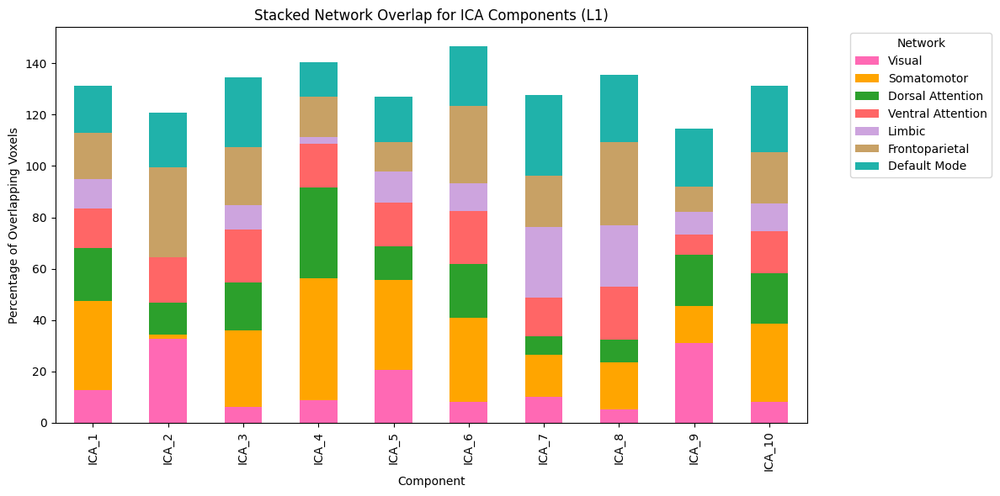

In [181]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import ListedColormap

# Load your data
csv_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ica_network_overlap_L1_percentage.csv"
df = pd.read_csv(csv_path)

# Set desired order for ICA components (ICA_1 to ICA_10)
df['Component'] = pd.Categorical(df['Component'],
    categories=sorted(df['Component'], key=lambda x: int(x.split('_')[1])),
    ordered=True)

# Define network order and labels
network_order_short = ['Vis', 'SomMot', 'DorsAttn', 'SalVentAttn', 'Limbic', 'Cont', 'Default']
network_order_full = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                      "Limbic", "Frontoparietal", "Default Mode"]

# Define color map
network_colors = [
    "#ff69b4",  # Visual - hot pink
    "#ffa500",  # Somatomotor - orange
    "#2ca02c",  # Dorsal Attention - green
    "#ff6666",  # Ventral Attention - light red
    "#cda4de",  # Limbic - pastel purple
    "#c8a165",  # Frontoparietal - caramel
    "#20b2aa"   # Default Mode - deep sky blue
]
custom_cmap = ListedColormap(network_colors)

# Network label mapping
network_name_map = {
    'Vis': 'Visual',
    'SomMot': 'Somatomotor',
    'DorsAttn': 'Dorsal Attention',
    'SalVentAttn': 'Ventral Attention',
    'Limbic': 'Limbic',
    'Cont': 'Frontoparietal',
    'Default': 'Default Mode'
}

# --- Stacked Bar Plot ---
df_sorted = df.sort_values('Component')
df_plot = df_sorted.set_index('Component')[network_order_short]
df_plot.columns = [network_name_map[col] for col in df_plot.columns]

df_plot.plot(kind='bar', stacked=True, figsize=(12, 6), color=network_colors)
plt.ylabel("Percentage of Overlapping Voxels")
plt.title("Stacked Network Overlap for ICA Components (L1)")
plt.legend(title='Network', bbox_to_anchor=(1.05, 1))
plt.tight_layout()
plt.show()

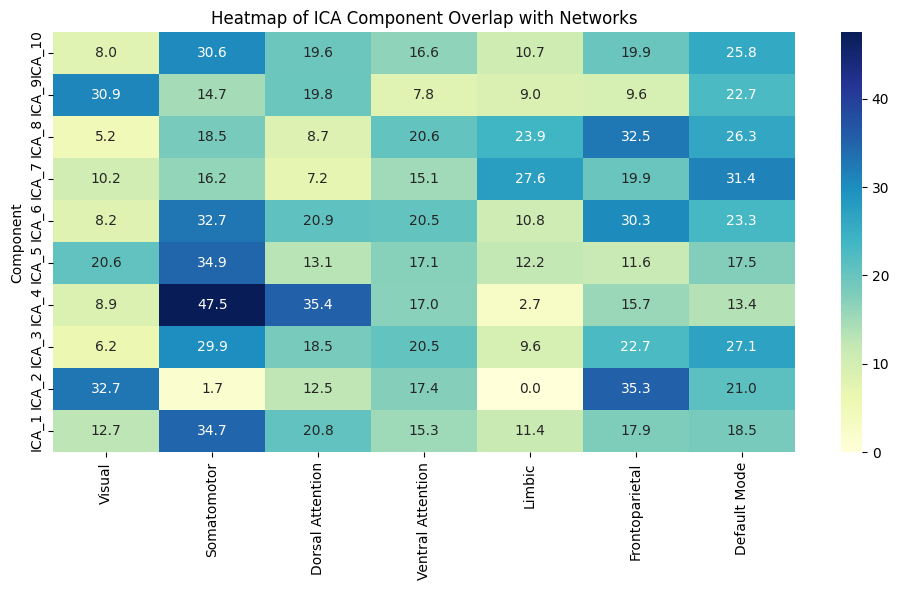

In [182]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load your data
csv_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ica_network_overlap_L1_percentage.csv"
df = pd.read_csv(csv_path)

# Set desired order for components (ICA_1 to ICA_10)
df['Component'] = pd.Categorical(df['Component'],
    categories=sorted(df['Component'], key=lambda x: int(x.split('_')[1])),
    ordered=True)

# Set the desired network order
network_order_short = ['Vis', 'SomMot', 'DorsAttn', 'SalVentAttn', 'Limbic', 'Cont', 'Default']
network_order_full = ['Visual', 'Somatomotor', 'Dorsal Attention', 'Ventral Attention', 'Limbic', 'Frontoparietal', 'Default Mode']

# Mapping short to full network names
network_name_map = {
    'Vis': 'Visual',
    'SomMot': 'Somatomotor',
    'DorsAttn': 'Dorsal Attention',
    'SalVentAttn': 'Ventral Attention',
    'Limbic': 'Limbic',
    'Cont': 'Frontoparietal',
    'Default': 'Default Mode'
}
# --- Heatmap ---
plt.figure(figsize=(10, 6))
heatmap_data = df.set_index('Component').loc[:, network_order_short]
heatmap_data.columns = [network_name_map[col] for col in heatmap_data.columns]

# Ensure correct order ICA_1 to ICA_10 top to bottom
heatmap_data = heatmap_data.loc[sorted(heatmap_data.index, key=lambda x: int(x.split('_')[1]))]
heatmap_data = heatmap_data.iloc[::-1]  # Flip vertically to put ICA_1 at top

sns.heatmap(heatmap_data, cmap="YlGnBu", annot=True, fmt=".1f")
plt.title("Heatmap of ICA Component Overlap with Networks")
plt.tight_layout()
plt.show()

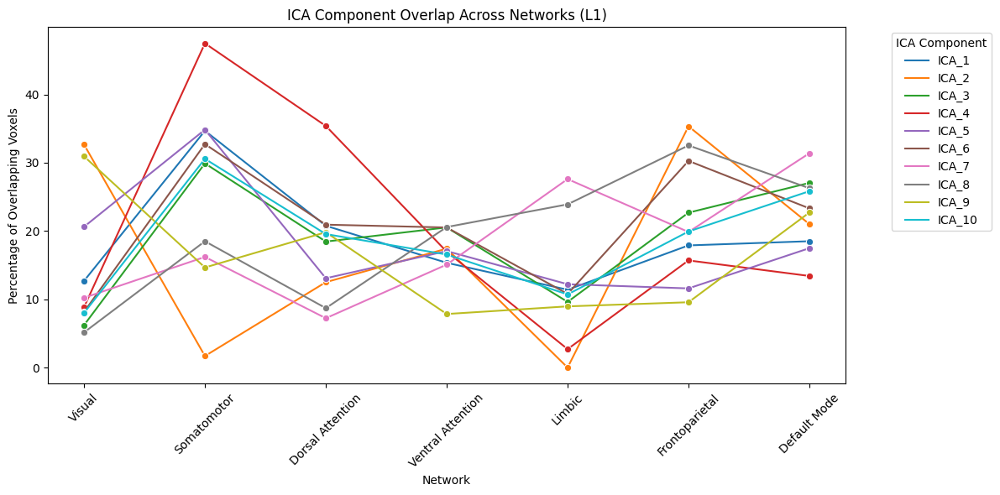

In [183]:
# --- Line Plot ---
df_long = pd.melt(df, id_vars='Component', value_vars=network_order_short,
                  var_name='Network', value_name='Overlap')
df_long['Network'] = df_long['Network'].map(network_name_map)
df_long['Network'] = pd.Categorical(df_long['Network'], categories=network_order_full, ordered=True)

plt.figure(figsize=(12, 6))
sns.lineplot(data=df_long, x='Network', y='Overlap', hue='Component', marker='o')
plt.title("ICA Component Overlap Across Networks (L1)")
plt.ylabel("Percentage of Overlapping Voxels")
plt.xticks(rotation=45)
plt.legend(title='ICA Component', bbox_to_anchor=(1.05, 1))
plt.tight_layout()
plt.show()

Now for Ln.

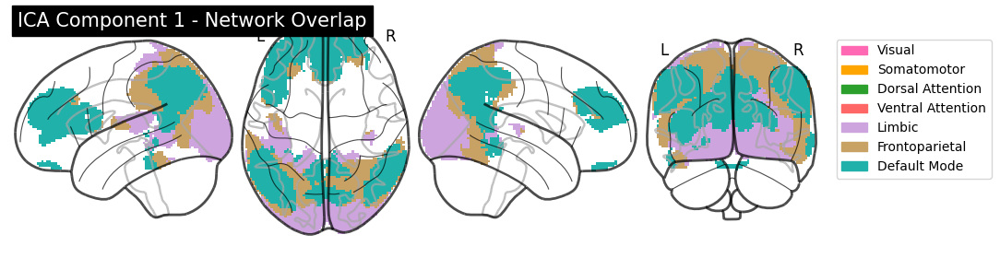

Saved: ./separate_ica_figures_L1/ICA_Component_1_colored.png


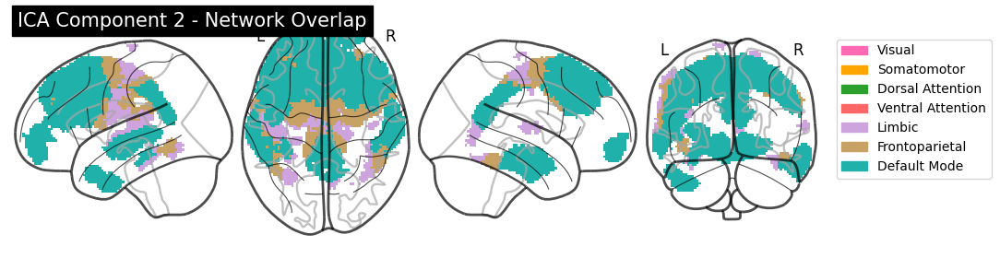

Saved: ./separate_ica_figures_L1/ICA_Component_2_colored.png


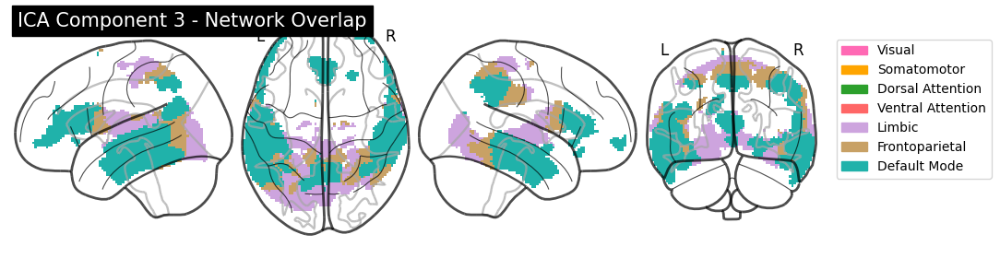

Saved: ./separate_ica_figures_L1/ICA_Component_3_colored.png


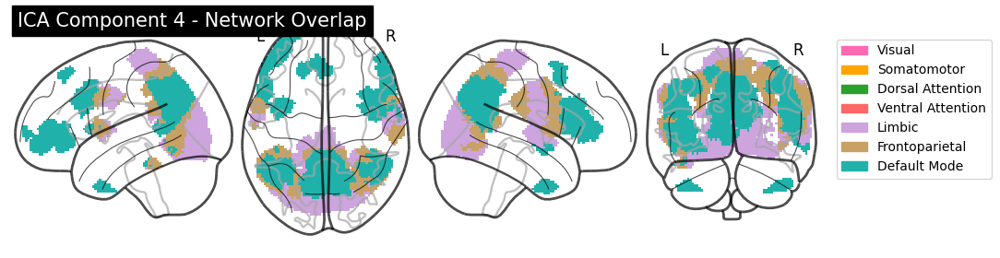

Saved: ./separate_ica_figures_L1/ICA_Component_4_colored.png


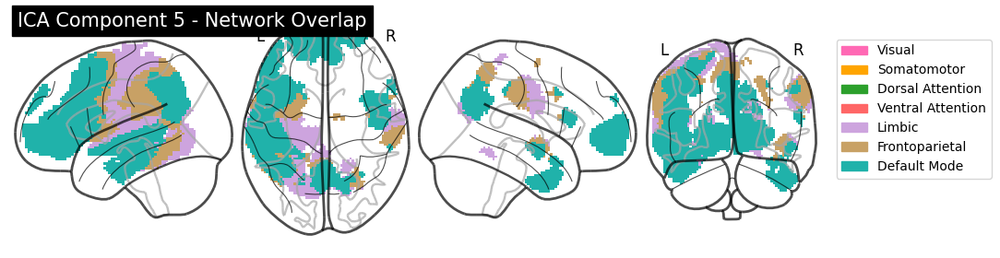

Saved: ./separate_ica_figures_L1/ICA_Component_5_colored.png


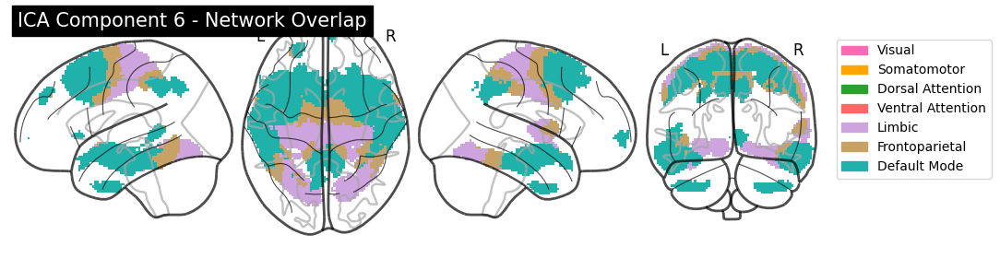

Saved: ./separate_ica_figures_L1/ICA_Component_6_colored.png


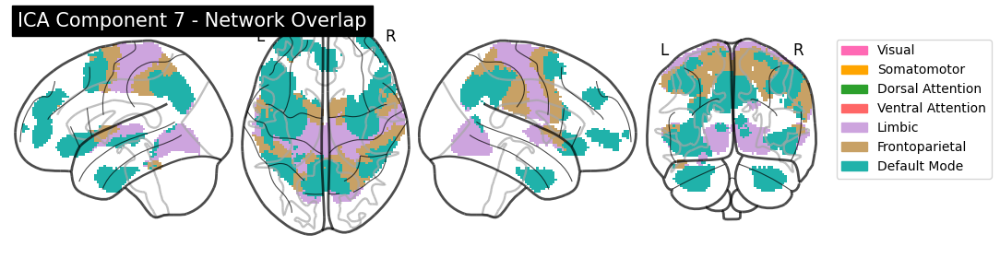

Saved: ./separate_ica_figures_L1/ICA_Component_7_colored.png


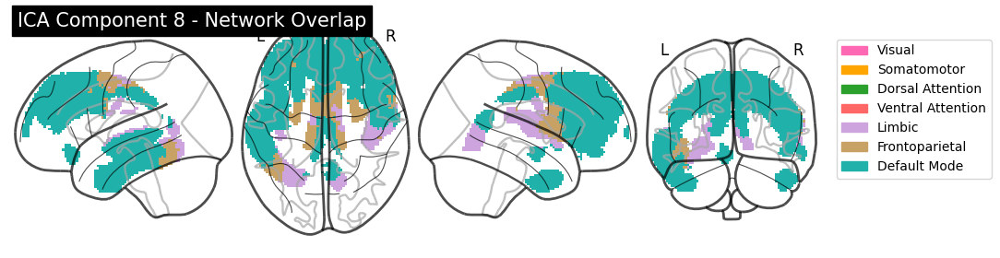

Saved: ./separate_ica_figures_L1/ICA_Component_8_colored.png


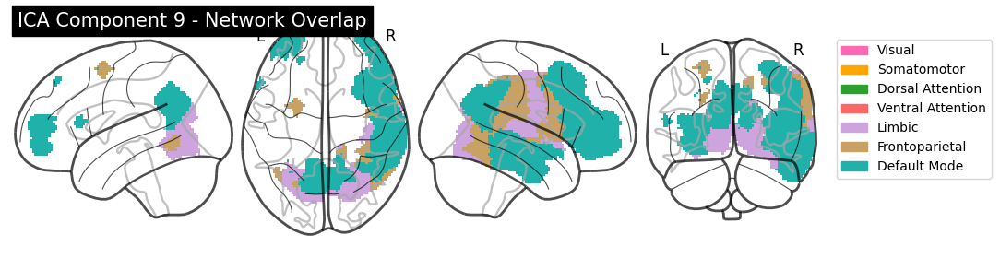

Saved: ./separate_ica_figures_L1/ICA_Component_9_colored.png


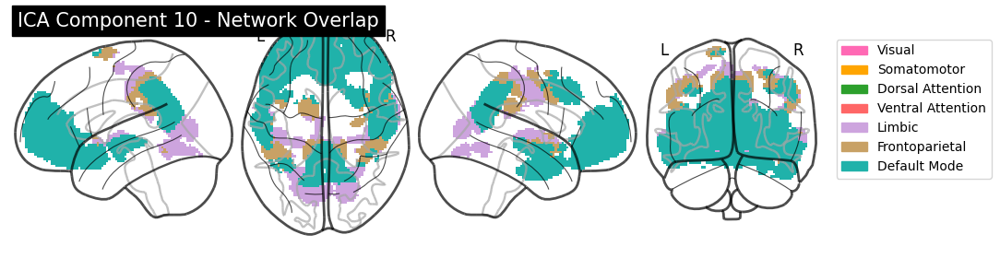

Saved: ./separate_ica_figures_L1/ICA_Component_10_colored.png


In [162]:
import os
import glob
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from nilearn import image, plotting
from nilearn.image import resample_to_img
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# Paths
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_Ln_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

# Output directory for individual ICA figures
figdir = "./separate_ica_figures_L1"
os.makedirs(figdir, exist_ok=True)

# Load ICA components
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# Load atlas and labels
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# Load and parse network labels
with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

network_names_all = [label.split('_')[2] for label in labels]
unique_networks = sorted(set(network_names_all), key=network_names_all.index)
network_id_map = {name: idx + 1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names_all])

# Build atlas map where each voxel is labeled with its network ID
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

# Precompute voxel count per network
network_voxel_counts = {}
for net_id in range(1, 8):
    network_voxel_counts[net_id] = np.sum(atlas_network_map == net_id)

# Results list
results = []

# Analyze each ICA component
for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    for net_id in range(1, 8):
        network_voxels = atlas_network_map == net_id
        shared_voxels = np.sum(active_voxels & network_voxels)
        percent_overlap = (shared_voxels / network_voxel_counts[net_id]) * 100 if network_voxel_counts[net_id] > 0 else 0

        results.append({
            "Component": f"ICA_{comp_idx + 1}",
            "Network_ID": net_id,
            "Network_Name": [k for k, v in network_id_map.items() if v == net_id][0],
            "Overlap_Voxels": shared_voxels,
            "Percent_Overlap": percent_overlap
        })

# Save CSVs
df = pd.DataFrame(results)

# Save voxel counts
df_voxels = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)
df_voxels.to_csv("ica_network_overlap_Ln_voxels.csv")

# Save percent overlaps
df_percent = df.pivot(index="Component", columns="Network_Name", values="Percent_Overlap").fillna(0)
df_percent.to_csv("ica_network_overlap_Ln_percentage.csv")

# Define color map and labels
network_ids = [1, 2, 3, 4, 5, 6, 7]
network_names = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                 "Limbic", "Frontoparietal", "Default Mode"]
network_colors = [
    "#ff69b4",  # hot pink
    "#ffa500",  # vibrant orange
    "#2ca02c",  # bright light green
    "#ff6666",  # brighter light red
    "#cda4de",  # pastel purple with more color
    "#c8a165",  # warm light brown / caramel
    "#20b2aa"  # deep sky blue
]
custom_cmap = ListedColormap(network_colors)

# Plotting each ICA component's overlap
for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Labeled map: 0 = background, others = network ID
    labeled_map = np.zeros_like(comp_data)
    for net_id in network_ids:
        net_mask = (atlas_network_map == net_id)
        labeled_map[active_voxels & net_mask] = net_id

    labeled_img = nib.Nifti1Image(labeled_map, affine=atlas_img.affine)

    # Display & Save
    display = plotting.plot_glass_brain(
        labeled_img, cmap=custom_cmap, display_mode='lzry', colorbar=False,
        title=f"ICA Component {comp_idx + 1} - Network Overlap"
    )

    legend_patches = [mpatches.Patch(color=network_colors[i], label=network_names[i]) for i in range(len(network_ids))]
    plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')
    
    output_path = os.path.join(figdir, f"ICA_Component_{comp_idx + 1}_colored.png")
    plt.savefig(output_path, bbox_inches='tight', dpi=150)
    plt.show()
    print(f"Saved: {output_path}")

Draw in the grapghs

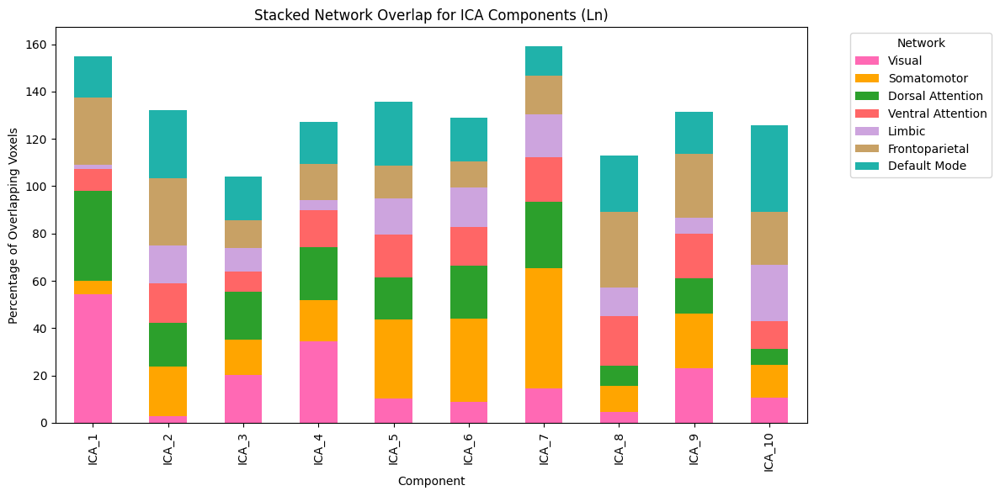

In [188]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from matplotlib.colors import ListedColormap

# Load your data
csv_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ica_network_overlap_Ln_percentage.csv"
df = pd.read_csv(csv_path)

# Set desired order for ICA components (ICA_1 to ICA_10)
df['Component'] = pd.Categorical(df['Component'],
    categories=sorted(df['Component'], key=lambda x: int(x.split('_')[1])),
    ordered=True)

# Define network order and labels
network_order_short = ['Vis', 'SomMot', 'DorsAttn', 'SalVentAttn', 'Limbic', 'Cont', 'Default']
network_order_full = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                      "Limbic", "Frontoparietal", "Default Mode"]

# Define color map
network_colors = [
    "#ff69b4",  # Visual - hot pink
    "#ffa500",  # Somatomotor - orange
    "#2ca02c",  # Dorsal Attention - green
    "#ff6666",  # Ventral Attention - light red
    "#cda4de",  # Limbic - pastel purple
    "#c8a165",  # Frontoparietal - caramel
    "#20b2aa"   # Default Mode - deep sky blue
]
custom_cmap = ListedColormap(network_colors)

# Network label mapping
network_name_map = {
    'Vis': 'Visual',
    'SomMot': 'Somatomotor',
    'DorsAttn': 'Dorsal Attention',
    'SalVentAttn': 'Ventral Attention',
    'Limbic': 'Limbic',
    'Cont': 'Frontoparietal',
    'Default': 'Default Mode'
}

# --- Stacked Bar Plot ---
df_sorted = df.sort_values('Component')
df_plot = df_sorted.set_index('Component')[network_order_short]
df_plot.columns = [network_name_map[col] for col in df_plot.columns]

df_plot.plot(kind='bar', stacked=True, figsize=(12, 6), color=network_colors)
plt.ylabel("Percentage of Overlapping Voxels")
plt.title("Stacked Network Overlap for ICA Components (Ln)")
plt.legend(title='Network', bbox_to_anchor=(1.05, 1))
plt.tight_layout()
plt.show()

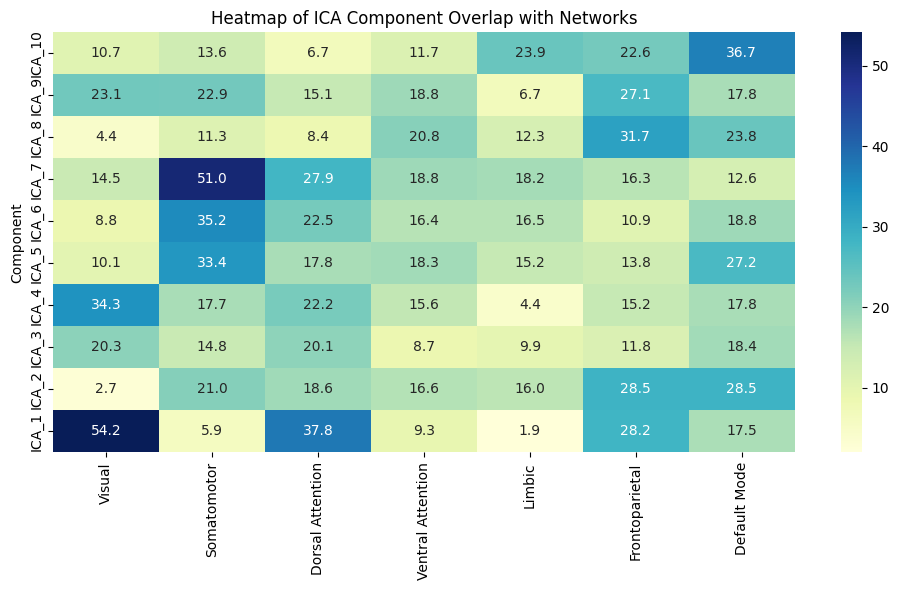

In [189]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load your data
csv_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ica_network_overlap_Ln_percentage.csv"
df = pd.read_csv(csv_path)

# Set desired order for components (ICA_1 to ICA_10)
df['Component'] = pd.Categorical(df['Component'],
    categories=sorted(df['Component'], key=lambda x: int(x.split('_')[1])),
    ordered=True)

# Set the desired network order
network_order_short = ['Vis', 'SomMot', 'DorsAttn', 'SalVentAttn', 'Limbic', 'Cont', 'Default']
network_order_full = ['Visual', 'Somatomotor', 'Dorsal Attention', 'Ventral Attention', 'Limbic', 'Frontoparietal', 'Default Mode']

# Mapping short to full network names
network_name_map = {
    'Vis': 'Visual',
    'SomMot': 'Somatomotor',
    'DorsAttn': 'Dorsal Attention',
    'SalVentAttn': 'Ventral Attention',
    'Limbic': 'Limbic',
    'Cont': 'Frontoparietal',
    'Default': 'Default Mode'
}
# --- Heatmap ---
plt.figure(figsize=(10, 6))
heatmap_data = df.set_index('Component').loc[:, network_order_short]
heatmap_data.columns = [network_name_map[col] for col in heatmap_data.columns]

# Ensure correct order ICA_1 to ICA_10 top to bottom
heatmap_data = heatmap_data.loc[sorted(heatmap_data.index, key=lambda x: int(x.split('_')[1]))]
heatmap_data = heatmap_data.iloc[::-1]  # Flip vertically to put ICA_1 at top

sns.heatmap(heatmap_data, cmap="YlGnBu", annot=True, fmt=".1f")
plt.title("Heatmap of ICA Component Overlap with Networks")
plt.tight_layout()
plt.show()

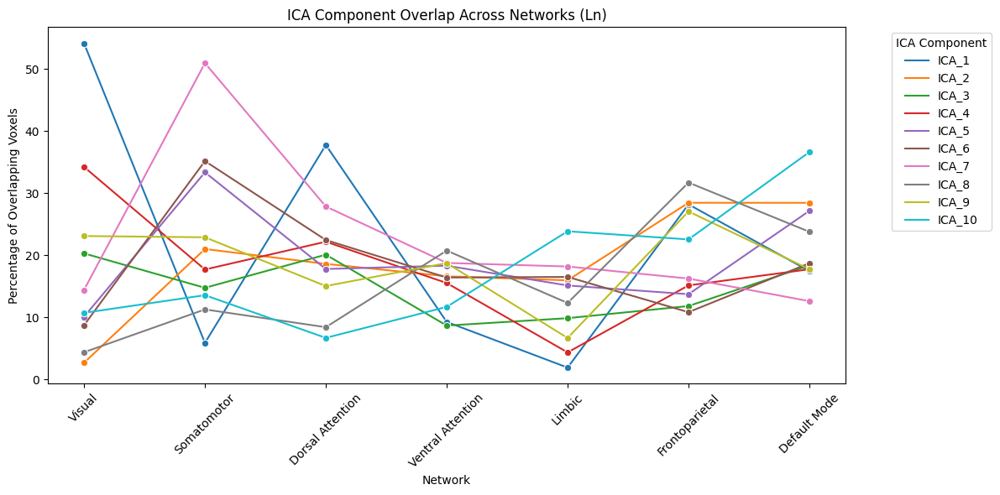

In [190]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load your data
csv_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ica_network_overlap_Ln_percentage.csv"
df = pd.read_csv(csv_path)

# Set the desired network orders
network_order_short = ['Vis', 'SomMot', 'DorsAttn', 'SalVentAttn', 'Limbic', 'Cont', 'Default']
network_order_full = ['Visual', 'Somatomotor', 'Dorsal Attention', 'Ventral Attention', 'Limbic', 'Frontoparietal', 'Default Mode']

# Create mapping for full names
network_name_map = {
    'Vis': 'Visual',
    'SomMot': 'Somatomotor',
    'DorsAttn': 'Dorsal Attention',
    'SalVentAttn': 'Ventral Attention',
    'Limbic': 'Limbic',
    'Cont': 'Frontoparietal',
    'Default': 'Default Mode'
}

# Ensure ICA components are ordered (ICA_1 to ICA_10)
df['Component'] = pd.Categorical(df['Component'],
    categories=sorted(df['Component'], key=lambda x: int(x.split('_')[1])),
    ordered=True)

# Melt the dataframe into long format for seaborn
df_long = pd.melt(df, id_vars='Component', value_vars=network_order_short,
                  var_name='Network', value_name='Overlap')

# Map network short names to full names
df_long['Network'] = df_long['Network'].map(network_name_map)

# Set categorical order for networks
df_long['Network'] = pd.Categorical(df_long['Network'], categories=network_order_full, ordered=True)

# --- Line Plot ---
plt.figure(figsize=(12, 6))
sns.lineplot(data=df_long, x='Network', y='Overlap', hue='Component', marker='o')
plt.title("ICA Component Overlap Across Networks (Ln)")
plt.ylabel("Percentage of Overlapping Voxels")
plt.xticks(rotation=45)
plt.legend(title='ICA Component', bbox_to_anchor=(1.05, 1))
plt.tight_layout()
plt.show()

Statistical Analysis

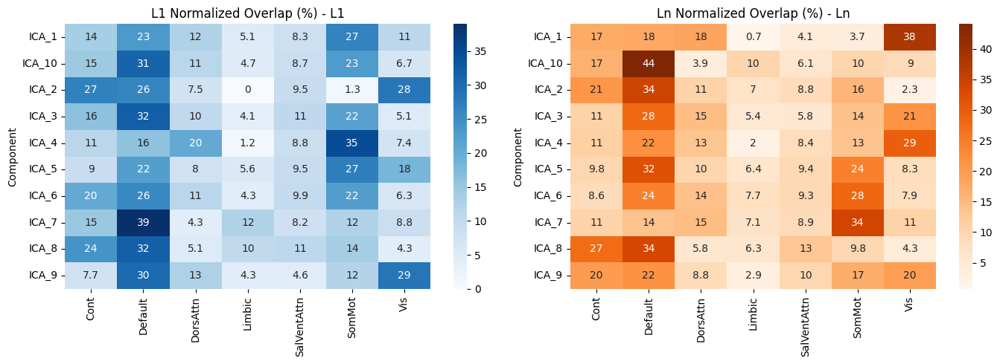

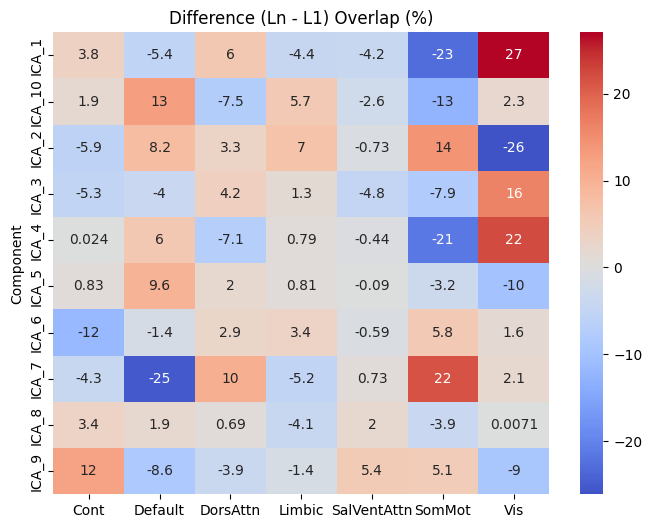


Paired t-test results (Ln vs L1) per network:
Cont: t = -0.24, p = 0.8157
Default: t = -0.17, p = 0.8686
DorsAttn: t = 0.61, p = 0.5583
Limbic: t = 0.29, p = 0.7753
SalVentAttn: t = -0.57, p = 0.5830
SomMot: t = -0.54, p = 0.6018
Vis: t = 0.52, p = 0.6146


In [191]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ttest_rel, wilcoxon

# Load the data
l1_df = pd.read_csv("ica_network_overlap_L1_voxels.csv", index_col=0)
ln_df = pd.read_csv("ica_network_overlap_Ln_voxels.csv", index_col=0)

# Normalize to percentage per component
l1_norm = l1_df.div(l1_df.sum(axis=1), axis=0) * 100
ln_norm = ln_df.div(ln_df.sum(axis=1), axis=0) * 100

# Quick heatmap of normalized overlap
plt.figure(figsize=(14, 5))
plt.subplot(1, 2, 1)
sns.heatmap(l1_norm, annot=True, cmap='Blues')
plt.title('L1 Normalized Overlap (%) - L1')

plt.subplot(1, 2, 2)
sns.heatmap(ln_norm, annot=True, cmap='Oranges')
plt.title('Ln Normalized Overlap (%) - Ln')
plt.tight_layout()
plt.show()

# Difference heatmap
diff = ln_norm - l1_norm
plt.figure(figsize=(8, 6))
sns.heatmap(diff, annot=True, center=0, cmap='coolwarm')
plt.title('Difference (Ln - L1) Overlap (%)')
plt.show()

# Paired t-tests or Wilcoxon test per network
print("\nPaired t-test results (Ln vs L1) per network:")
for network in l1_norm.columns:
    t_stat, p_val = ttest_rel(ln_norm[network], l1_norm[network])
    print(f"{network}: t = {t_stat:.2f}, p = {p_val:.4f}")

# Optional: Wilcoxon alternative if non-normal
# from scipy.stats import wilcoxon
# for network in l1_norm.columns:
#     stat, p = wilcoxon(ln_norm[network], l1_norm[network])
#     print(f"{network}: Wilcoxon p = {p:.4f}")

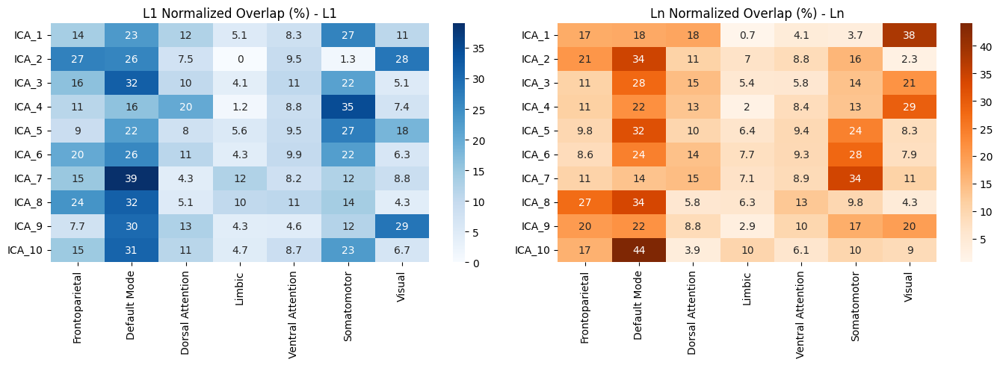

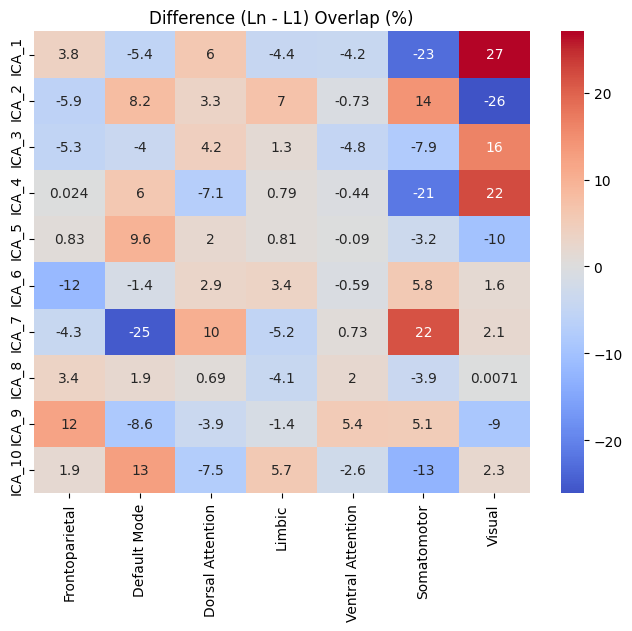


Paired t-test results (Ln vs L1) per network:
Frontoparietal: t = -0.24, p = 0.8157
Default Mode: t = -0.17, p = 0.8686
Dorsal Attention: t = 0.61, p = 0.5583
Limbic: t = 0.29, p = 0.7753
Ventral Attention: t = -0.57, p = 0.5830
Somatomotor: t = -0.54, p = 0.6018
Visual: t = 0.52, p = 0.6146


In [204]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import ttest_rel

# Load the data
l1_df = pd.read_csv("ica_network_overlap_L1_voxels.csv", index_col=0)
ln_df = pd.read_csv("ica_network_overlap_Ln_voxels.csv", index_col=0)

# Rename columns to full network names
rename_map = {
    'Vis': 'Visual',
    'SomMot': 'Somatomotor',
    'DorsAttn': 'Dorsal Attention',
    'SalVentAttn': 'Ventral Attention',
    'Limbic': 'Limbic',
    'Cont': 'Frontoparietal',
    'Default': 'Default Mode'
}
l1_df = l1_df.rename(columns=rename_map)
ln_df = ln_df.rename(columns=rename_map)

# Reorder rows by ICA component number (ICA_1, ICA_2, ...)
def sort_ica_rows(df):
    df.index = df.index.str.extract(r'ICA_(\d+)', expand=False).astype(int)
    df = df.sort_index()
    df.index = [f"ICA_{i}" for i in df.index]
    return df

l1_df = sort_ica_rows(l1_df)
ln_df = sort_ica_rows(ln_df)

# Normalize to percentage per component
l1_norm = l1_df.div(l1_df.sum(axis=1), axis=0) * 100
ln_norm = ln_df.div(ln_df.sum(axis=1), axis=0) * 100

# Heatmaps
plt.figure(figsize=(14, 5))
plt.subplot(1, 2, 1)
sns.heatmap(l1_norm, annot=True, cmap='Blues')
plt.title('L1 Normalized Overlap (%) - L1')

plt.subplot(1, 2, 2)
sns.heatmap(ln_norm, annot=True, cmap='Oranges')
plt.title('Ln Normalized Overlap (%) - Ln')
plt.tight_layout()
plt.show()

# Difference heatmap
diff = ln_norm - l1_norm
plt.figure(figsize=(8, 6))
sns.heatmap(diff, annot=True, center=0, cmap='coolwarm')
plt.title('Difference (Ln - L1) Overlap (%)')
plt.show()

# Paired t-tests per network
print("\nPaired t-test results (Ln vs L1) per network:")
for network in l1_norm.columns:
    t_stat, p_val = ttest_rel(ln_norm[network], l1_norm[network])
    print(f"{network}: t = {t_stat:.2f}, p = {p_val:.4f}")

My interpretation of Overall Pattern Differences 

01) Visual Network (Vis):

Ln shows substantially increased overlap in ICA_1 (+27%), ICA_3 (+16%), ICA_4 (+22%), and ICA_5 (+10%) compared to L1.
➤ This suggests greater visual network recruitment during Ln processing, possibly reflecting increased reliance on visual cues or attentional control in second-language comprehension.

02) Dorsal Attention (DorsAttn) & Control (Cont) Networks: 

Moderate increases in ICA_2 and ICA_3 for Ln, but mixed trends elsewhere.
➤ These fluctuations suggest task-specific or participant-specific attention modulation in Ln usage.

03) Somatomotor (SomMot) Network:
   
Nearly all ICA components show reduced overlap in Ln, particularly ICA_1 (−23%) and ICA_4 (−21%).
➤ Points to reduced sensorimotor integration during Ln compared to L1, perhaps due to decreased articulation-related processing.

04) Salience/Ventral Attention (SalVentAttn):
Slight increases in ICA_2 and ICA_8, but not consistent.
➤ May reflect minor differences in attentional switching or salience tracking when using a non-native language.

Conclusions and Insights

	•	🔍 Ln appears to shift processing toward visual and cognitive control networks (e.g., Visual, Default), while reducing somatomotor network involvement.
	•	💬 These shifts may reflect increased cognitive demand, less automatic articulation, or greater visual reliance during second language processing.

In [55]:
import os, glob
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from nilearn import plotting, image
from nilearn.image import resample_to_img
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# ---- Config ----
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_L1_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"
figdir = "./separate_networks_per_component"
os.makedirs(figdir, exist_ok=True)

# ---- Load ----
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# ---- Parse network labels ----
with open(labels_path) as f:
    labels = f.read().splitlines()
network_names = [line.split('_')[2] for line in labels]
unique_networks = list(dict.fromkeys(network_names))  # preserve order
network_id_map = {name: i+1 for i, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[name] for name in network_names])

# ---- Create network label map (voxel-wise) ----
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

# ---- Color setup ----
network_colors = [
    "#e377c2", "#ff7f0e", "#2ca02c", "#d62728", "#9467bd", "#8c564b", "#1f77b4"
]
cmap_list = ListedColormap(network_colors)

# ---- Plot: 7 networks per component ----
for comp_idx, comp_file in enumerate(ica_files):
    comp_img = nib.load(comp_file)
    comp_data = resample_to_img(comp_img, atlas_img).get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    for net_id in range(1, 8):
        net_mask = (atlas_network_map == net_id)
        overlap_mask = active_voxels & net_mask
        if not np.any(overlap_mask):
            continue

        binary_map = np.zeros_like(comp_data)
        binary_map[overlap_mask] = 1
        net_img = nib.Nifti1Image(binary_map, affine=atlas_img.affine)

        # Plot & Save
        display = plotting.plot_glass_brain(
            net_img, cmap=ListedColormap([network_colors[net_id - 1]]),
            display_mode='lzry', colorbar=False,
            title=f"ICA {comp_idx+1} - {unique_networks[net_id-1]}"
        )

        patch = mpatches.Patch(color=network_colors[net_id - 1], label=unique_networks[net_id - 1])
        plt.legend(handles=[patch], bbox_to_anchor=(1.05, 1), loc='upper left')

        fname = f"ICA_{comp_idx+1}_{unique_networks[net_id-1].replace(' ', '')}.png"
        plt.savefig(os.path.join(figdir, fname), bbox_inches='tight', dpi=150)
        plt.close()
        print(f"Saved: {fname}")

Saved: ICA_1_Vis.png
Saved: ICA_1_SomMot.png
Saved: ICA_1_DorsAttn.png
Saved: ICA_1_SalVentAttn.png
Saved: ICA_1_Limbic.png
Saved: ICA_1_Cont.png
Saved: ICA_1_Default.png
Saved: ICA_2_Vis.png
Saved: ICA_2_SomMot.png
Saved: ICA_2_DorsAttn.png
Saved: ICA_2_SalVentAttn.png
Saved: ICA_2_Cont.png
Saved: ICA_2_Default.png
Saved: ICA_3_Vis.png
Saved: ICA_3_SomMot.png
Saved: ICA_3_DorsAttn.png
Saved: ICA_3_SalVentAttn.png
Saved: ICA_3_Limbic.png
Saved: ICA_3_Cont.png
Saved: ICA_3_Default.png
Saved: ICA_4_Vis.png
Saved: ICA_4_SomMot.png
Saved: ICA_4_DorsAttn.png
Saved: ICA_4_SalVentAttn.png
Saved: ICA_4_Limbic.png
Saved: ICA_4_Cont.png
Saved: ICA_4_Default.png
Saved: ICA_5_Vis.png
Saved: ICA_5_SomMot.png
Saved: ICA_5_DorsAttn.png
Saved: ICA_5_SalVentAttn.png
Saved: ICA_5_Limbic.png
Saved: ICA_5_Cont.png
Saved: ICA_5_Default.png
Saved: ICA_6_Vis.png
Saved: ICA_6_SomMot.png
Saved: ICA_6_DorsAttn.png
Saved: ICA_6_SalVentAttn.png
Saved: ICA_6_Limbic.png
Saved: ICA_6_Cont.png
Saved: ICA_6_Default.pn

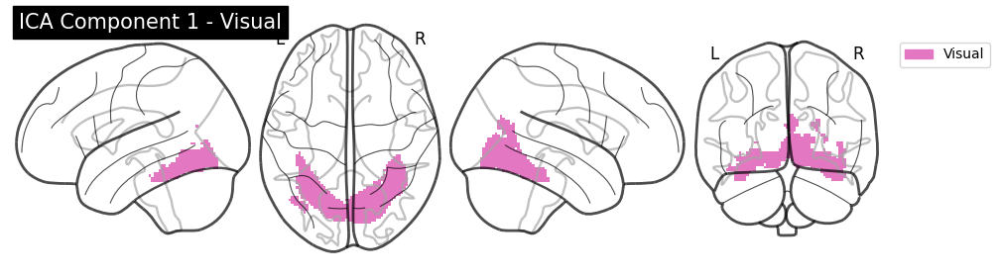

Saved: ./per_network_per_component_figures/ICA1_Visual.png


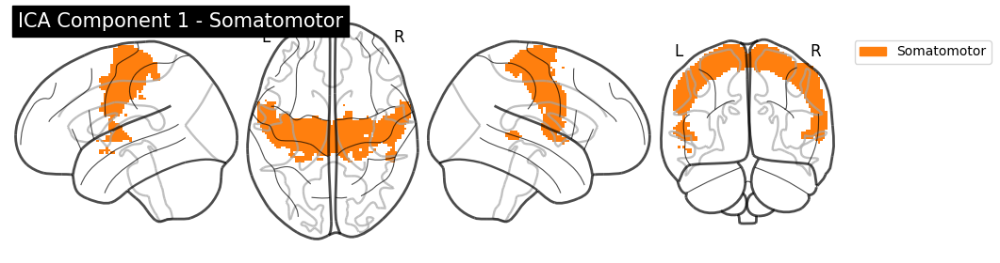

Saved: ./per_network_per_component_figures/ICA1_Somatomotor.png


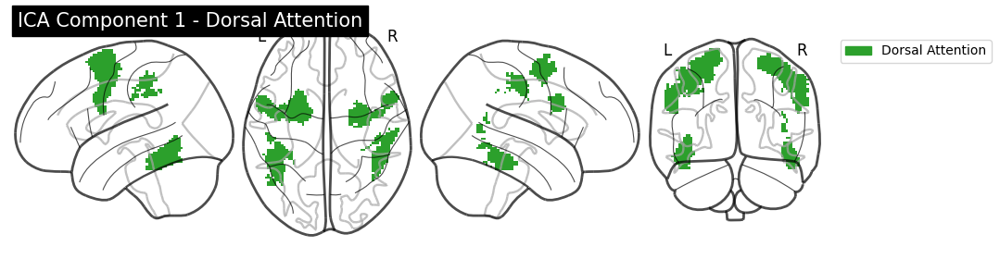

Saved: ./per_network_per_component_figures/ICA1_Dorsal_Attention.png


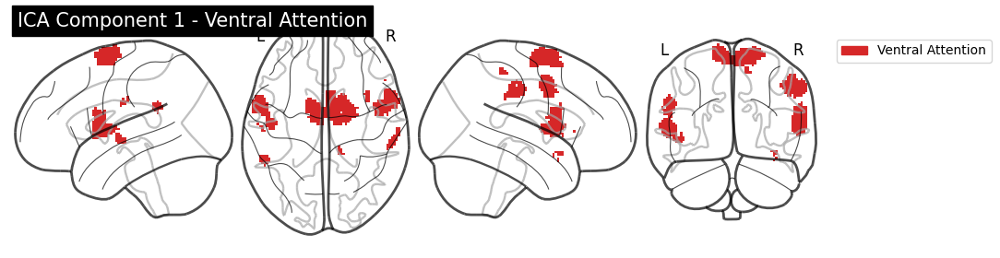

Saved: ./per_network_per_component_figures/ICA1_Ventral_Attention.png


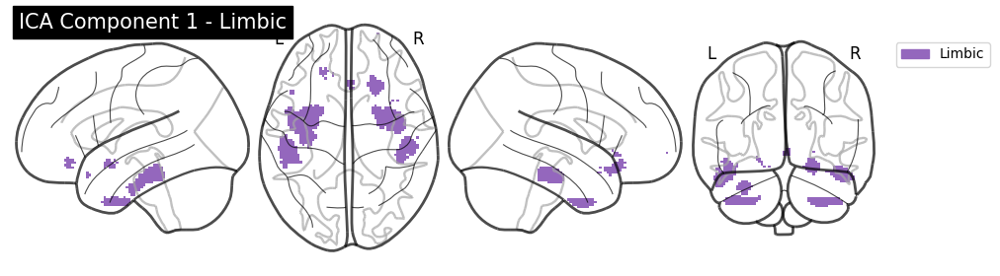

Saved: ./per_network_per_component_figures/ICA1_Limbic.png


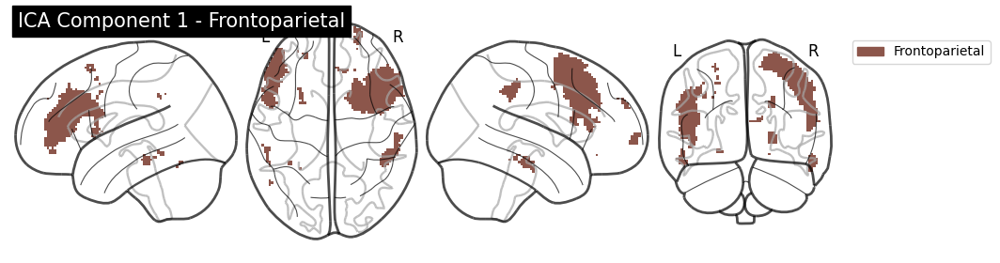

Saved: ./per_network_per_component_figures/ICA1_Frontoparietal.png


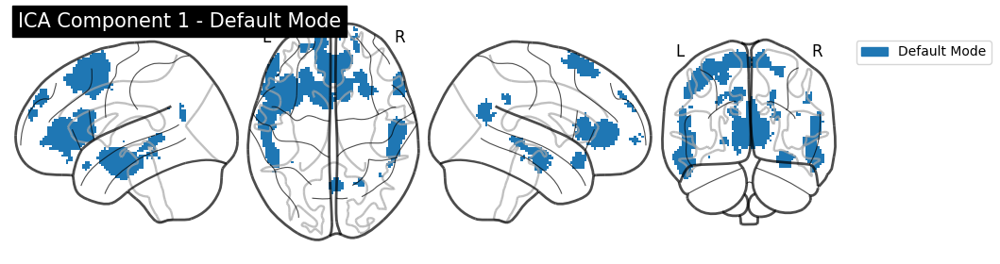

Saved: ./per_network_per_component_figures/ICA1_Default_Mode.png


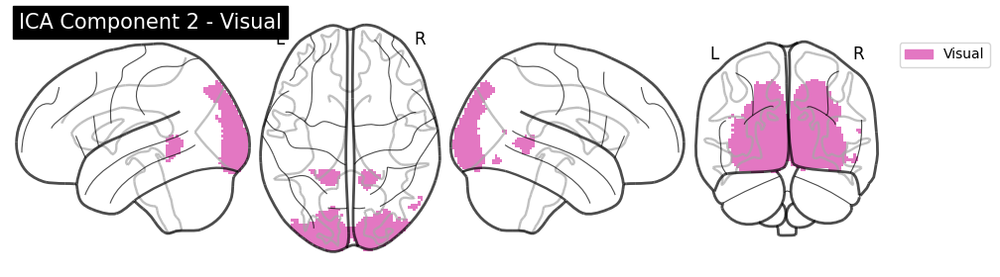

Saved: ./per_network_per_component_figures/ICA2_Visual.png


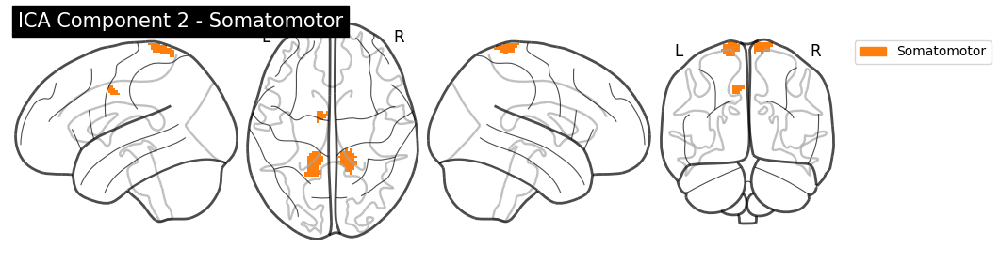

Saved: ./per_network_per_component_figures/ICA2_Somatomotor.png


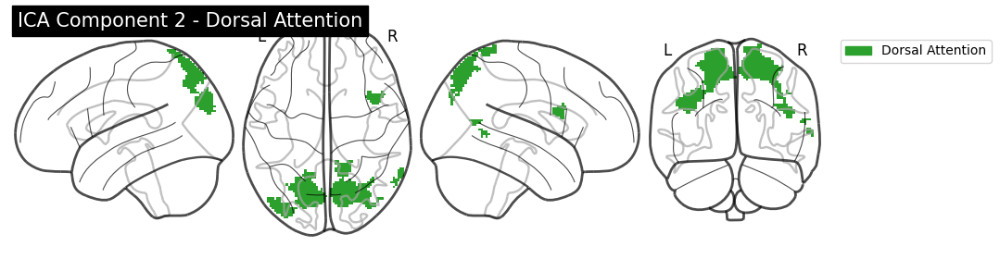

Saved: ./per_network_per_component_figures/ICA2_Dorsal_Attention.png


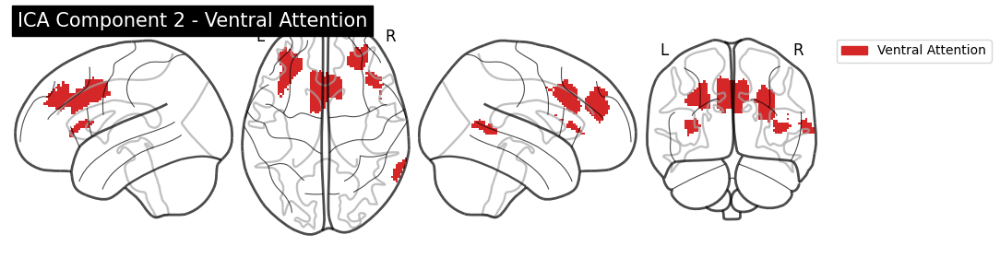

Saved: ./per_network_per_component_figures/ICA2_Ventral_Attention.png


/Users/onilarasanjala/mambaforge/envs/neuro_project/lib/python3.9/site-packages/nilearn/plotting/displays/_slicers.py:382: UserWarning: empty mask
  get_mask_bounds(new_img_like(img, not_mask, affine))


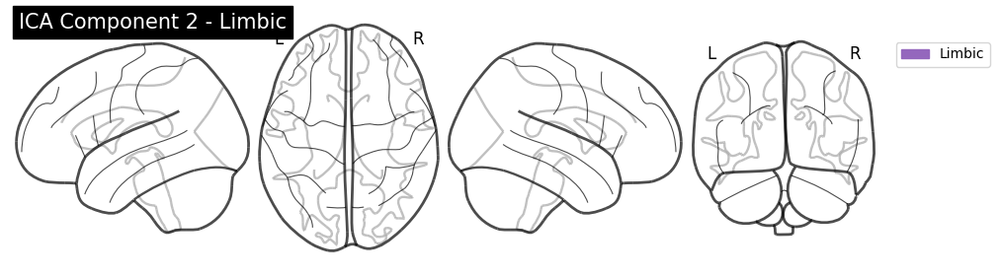

Saved: ./per_network_per_component_figures/ICA2_Limbic.png


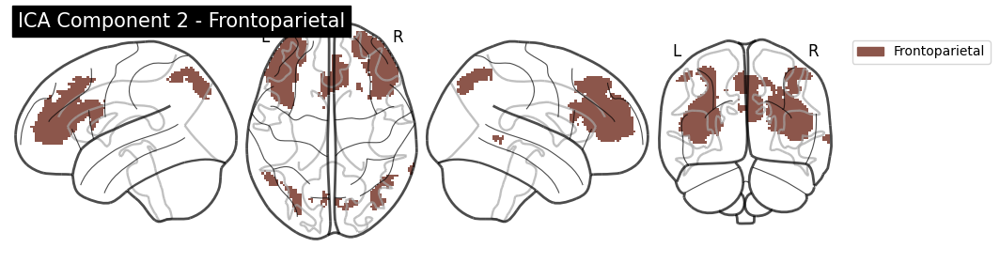

Saved: ./per_network_per_component_figures/ICA2_Frontoparietal.png


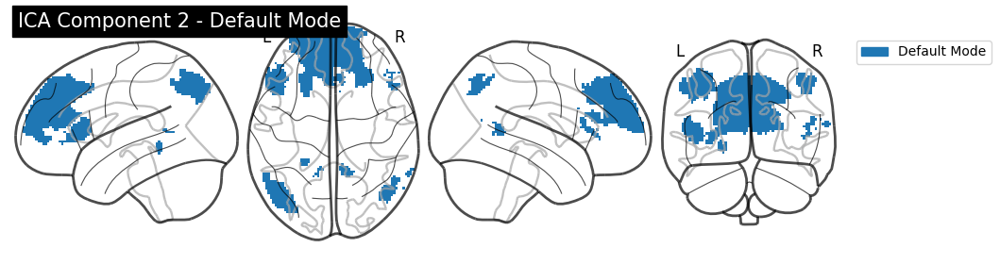

Saved: ./per_network_per_component_figures/ICA2_Default_Mode.png


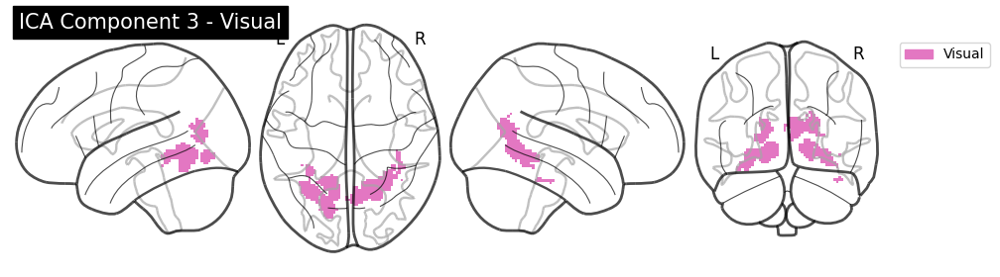

Saved: ./per_network_per_component_figures/ICA3_Visual.png


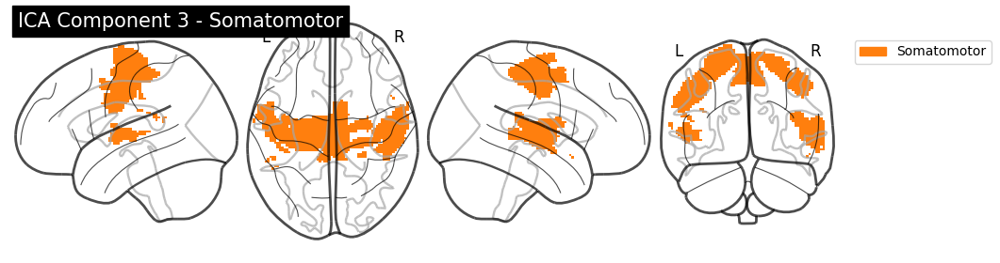

Saved: ./per_network_per_component_figures/ICA3_Somatomotor.png


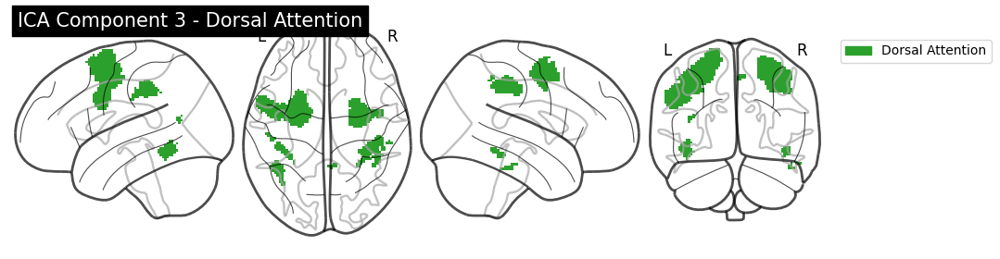

Saved: ./per_network_per_component_figures/ICA3_Dorsal_Attention.png


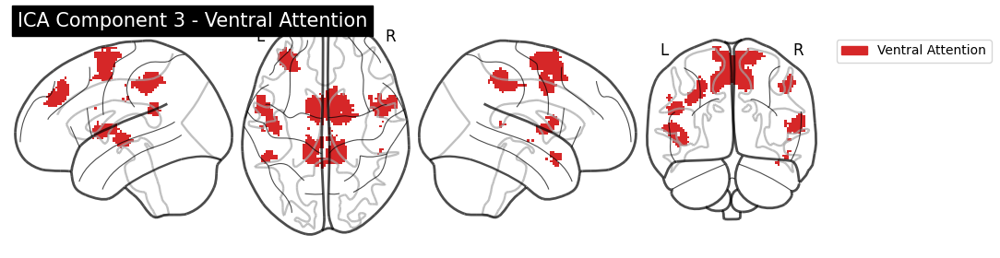

Saved: ./per_network_per_component_figures/ICA3_Ventral_Attention.png


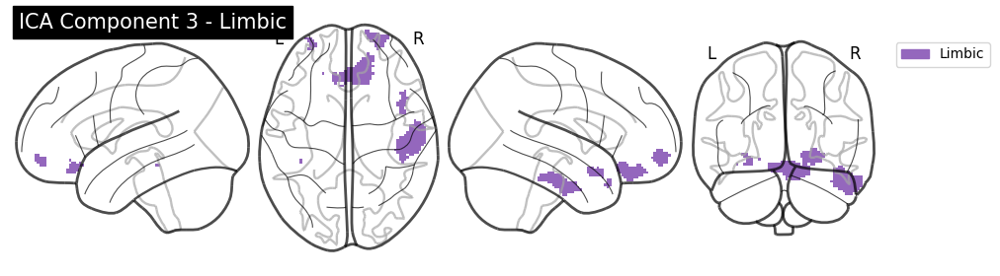

Saved: ./per_network_per_component_figures/ICA3_Limbic.png


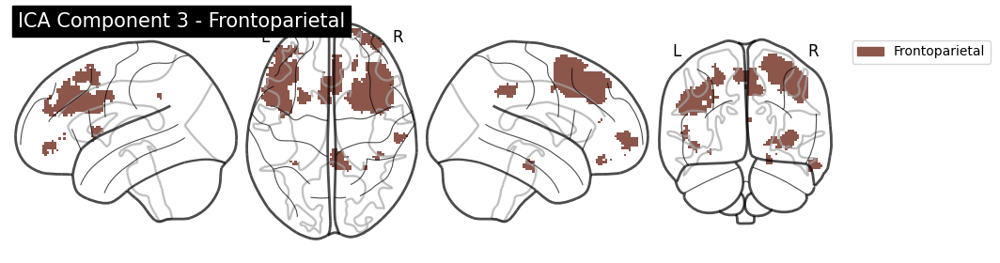

Saved: ./per_network_per_component_figures/ICA3_Frontoparietal.png


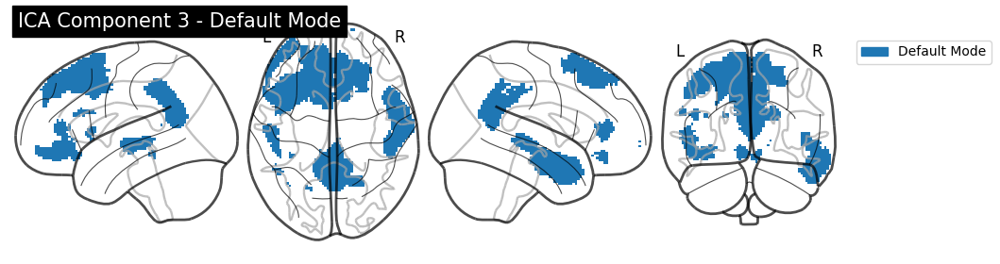

Saved: ./per_network_per_component_figures/ICA3_Default_Mode.png


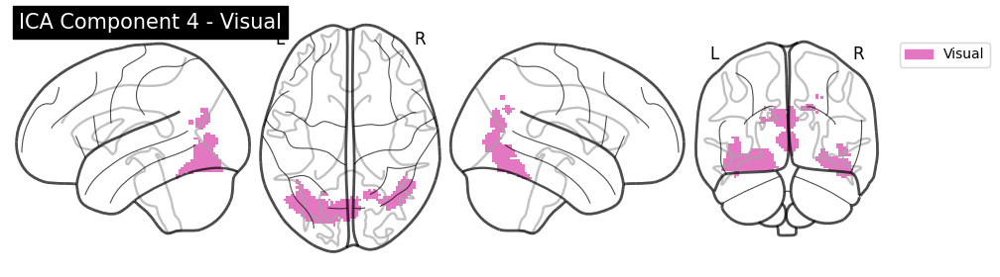

Saved: ./per_network_per_component_figures/ICA4_Visual.png


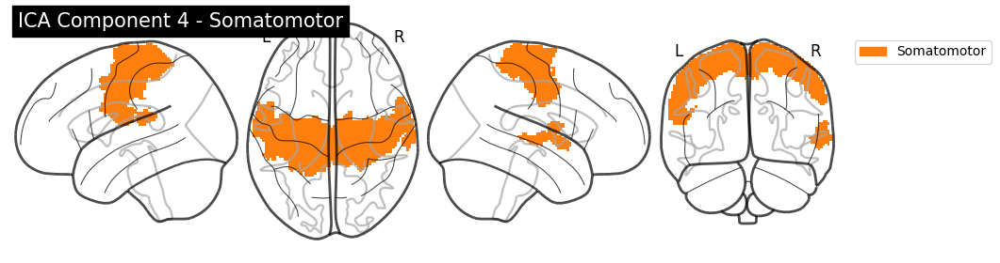

Saved: ./per_network_per_component_figures/ICA4_Somatomotor.png


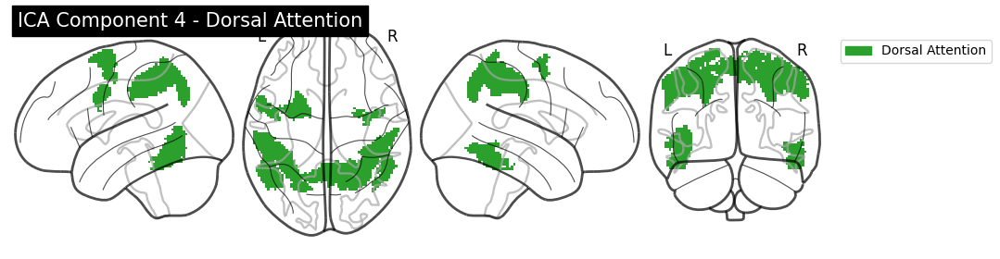

Saved: ./per_network_per_component_figures/ICA4_Dorsal_Attention.png


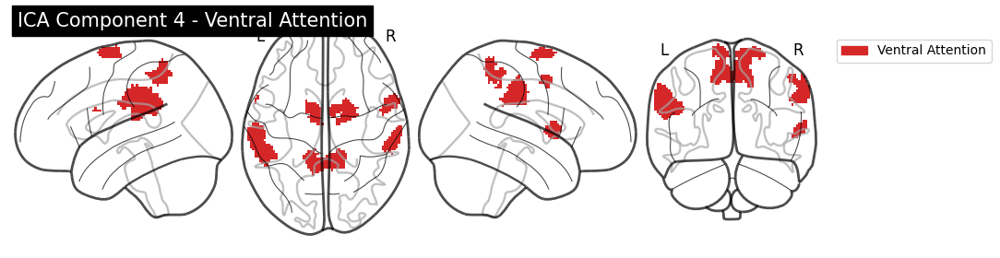

Saved: ./per_network_per_component_figures/ICA4_Ventral_Attention.png


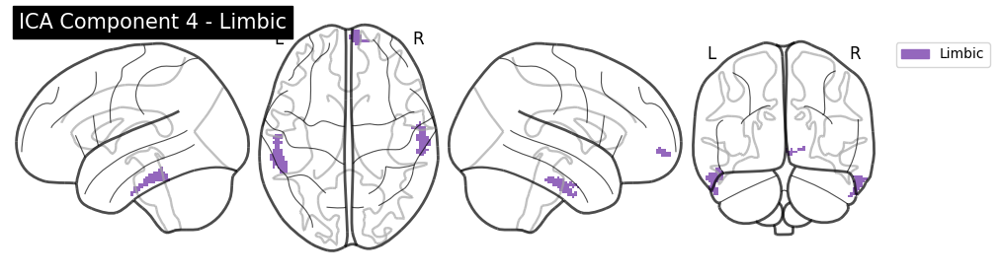

Saved: ./per_network_per_component_figures/ICA4_Limbic.png


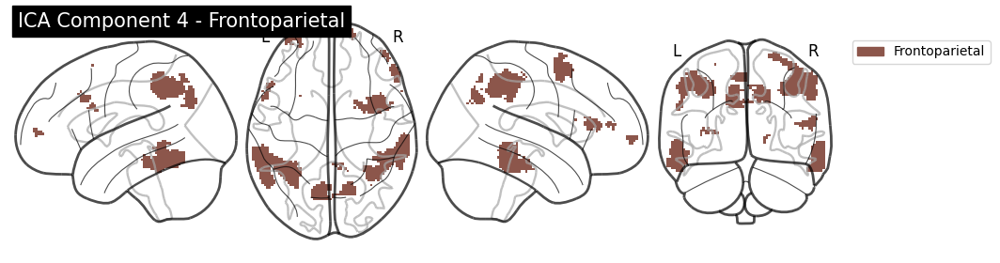

Saved: ./per_network_per_component_figures/ICA4_Frontoparietal.png


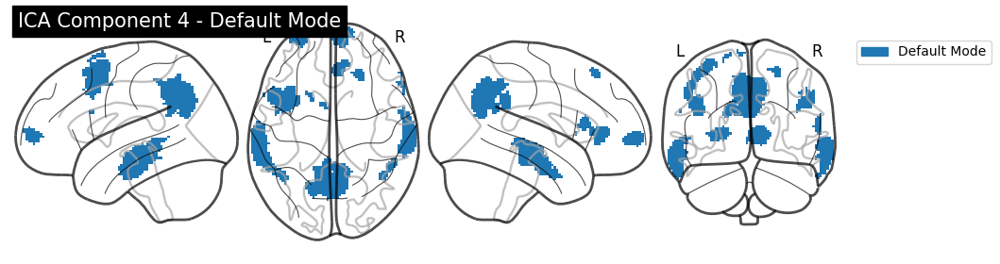

Saved: ./per_network_per_component_figures/ICA4_Default_Mode.png


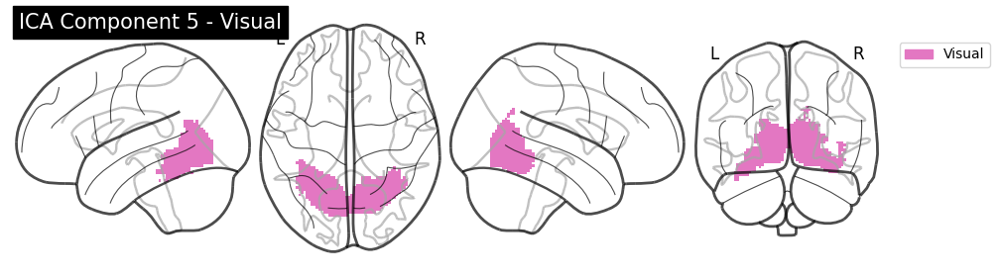

Saved: ./per_network_per_component_figures/ICA5_Visual.png


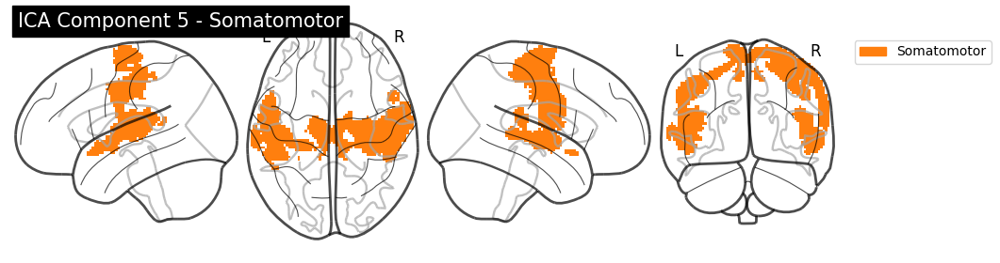

Saved: ./per_network_per_component_figures/ICA5_Somatomotor.png


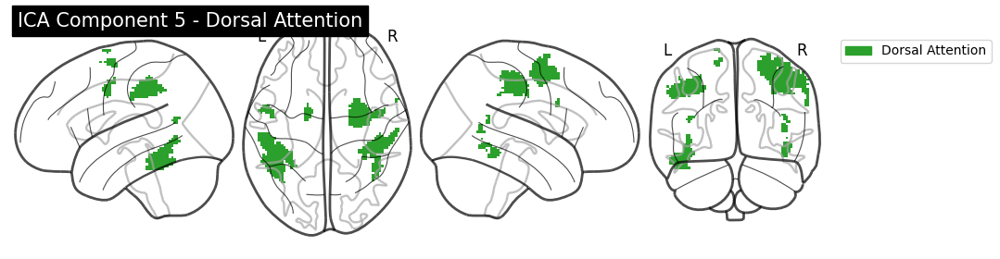

Saved: ./per_network_per_component_figures/ICA5_Dorsal_Attention.png


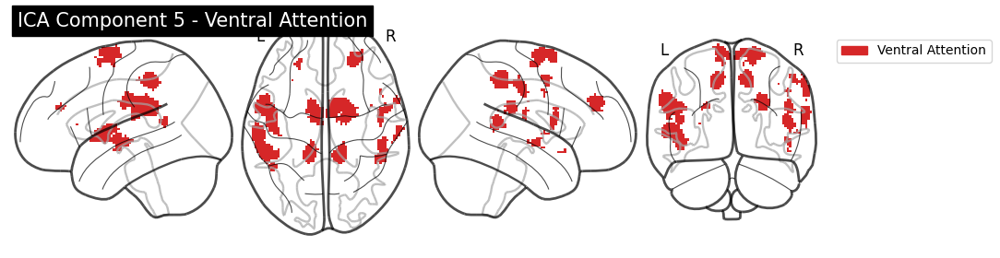

Saved: ./per_network_per_component_figures/ICA5_Ventral_Attention.png


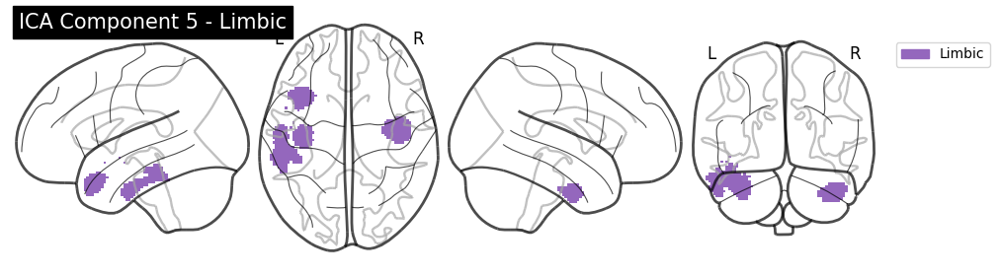

Saved: ./per_network_per_component_figures/ICA5_Limbic.png


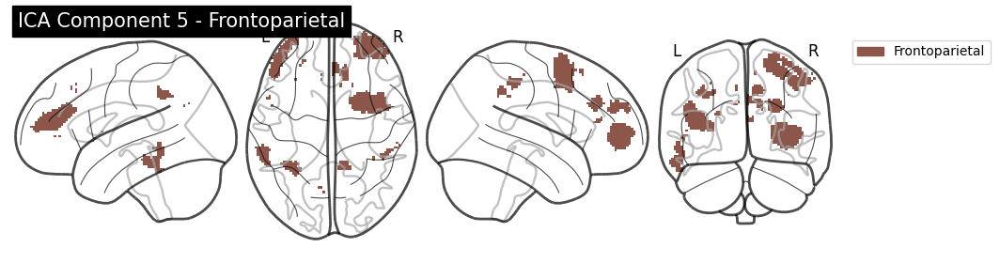

Saved: ./per_network_per_component_figures/ICA5_Frontoparietal.png


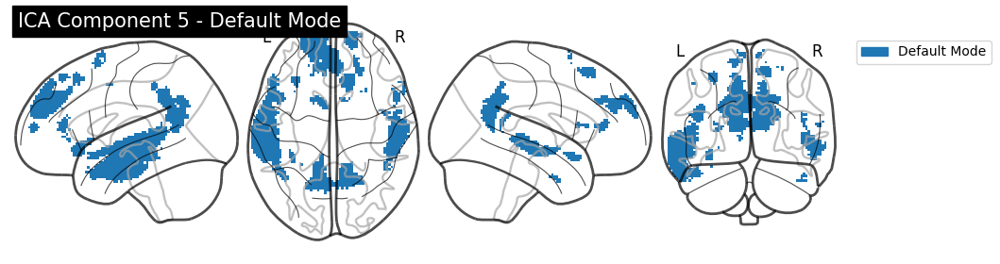

Saved: ./per_network_per_component_figures/ICA5_Default_Mode.png


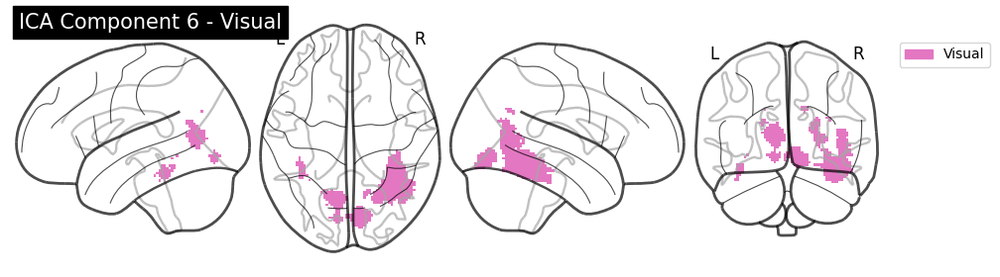

Saved: ./per_network_per_component_figures/ICA6_Visual.png


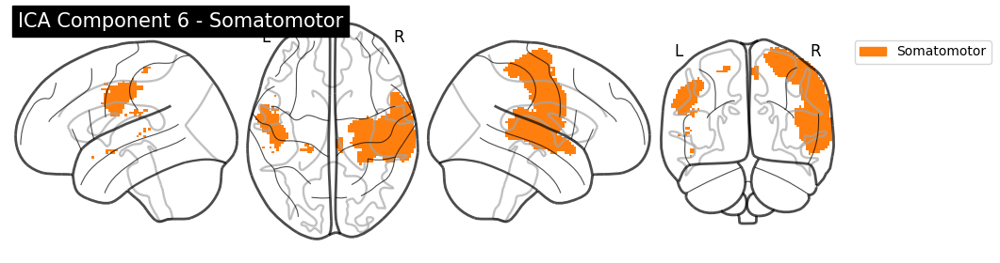

Saved: ./per_network_per_component_figures/ICA6_Somatomotor.png


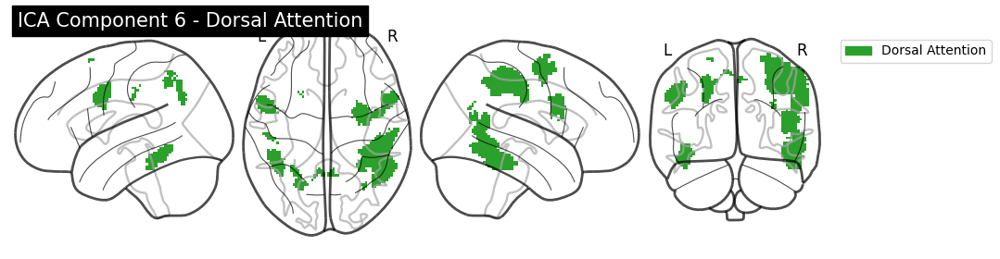

Saved: ./per_network_per_component_figures/ICA6_Dorsal_Attention.png


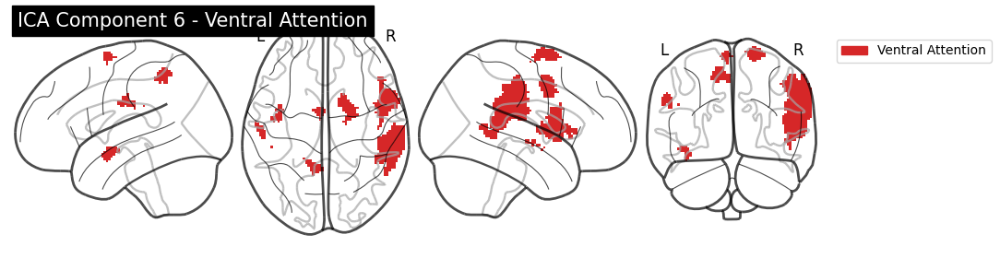

Saved: ./per_network_per_component_figures/ICA6_Ventral_Attention.png


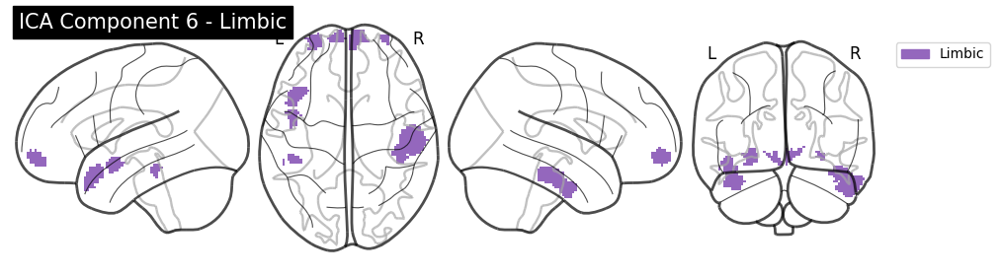

Saved: ./per_network_per_component_figures/ICA6_Limbic.png


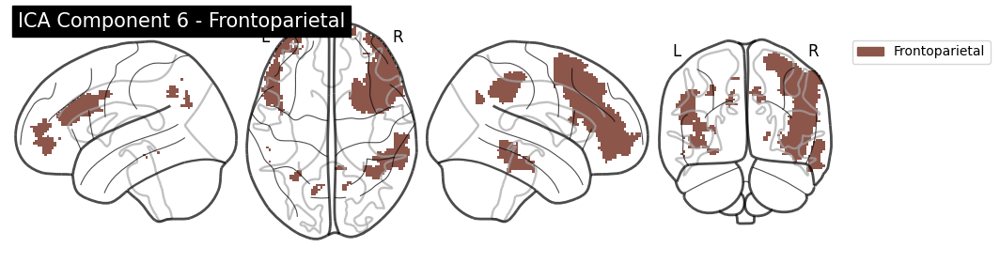

Saved: ./per_network_per_component_figures/ICA6_Frontoparietal.png


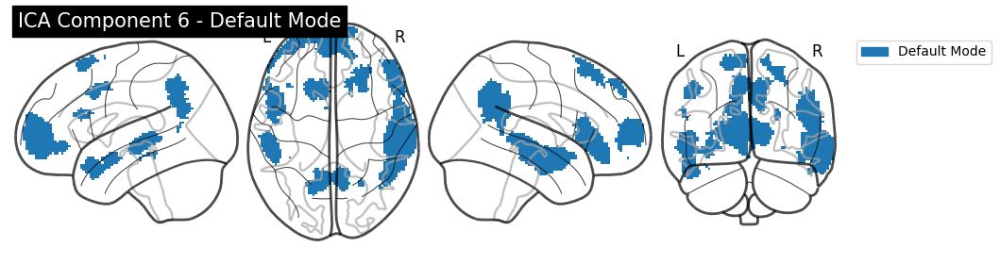

Saved: ./per_network_per_component_figures/ICA6_Default_Mode.png


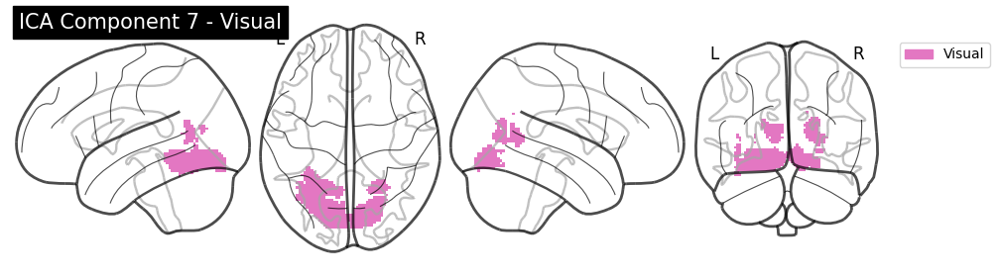

Saved: ./per_network_per_component_figures/ICA7_Visual.png


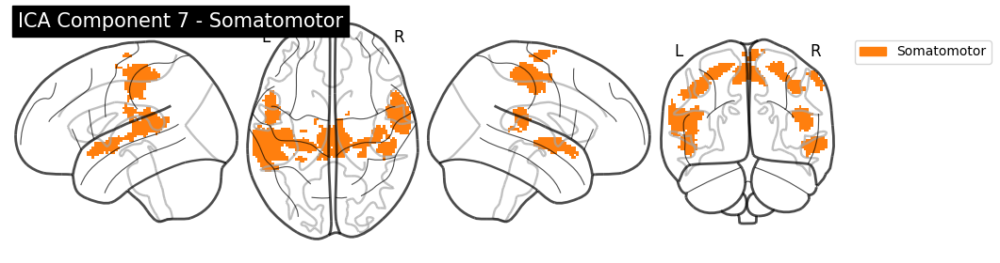

Saved: ./per_network_per_component_figures/ICA7_Somatomotor.png


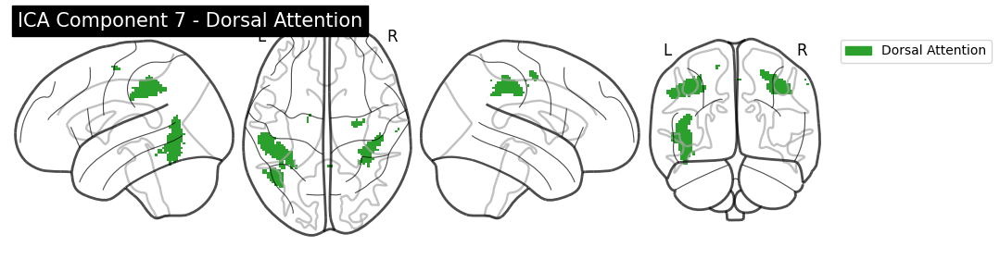

Saved: ./per_network_per_component_figures/ICA7_Dorsal_Attention.png


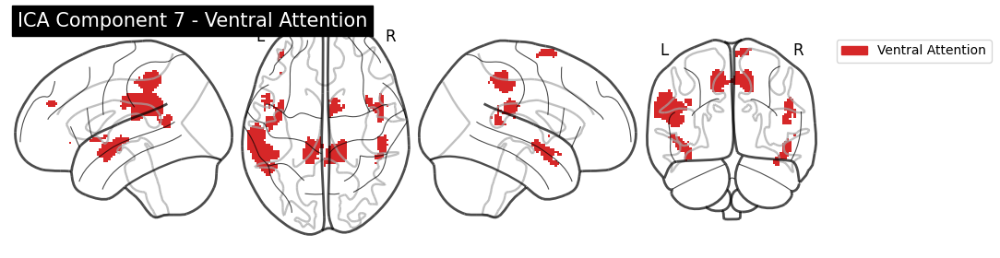

Saved: ./per_network_per_component_figures/ICA7_Ventral_Attention.png


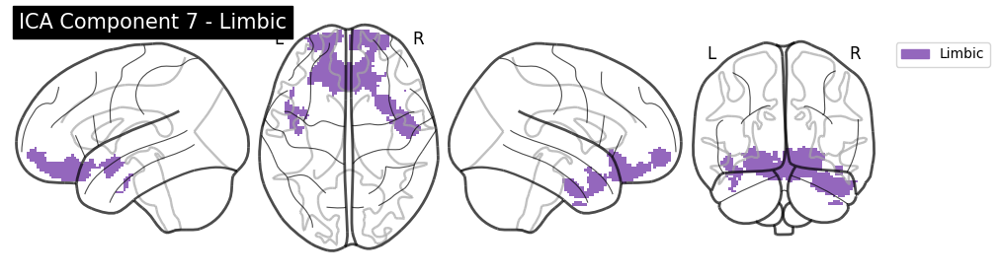

Saved: ./per_network_per_component_figures/ICA7_Limbic.png


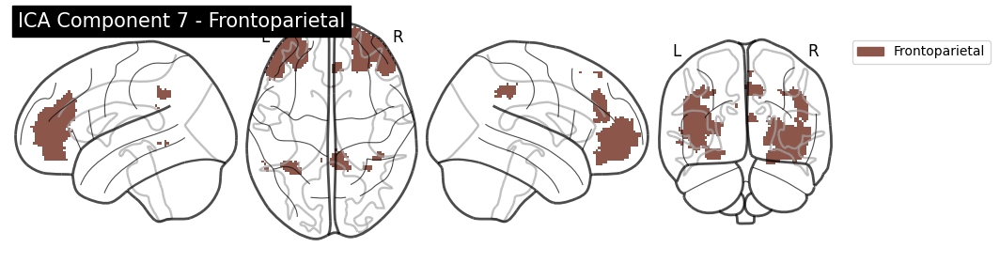

Saved: ./per_network_per_component_figures/ICA7_Frontoparietal.png


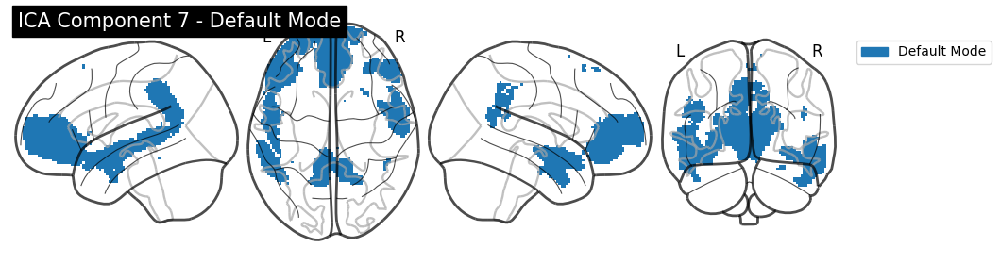

Saved: ./per_network_per_component_figures/ICA7_Default_Mode.png


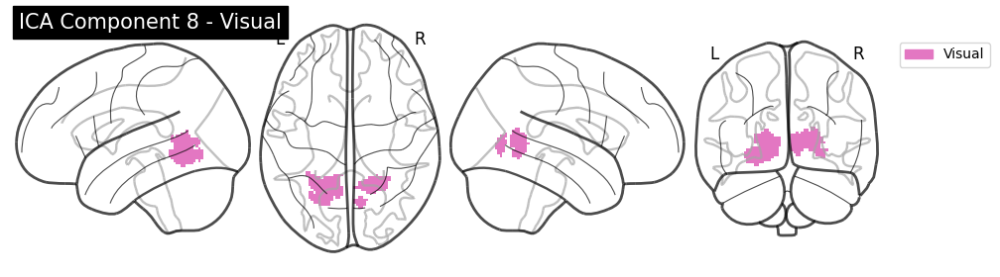

Saved: ./per_network_per_component_figures/ICA8_Visual.png


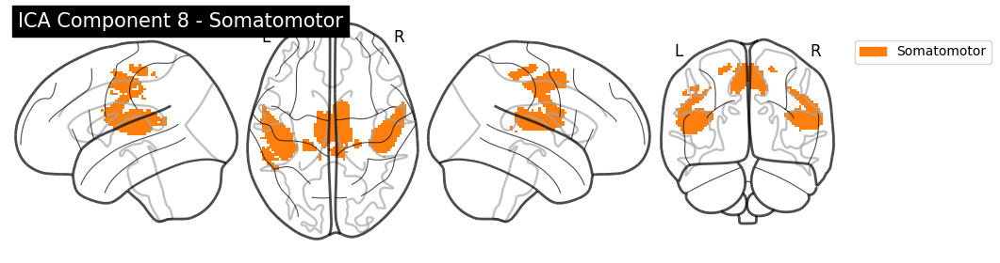

Saved: ./per_network_per_component_figures/ICA8_Somatomotor.png


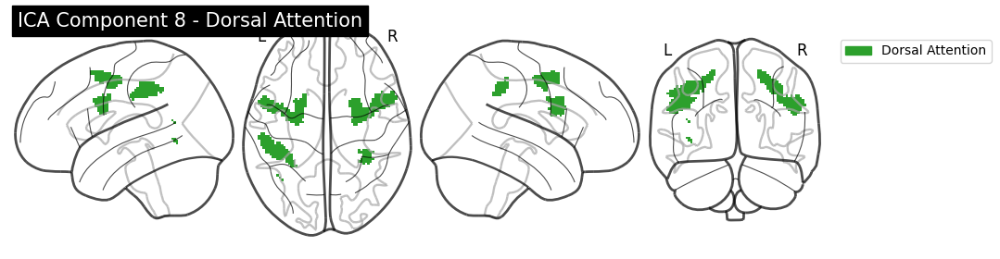

Saved: ./per_network_per_component_figures/ICA8_Dorsal_Attention.png


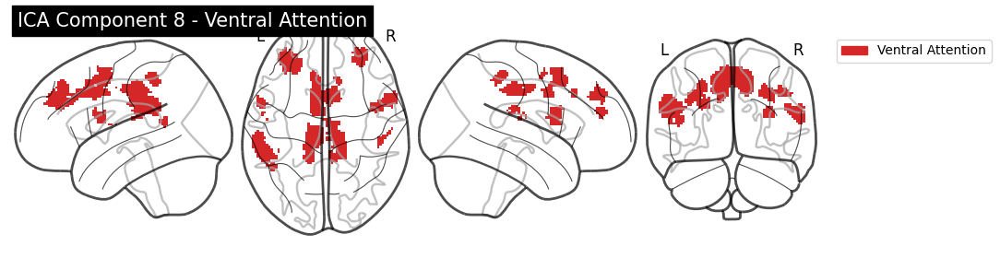

Saved: ./per_network_per_component_figures/ICA8_Ventral_Attention.png


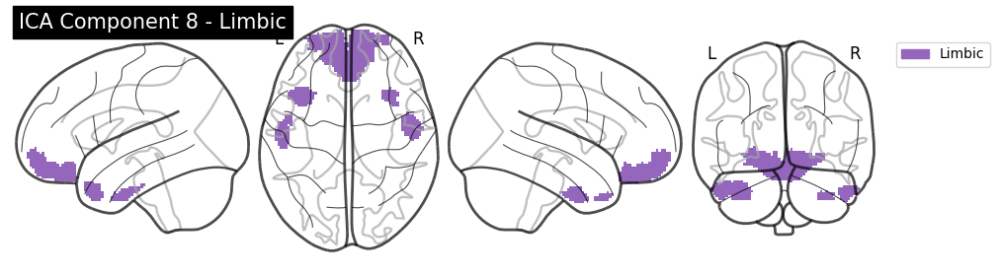

Saved: ./per_network_per_component_figures/ICA8_Limbic.png


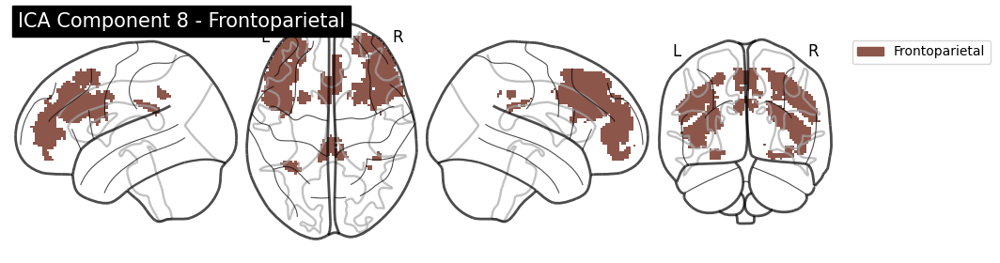

Saved: ./per_network_per_component_figures/ICA8_Frontoparietal.png


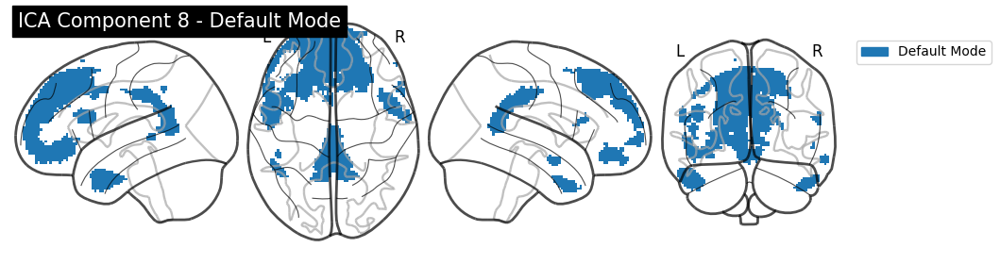

Saved: ./per_network_per_component_figures/ICA8_Default_Mode.png


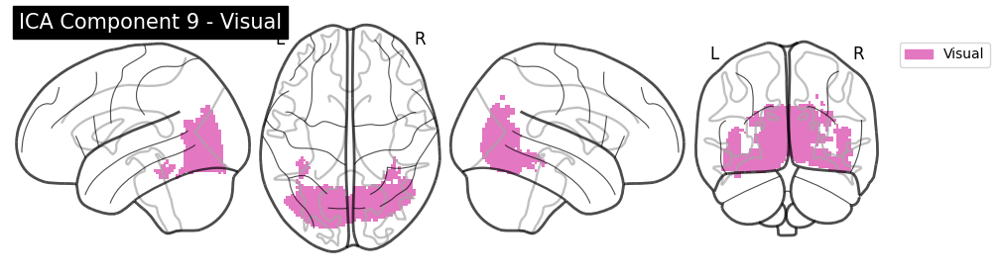

Saved: ./per_network_per_component_figures/ICA9_Visual.png


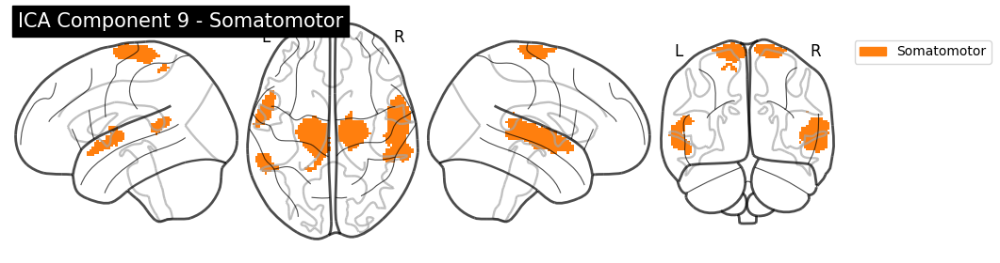

Saved: ./per_network_per_component_figures/ICA9_Somatomotor.png


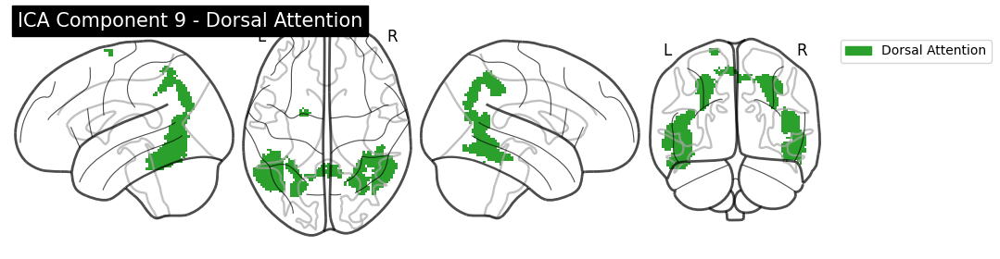

Saved: ./per_network_per_component_figures/ICA9_Dorsal_Attention.png


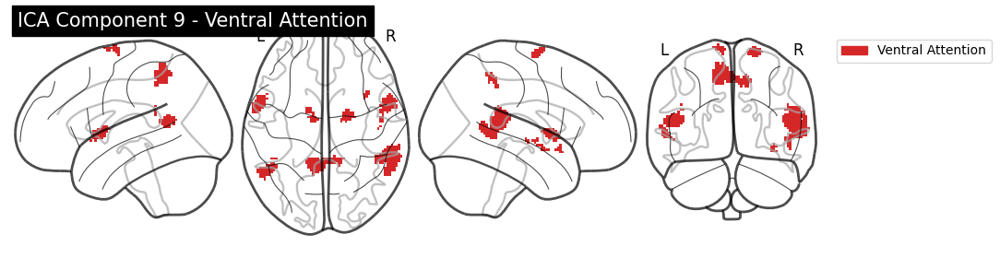

Saved: ./per_network_per_component_figures/ICA9_Ventral_Attention.png


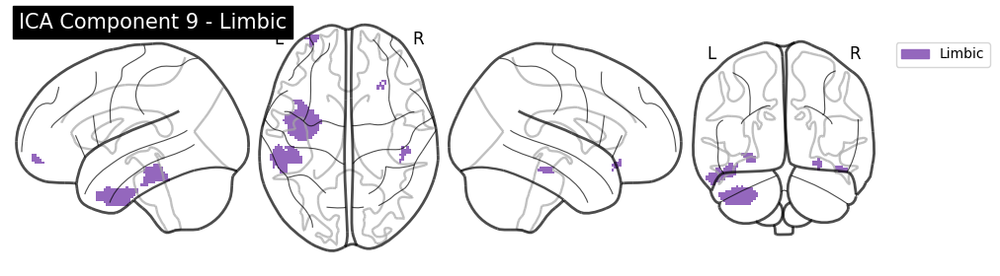

Saved: ./per_network_per_component_figures/ICA9_Limbic.png


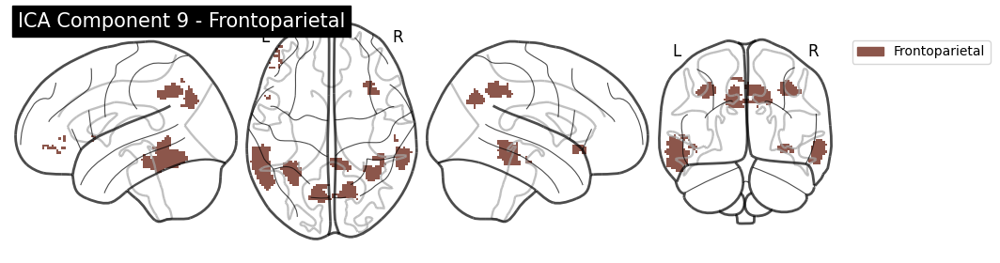

Saved: ./per_network_per_component_figures/ICA9_Frontoparietal.png


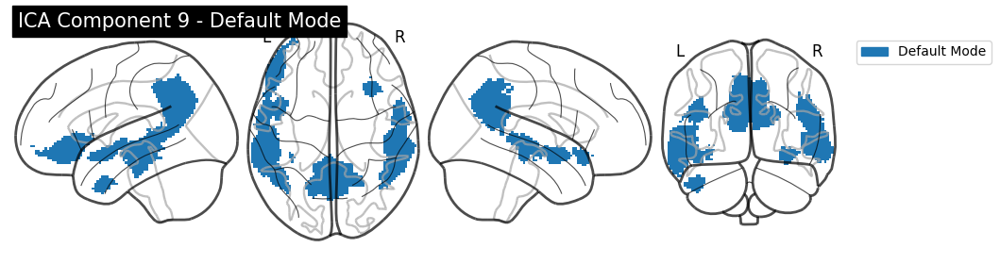

Saved: ./per_network_per_component_figures/ICA9_Default_Mode.png


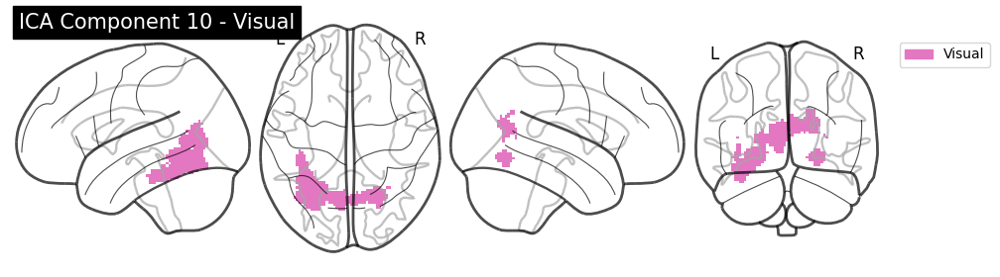

Saved: ./per_network_per_component_figures/ICA10_Visual.png


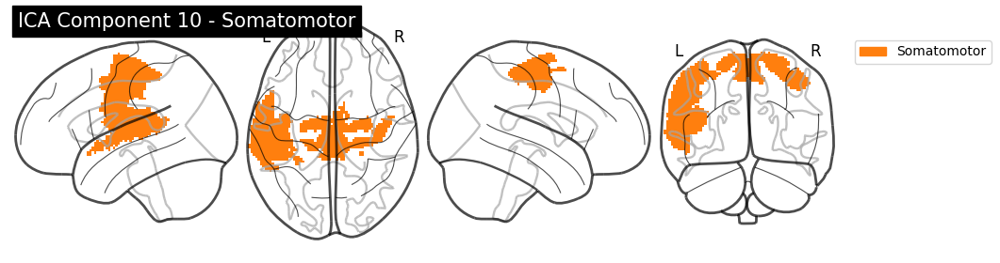

Saved: ./per_network_per_component_figures/ICA10_Somatomotor.png


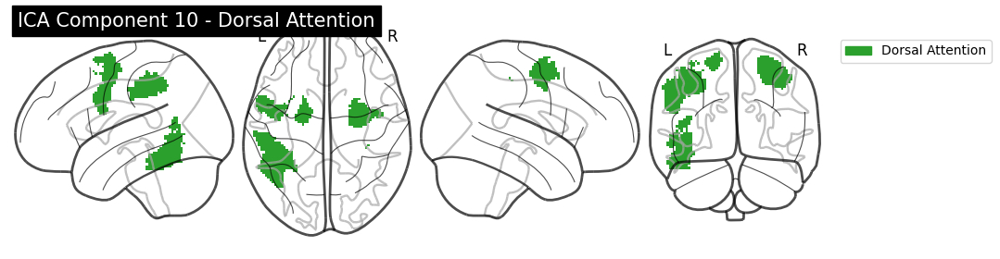

Saved: ./per_network_per_component_figures/ICA10_Dorsal_Attention.png


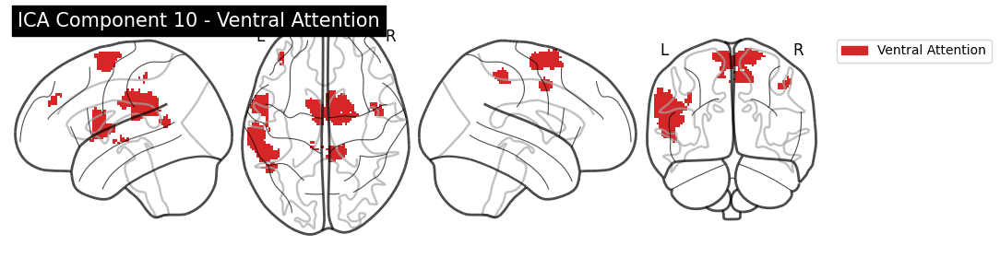

Saved: ./per_network_per_component_figures/ICA10_Ventral_Attention.png


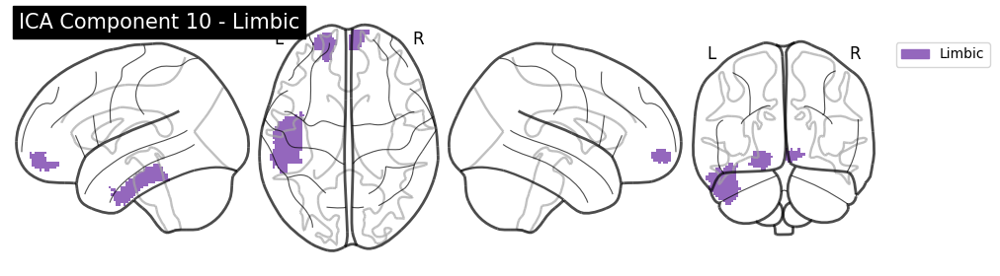

Saved: ./per_network_per_component_figures/ICA10_Limbic.png


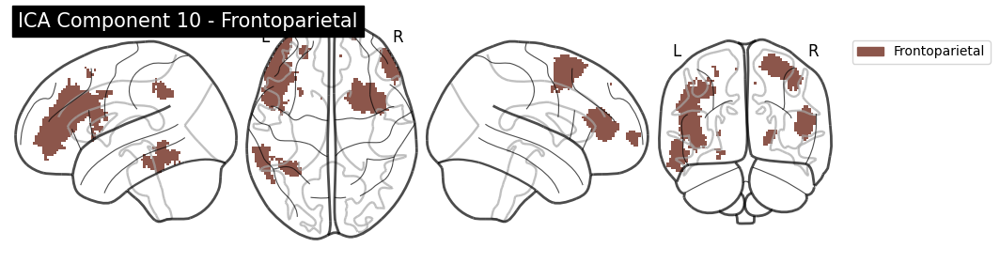

Saved: ./per_network_per_component_figures/ICA10_Frontoparietal.png


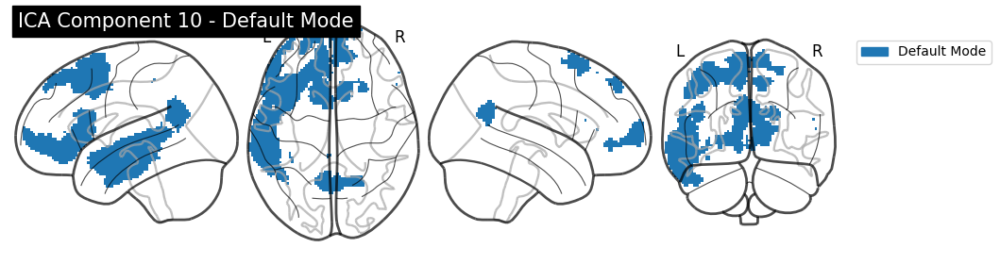

Saved: ./per_network_per_component_figures/ICA10_Default_Mode.png
Overlap results saved to 'ica_network_overlap_L1(Individual-Individual).csv'


In [57]:
import os
import glob
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from nilearn import image, plotting
from nilearn.image import resample_to_img
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# Enable inline display for Jupyter
%matplotlib inline

# --- Paths ---
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_L1_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

# --- Output Directory ---
figdir = "./per_network_per_component_figures"
os.makedirs(figdir, exist_ok=True)

# --- Load ICA Components ---
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# --- Load Atlas and Labels ---
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# Parse Labels
with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

network_names_from_labels = [label.split('_')[2] for label in labels]
unique_networks = sorted(set(network_names_from_labels), key=network_names_from_labels.index)
network_id_map = {name: idx + 1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names_from_labels])

# Create atlas-to-network map
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

# --- Define Network Info ---
network_ids = [1, 2, 3, 4, 5, 6, 7]
network_names = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                 "Limbic", "Frontoparietal", "Default Mode"]
network_colors = [
    "#e377c2",  # pink
    "#ff7f0e",  # orange
    "#2ca02c",  # green
    "#d62728",  # red
    "#9467bd",  # purple
    "#8c564b",  # brown
    "#1f77b4"   # blue
]
custom_cmap = ListedColormap(network_colors)

# --- Overlap Analysis + Per-Network Per-Component Visualization ---
results = []

for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    for net_id, net_name in zip(network_ids, network_names):
        net_mask = atlas_network_map == net_id
        overlap_mask = active_voxels & net_mask
        overlap_count = np.sum(overlap_mask)

        results.append({
            "Component": f"ICA_{comp_idx + 1}",
            "Network_ID": net_id,
            "Network_Name": net_name,
            "Overlap_Voxels": overlap_count
        })

        # Create map for this network
        single_network_map = np.zeros_like(comp_data)
        single_network_map[overlap_mask] = net_id
        single_network_img = nib.Nifti1Image(single_network_map, affine=atlas_img.affine)

        # Plot and show in notebook
        display = plotting.plot_glass_brain(
            single_network_img,
            cmap=ListedColormap([network_colors[net_id - 1]]),
            display_mode='lzry',
            colorbar=False,
            title=f"ICA Component {comp_idx + 1} - {net_name}"
        )

        # Add legend
        patch = mpatches.Patch(color=network_colors[net_id - 1], label=net_name)
        plt.legend(handles=[patch], bbox_to_anchor=(1.05, 1), loc='upper left')

        # Save and show
        output_path = os.path.join(figdir, f"ICA{comp_idx + 1}_{net_name.replace(' ', '_')}.png")
        plt.savefig(output_path, bbox_inches='tight', dpi=150)
        plt.show()  # Show in notebook
        print(f"Saved: {output_path}")

# --- Save CSV of Overlap Results ---
df = pd.DataFrame(results)
df_pivot = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)
df_pivot.to_csv("ica_network_overlap_L1(Individual-Individual).csv")
print("Overlap results saved to 'ica_network_overlap_L1(Individual-Individual).csv'")

## Top 3

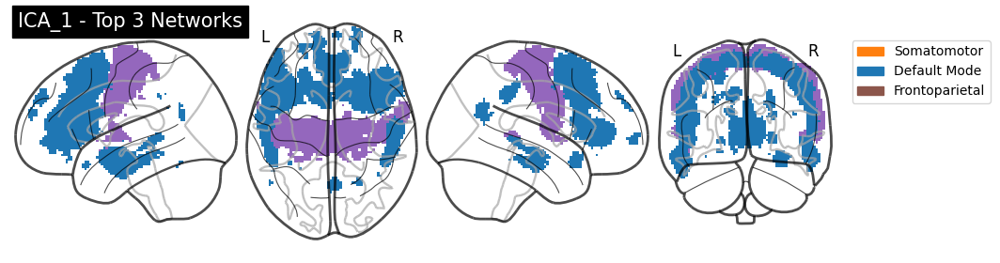

Saved: ./top3_networks_figures/ICA_1_top3.png


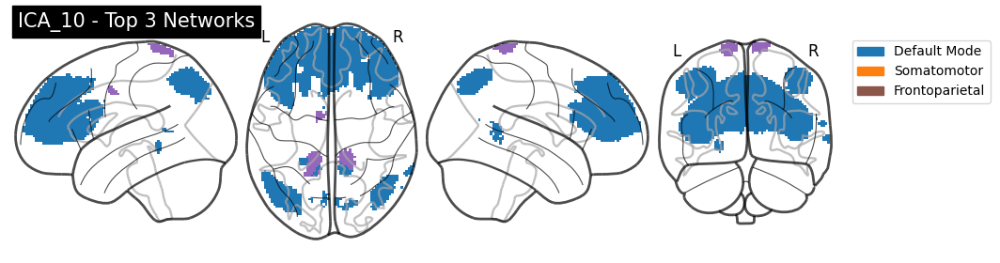

Saved: ./top3_networks_figures/ICA_10_top3.png


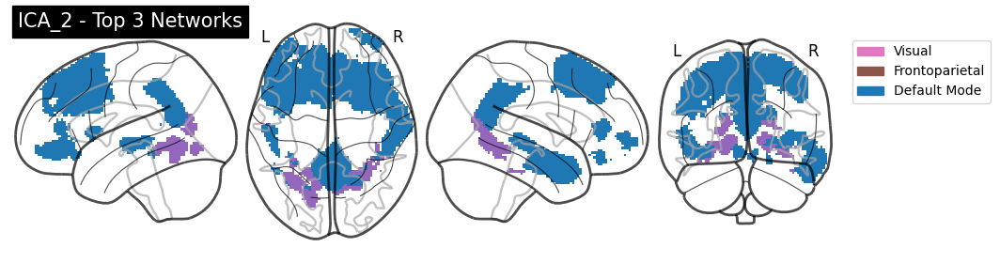

Saved: ./top3_networks_figures/ICA_2_top3.png


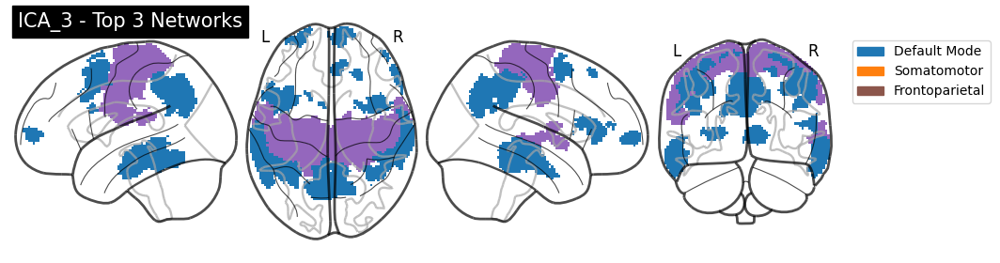

Saved: ./top3_networks_figures/ICA_3_top3.png


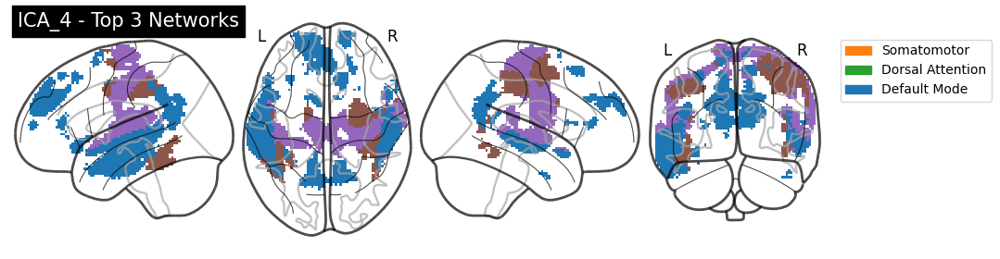

Saved: ./top3_networks_figures/ICA_4_top3.png


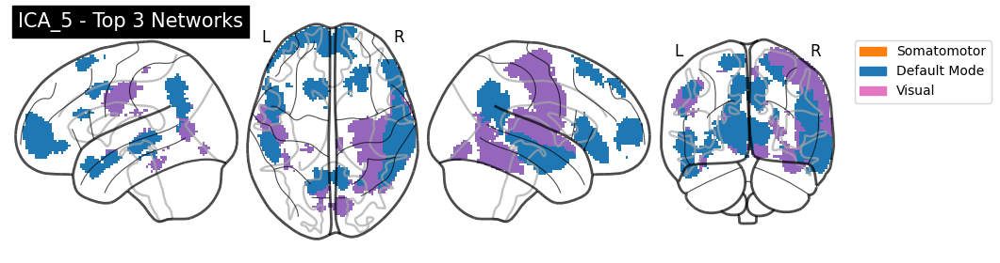

Saved: ./top3_networks_figures/ICA_5_top3.png


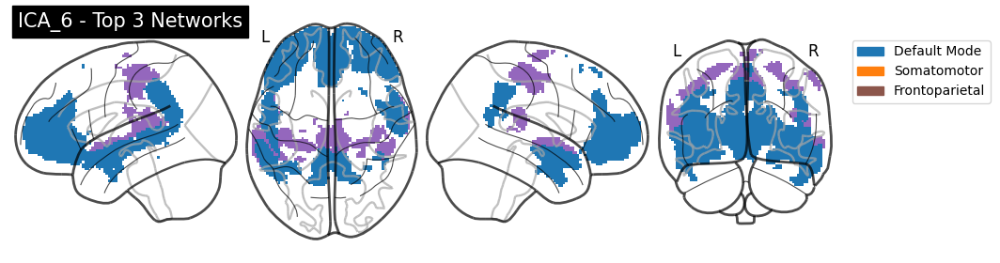

Saved: ./top3_networks_figures/ICA_6_top3.png


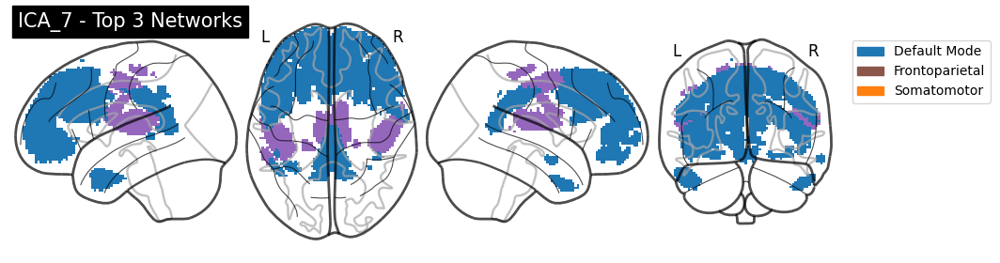

Saved: ./top3_networks_figures/ICA_7_top3.png


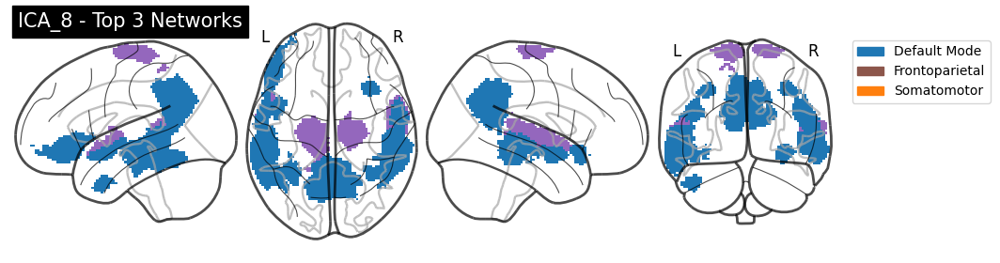

Saved: ./top3_networks_figures/ICA_8_top3.png


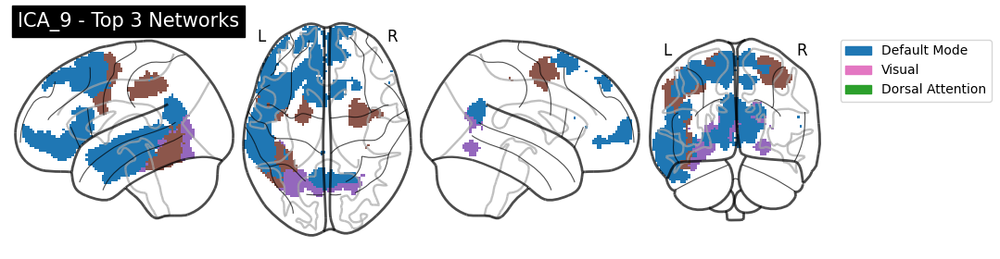

Saved: ./top3_networks_figures/ICA_9_top3.png


In [58]:
import os
import glob
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from nilearn import image, plotting
from nilearn.image import resample_to_img
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# ---------------------------- Paths ---------------------------- #
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_L1_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

figdir = "./top3_networks_figures"
os.makedirs(figdir, exist_ok=True)

# ---------------------- Load ICA components -------------------- #
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# ------------------ Load atlas and labels ---------------------- #
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

network_names = [label.split('_')[2] for label in labels]
unique_networks = list(dict.fromkeys(network_names))  # preserve order
network_id_map = {name: idx + 1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names])

# Map network ID to brain volume
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

# ------------------ Define network colors ---------------------- #
network_ids = list(range(1, 8))
network_labels = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention", 
                  "Limbic", "Frontoparietal", "Default Mode"]
network_colors = [
    "#e377c2",  # pink
    "#ff7f0e",  # orange
    "#2ca02c",  # green
    "#d62728",  # red
    "#9467bd",  # purple
    "#8c564b",  # brown
    "#1f77b4"   # blue
]
custom_cmap = ListedColormap(network_colors)

# --------------------- Compute Overlaps ----------------------- #
results = []

for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    for net_id in network_ids:
        network_voxels = atlas_network_map == net_id
        overlap = np.sum(active_voxels & network_voxels)
        results.append({
            "Component": f"ICA_{comp_idx + 1}",
            "Network_ID": net_id,
            "Network_Name": [k for k, v in network_id_map.items() if v == net_id][0],
            "Overlap_Voxels": overlap
        })

df = pd.DataFrame(results)
df_pivot = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)
df_pivot.to_csv("ica_network_overlap_L1(Individual).csv")

# ----------------- Get Top 3 Networks per ICA ----------------- #
top3_all = []

for component in df_pivot.index:
    top3 = df_pivot.loc[component].sort_values(ascending=False).head(3)
    top3_networks = top3.index.tolist()
    top3_ids = [network_id_map[n] for n in top3_networks]
    top3_all.append((component, top3_networks, top3_ids))

# -------------------- Plot Top 3 Networks --------------------- #
for comp_idx, comp_img in enumerate(ica_imgs):
    component_name, top3_names, top3_ids = top3_all[comp_idx]
    
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Create labeled map with only top 3 networks
    labeled_map = np.zeros_like(comp_data)
    for net_id in top3_ids:
        net_mask = atlas_network_map == net_id
        labeled_map[active_voxels & net_mask] = net_id

    labeled_img = nib.Nifti1Image(labeled_map, affine=atlas_img.affine)

    # Plot
    display = plotting.plot_glass_brain(
        labeled_img, cmap=custom_cmap, display_mode='lzry', colorbar=False,
        title=f"{component_name} - Top 3 Networks"
    )

    # Add legend for only the top 3
    legend_patches = []
    for net_id in top3_ids:
        idx = net_id - 1
        legend_patches.append(mpatches.Patch(color=network_colors[idx], label=network_labels[idx]))

    plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')

    # Save and show
    output_path = os.path.join(figdir, f"{component_name}_top3.png")
    plt.savefig(output_path, bbox_inches='tight', dpi=150)
    plt.show()
    print(f"Saved: {output_path}")

## Top 1

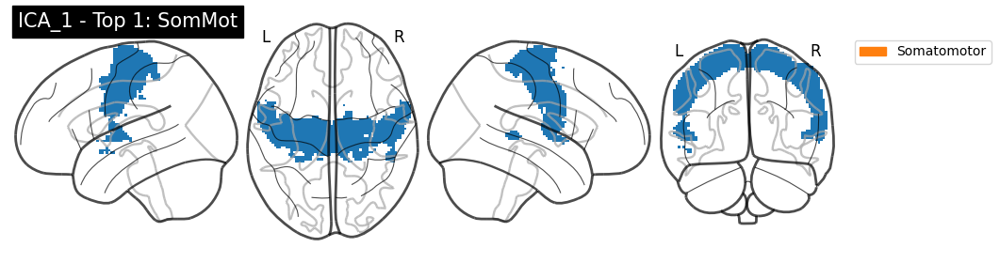

Saved: ./top1_networks_figures/ICA_1_top1.png


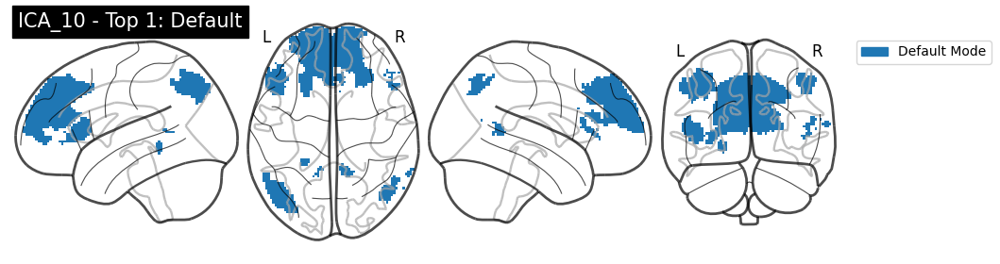

Saved: ./top1_networks_figures/ICA_10_top1.png


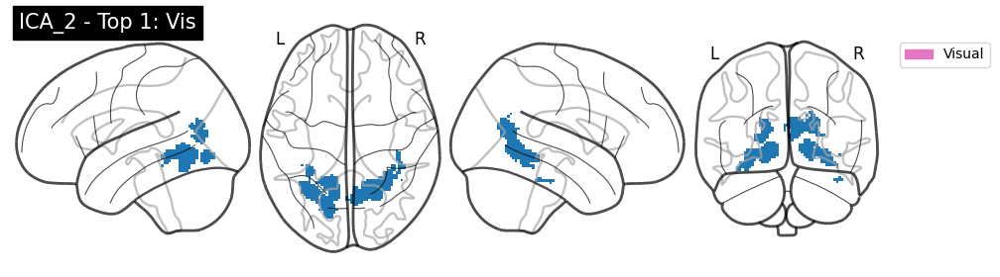

Saved: ./top1_networks_figures/ICA_2_top1.png


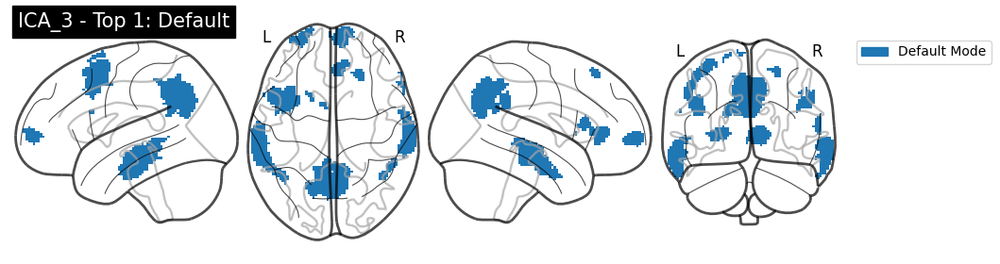

Saved: ./top1_networks_figures/ICA_3_top1.png


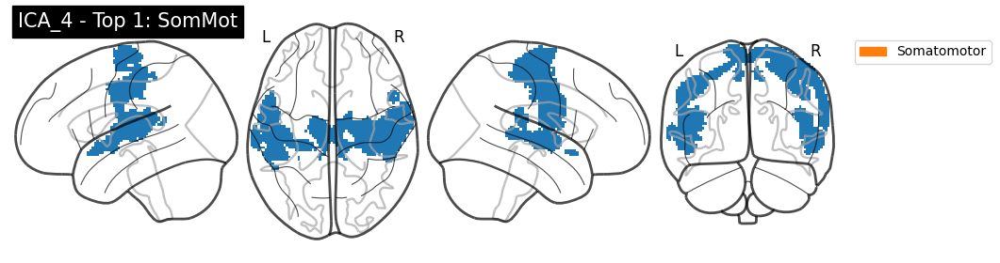

Saved: ./top1_networks_figures/ICA_4_top1.png


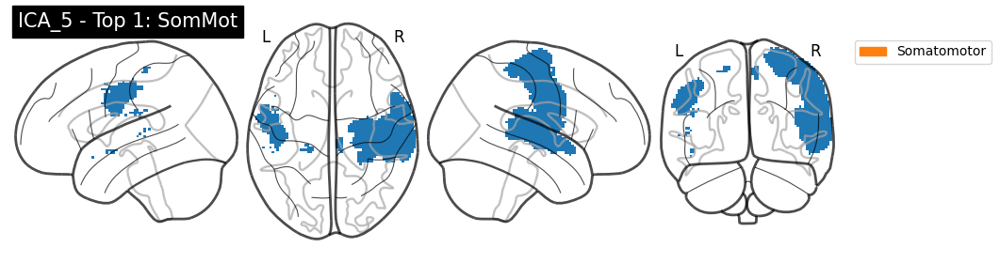

Saved: ./top1_networks_figures/ICA_5_top1.png


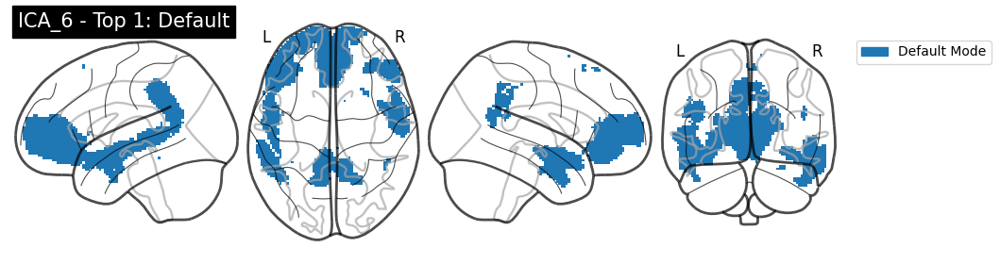

Saved: ./top1_networks_figures/ICA_6_top1.png


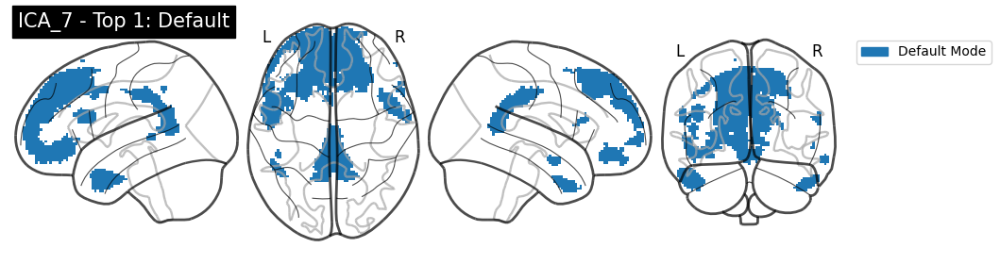

Saved: ./top1_networks_figures/ICA_7_top1.png


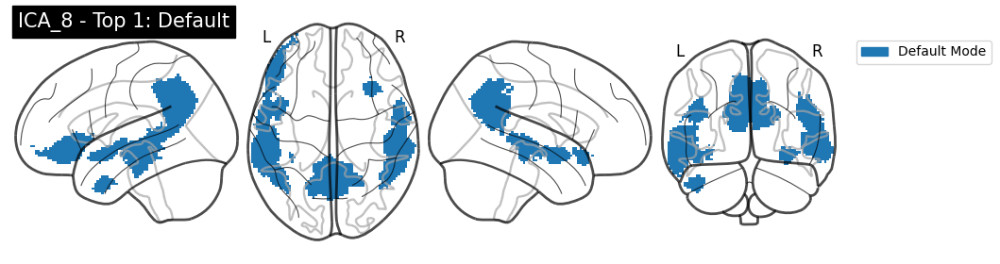

Saved: ./top1_networks_figures/ICA_8_top1.png


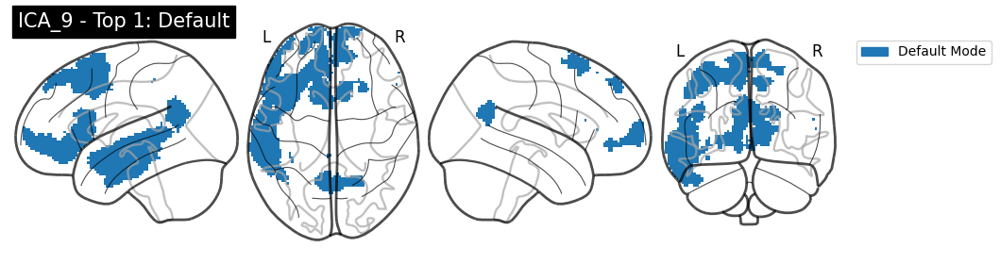

Saved: ./top1_networks_figures/ICA_9_top1.png


In [62]:
import os
import glob
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from nilearn import image, plotting
from nilearn.image import resample_to_img
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# ---------------------------- Paths ---------------------------- #
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_L1_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

figdir = "./top1_networks_figures"
os.makedirs(figdir, exist_ok=True)

# ---------------------- Load ICA components -------------------- #
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# ------------------ Load atlas and labels ---------------------- #
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

network_names = [label.split('_')[2] for label in labels]
unique_networks = list(dict.fromkeys(network_names))  # preserve order
network_id_map = {name: idx + 1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names])

# Map network ID to brain volume
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

# ------------------ Define network colors ---------------------- #
network_ids = list(range(1, 8))
network_labels = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention", 
                  "Limbic", "Frontoparietal", "Default Mode"]
network_colors = [
    "#e377c2",  # pink
    "#ff7f0e",  # orange
    "#2ca02c",  # green
    "#d62728",  # red
    "#9467bd",  # purple
    "#8c564b",  # brown
    "#1f77b4"   # blue
]
custom_cmap = ListedColormap(network_colors)

# --------------------- Compute Overlaps ----------------------- #
results = []

for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    for net_id in network_ids:
        network_voxels = atlas_network_map == net_id
        overlap = np.sum(active_voxels & network_voxels)
        results.append({
            "Component": f"ICA_{comp_idx + 1}",
            "Network_ID": net_id,
            "Network_Name": [k for k, v in network_id_map.items() if v == net_id][0],
            "Overlap_Voxels": overlap
        })

df = pd.DataFrame(results)
df_pivot = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)
df_pivot.to_csv("ica_network_overlap_top1.csv")

# ----------------- Get Top 1 Network per ICA ------------------ #
top1_all = []

for component in df_pivot.index:
    top1 = df_pivot.loc[component].sort_values(ascending=False).head(1)
    top1_network = top1.index[0]
    top1_id = network_id_map[top1_network]
    top1_all.append((component, top1_network, top1_id))

# -------------------- Plot Top 1 Network ---------------------- #
for comp_idx, comp_img in enumerate(ica_imgs):
    component_name, top1_name, top1_id = top1_all[comp_idx]
    
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Create labeled map with only the top 1 network
    labeled_map = np.zeros_like(comp_data)
    net_mask = atlas_network_map == top1_id
    labeled_map[active_voxels & net_mask] = top1_id

    labeled_img = nib.Nifti1Image(labeled_map, affine=atlas_img.affine)

    # Plot
    display = plotting.plot_glass_brain(
        labeled_img, cmap=custom_cmap, display_mode='lzry', colorbar=False,
        title=f"{component_name} - Top 1: {top1_name}"
    )

    # Add legend
    legend_patch = mpatches.Patch(color=network_colors[top1_id - 1], label=network_labels[top1_id - 1])
    plt.legend(handles=[legend_patch], bbox_to_anchor=(1.05, 1), loc='upper left')

    # Save and show
    output_path = os.path.join(figdir, f"{component_name}_top1.png")
    plt.savefig(output_path, bbox_inches='tight', dpi=150)
    plt.show()
    print(f"Saved: {output_path}")

In [35]:
# Load ICA components
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# Load atlas and labels
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# Load and parse network labels
with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

network_names = [label.split('_')[2] for label in labels]
unique_networks = sorted(set(network_names), key=network_names.index)
network_id_map = {name: idx + 1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names])

In [36]:
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

In [37]:
results = []

for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold
    
    for net_id in range(1, 8):
        network_voxels = atlas_network_map == net_id
        overlap = np.sum(active_voxels & network_voxels)
        results.append({
            "Component": f"ICA_{comp_idx + 1}",
            "Network_ID": net_id,
            "Network_Name": [k for k, v in network_id_map.items() if v == net_id][0],
            "Overlap_Voxels": overlap
        })

df = pd.DataFrame(results)
df_pivot = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)
df_pivot.to_csv("ica_network_overlap_Ln(Individual).csv")

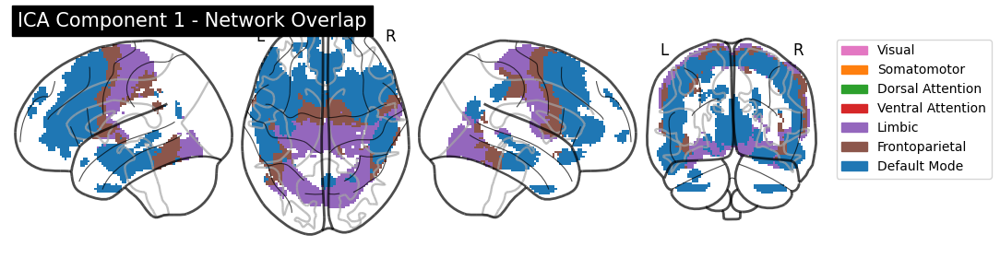

Saved: ./separate_ica_figures_L1/ICA_Component_1_colored.png


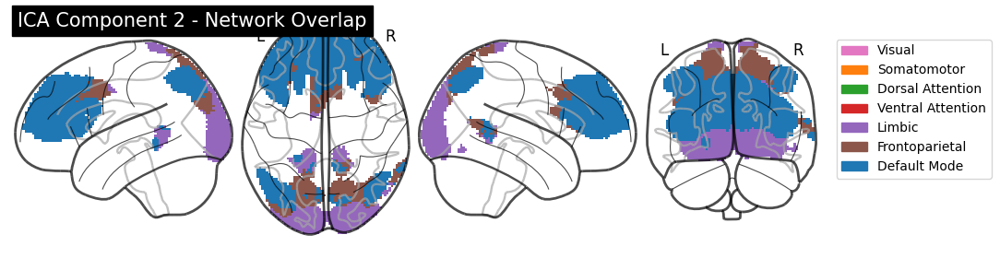

Saved: ./separate_ica_figures_L1/ICA_Component_2_colored.png


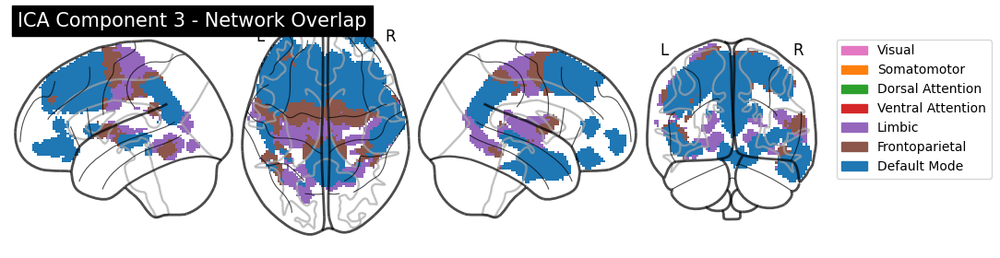

Saved: ./separate_ica_figures_L1/ICA_Component_3_colored.png


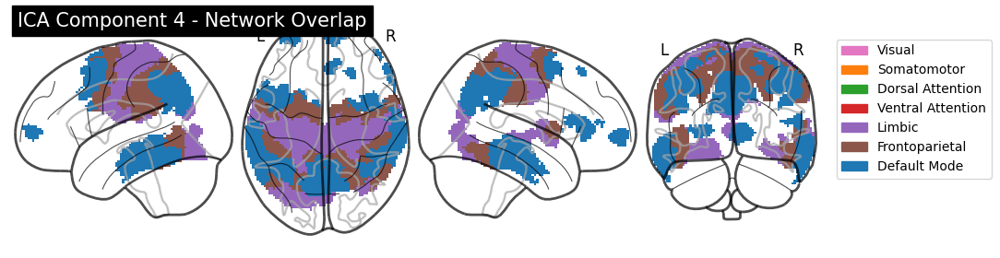

Saved: ./separate_ica_figures_L1/ICA_Component_4_colored.png


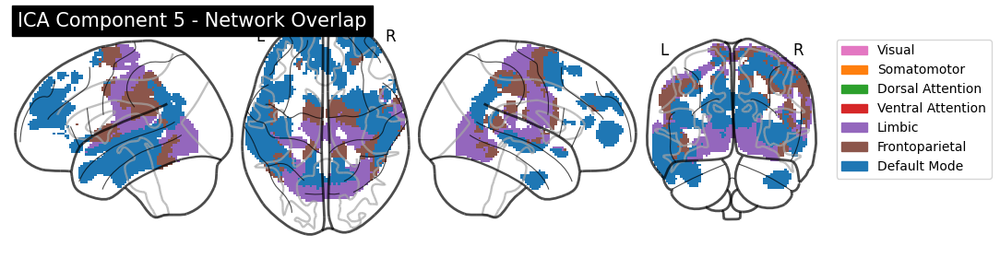

Saved: ./separate_ica_figures_L1/ICA_Component_5_colored.png


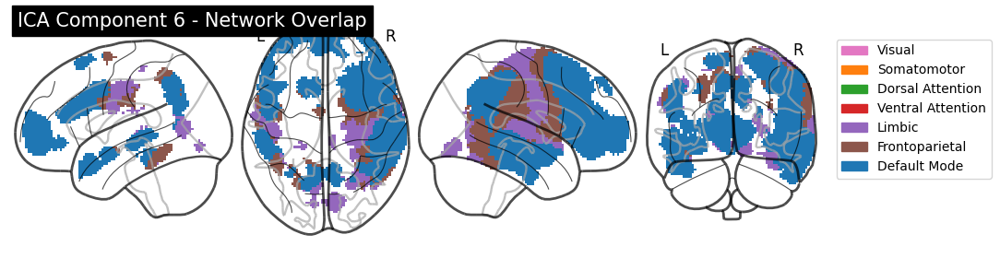

Saved: ./separate_ica_figures_L1/ICA_Component_6_colored.png


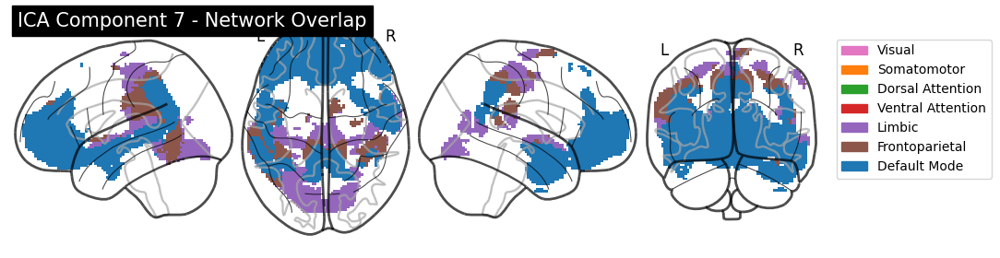

Saved: ./separate_ica_figures_L1/ICA_Component_7_colored.png


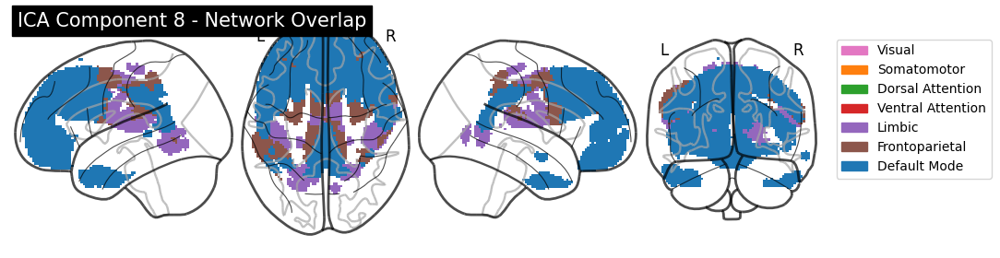

Saved: ./separate_ica_figures_L1/ICA_Component_8_colored.png


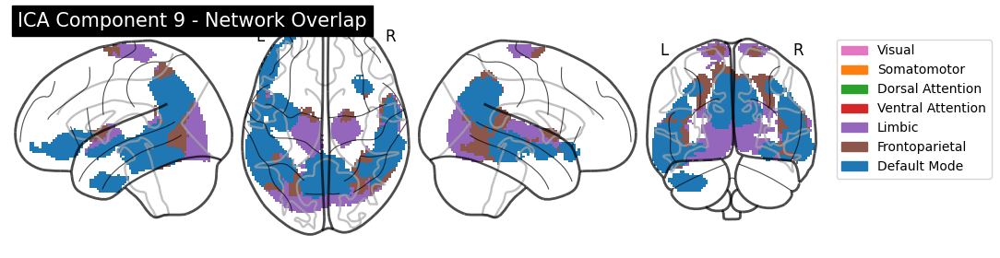

Saved: ./separate_ica_figures_L1/ICA_Component_9_colored.png


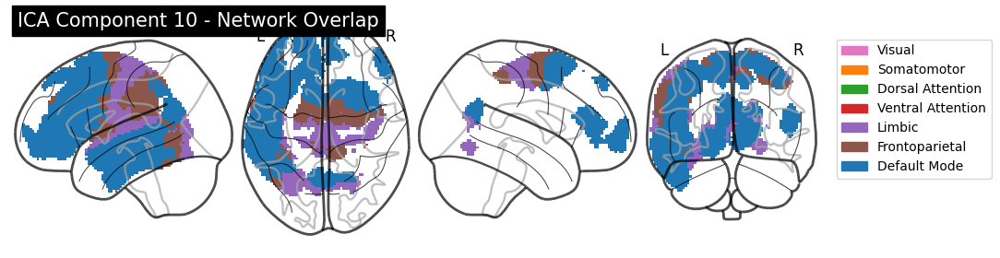

Saved: ./separate_ica_figures_L1/ICA_Component_10_colored.png


In [38]:
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# Define exact order of network IDs and colors
network_ids = [1, 2, 3, 4, 5, 6, 7]
network_names = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                 "Limbic", "Frontoparietal", "Default Mode"]
network_colors = [
    "#e377c2",  # pink
    "#ff7f0e",  # orange
    "#2ca02c",  # green
    "#d62728",  # red
    "#9467bd",  # purple
    "#8c564b",  # brown
    "#1f77b4"   # blue
]
custom_cmap = ListedColormap(network_colors)

# Plotting each ICA component's overlap with networks
for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Build labeled network mask (0 = background, others = network ID)
    labeled_map = np.zeros_like(comp_data)
    for net_id in network_ids:
        net_mask = (atlas_network_map == net_id)
        labeled_map[active_voxels & net_mask] = net_id

    labeled_img = nib.Nifti1Image(labeled_map, affine=atlas_img.affine)

    # Display & Save
    display = plotting.plot_glass_brain(
        labeled_img, cmap=custom_cmap, display_mode='lzry', colorbar=False,
        title=f"ICA Component {comp_idx + 1} - Network Overlap"
    )

    # Add custom legend
    legend_patches = [mpatches.Patch(color=network_colors[i], label=network_names[i]) for i in range(len(network_ids))]
    plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Save to file
    output_path = os.path.join(figdir, f"ICA_Component_{comp_idx + 1}_colored.png")
    plt.savefig(output_path, bbox_inches='tight', dpi=150)
    plt.show()
    print(f"Saved: {output_path}")

### Ln

In [40]:
import os
import glob
import numpy as np
import nibabel as nib
import pandas as pd
import matplotlib.pyplot as plt
from nilearn import image, masking, plotting
from nilearn.image import resample_to_img
from matplotlib.colors import ListedColormap

# Paths
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_Ln_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

# Output directory for individual ICA figures
figdir = "./separate_ica_figures"
os.makedirs(figdir, exist_ok=True)

In [41]:
# Load ICA components
ica_files = sorted(glob.glob(os.path.join(ica_dir, "ica_component_*.nii.gz")))
ica_imgs = [nib.load(f) for f in ica_files]

# Load atlas and labels
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# Load and parse network labels
with open(labels_path, 'r') as f:
    labels = f.read().splitlines()

network_names = [label.split('_')[2] for label in labels]
unique_networks = sorted(set(network_names), key=network_names.index)
network_id_map = {name: idx + 1 for idx, name in enumerate(unique_networks)}
parcel_network_ids = np.array([network_id_map[n] for n in network_names])

In [42]:
atlas_network_map = np.zeros_like(atlas_data)
for parcel_idx in range(1, 1001):
    atlas_network_map[atlas_data == parcel_idx] = parcel_network_ids[parcel_idx - 1]

In [43]:
results = []

for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold
    
    for net_id in range(1, 8):
        network_voxels = atlas_network_map == net_id
        overlap = np.sum(active_voxels & network_voxels)
        results.append({
            "Component": f"ICA_{comp_idx + 1}",
            "Network_ID": net_id,
            "Network_Name": [k for k, v in network_id_map.items() if v == net_id][0],
            "Overlap_Voxels": overlap
        })

df = pd.DataFrame(results)
df_pivot = df.pivot(index="Component", columns="Network_Name", values="Overlap_Voxels").fillna(0)
df_pivot.to_csv("ica_network_overlap.csv")

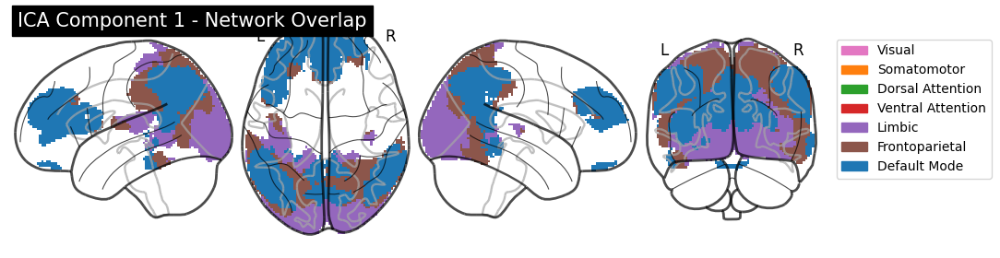

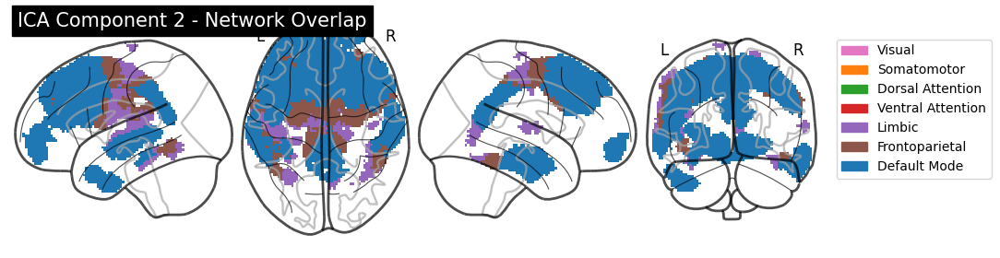

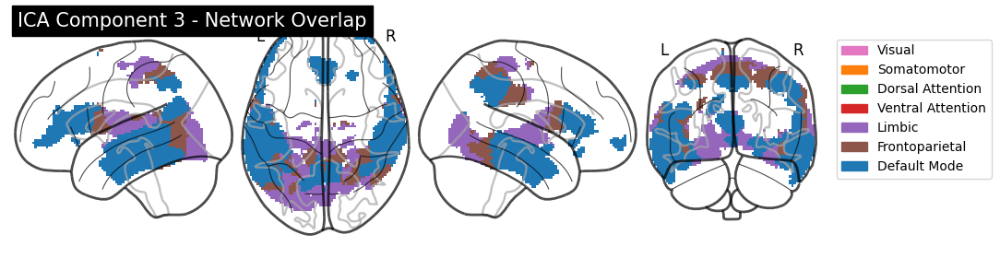

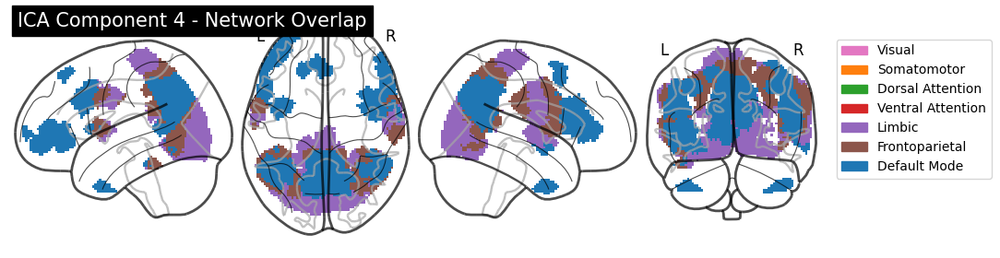

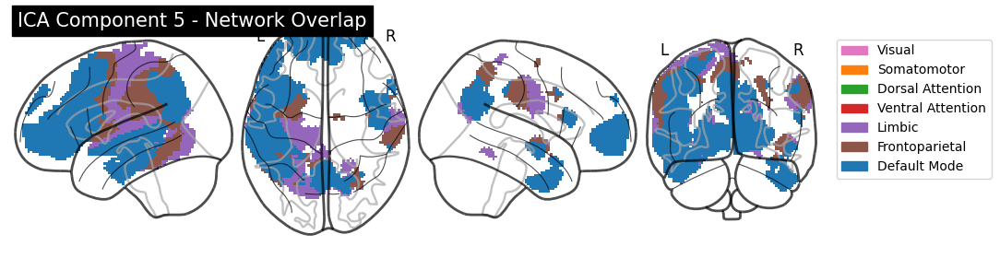

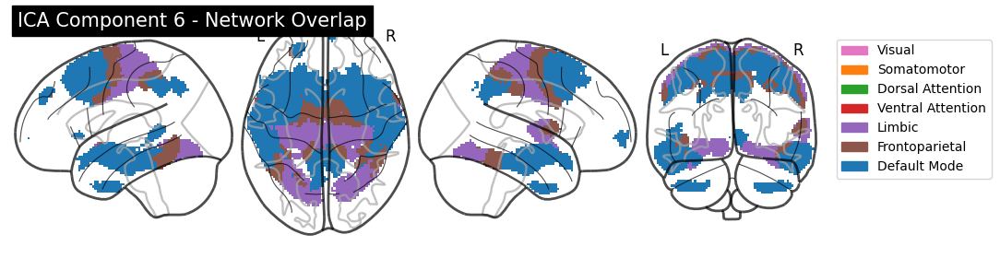

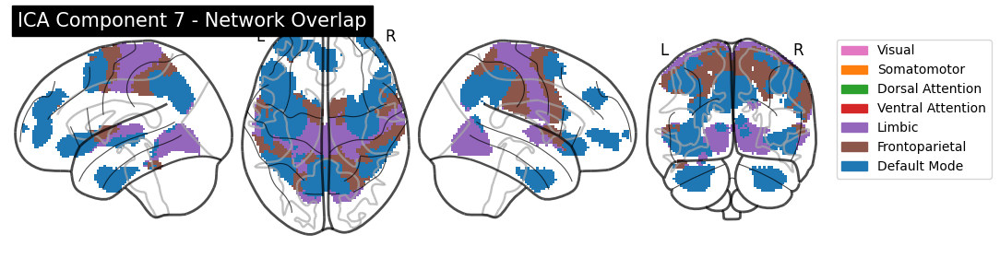

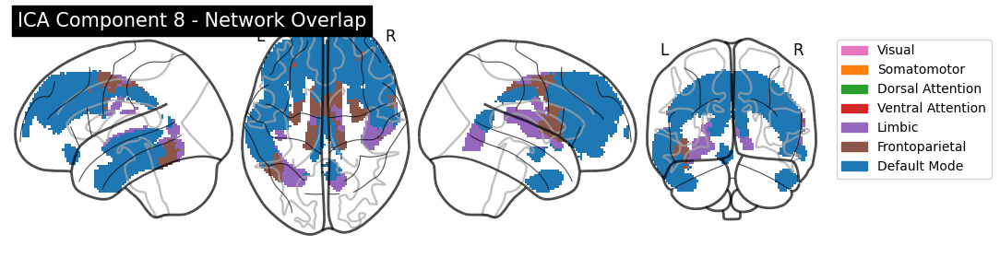

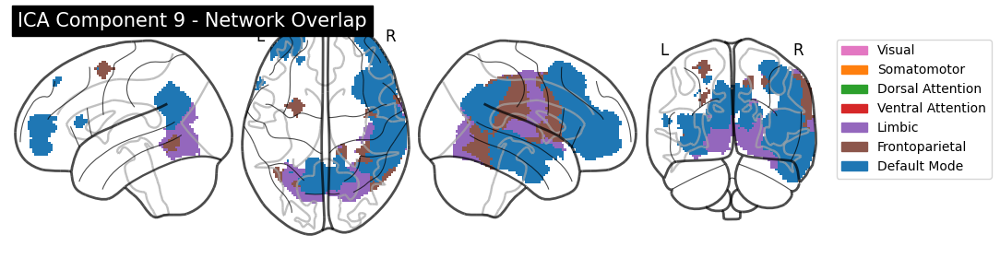

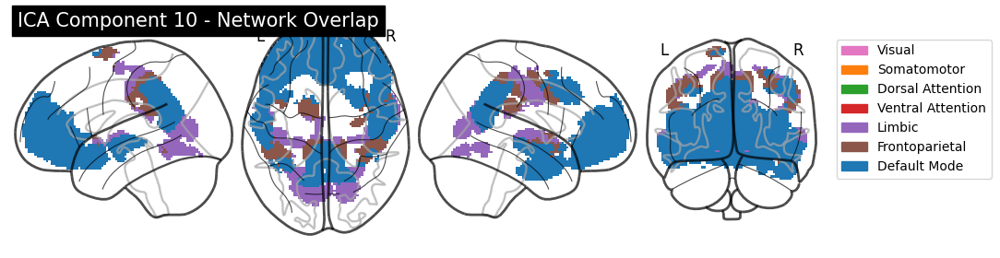

In [47]:
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# Define exact order of network IDs and colors
network_ids = [1, 2, 3, 4, 5, 6, 7]
network_names = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                 "Limbic", "Frontoparietal", "Default Mode"]
network_colors = [
    "#e377c2",  # pink
    "#ff7f0e",  # orange
    "#2ca02c",  # green
    "#d62728",  # red
    "#9467bd",  # purple
    "#8c564b",  # brown
    "#1f77b4"   # blue
]
custom_cmap = ListedColormap(network_colors)

# Plotting each ICA component's overlap with networks
for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Build labeled network mask (0 = background, others = network ID)
    labeled_map = np.zeros_like(comp_data)
    for net_id in network_ids:
        net_mask = (atlas_network_map == net_id)
        labeled_map[active_voxels & net_mask] = net_id

    labeled_img = nib.Nifti1Image(labeled_map, affine=atlas_img.affine)

    # Display & Save
    display = plotting.plot_glass_brain(
        labeled_img, cmap=custom_cmap, display_mode='lzry', colorbar=False,
        title=f"ICA Component {comp_idx + 1} - Network Overlap"
    )

    # Add custom legend
    legend_patches = [mpatches.Patch(color=network_colors[i], label=network_names[i]) for i in range(len(network_ids))]
    plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')
    
    # Save to file
    #output_path = os.path.join(figdir, f"ICA_Component_{comp_idx + 1}_colored.png")
    #plt.savefig(output_path, bbox_inches='tight', dpi=150)
    #plt.show()
    #print(f"Saved: {output_path}")

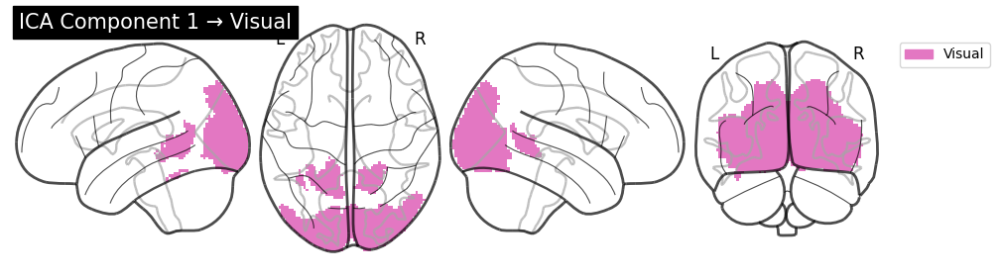

Saved: ./separate_ica_figures/ICA_Component_1_Dominant_Visual.png


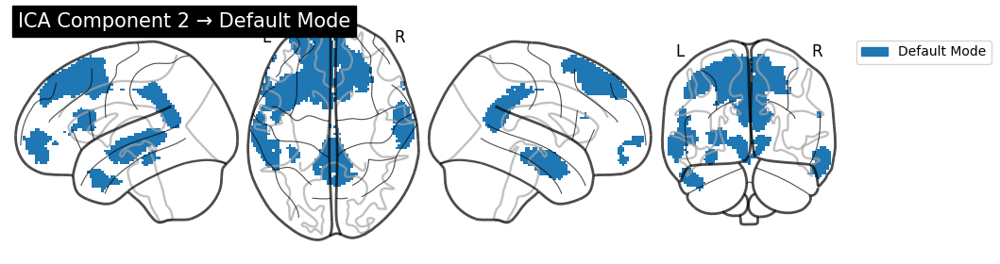

Saved: ./separate_ica_figures/ICA_Component_2_Dominant_Default Mode.png


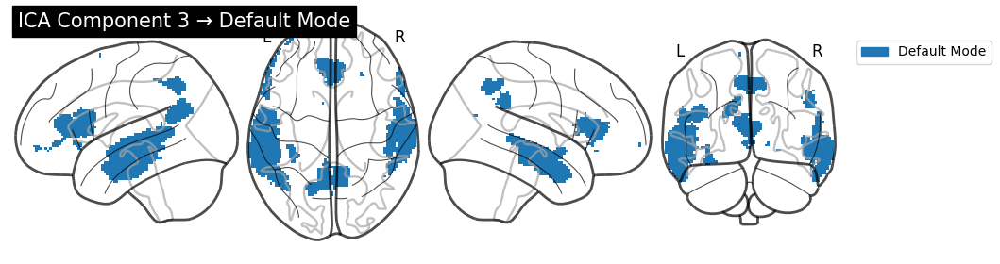

Saved: ./separate_ica_figures/ICA_Component_3_Dominant_Default Mode.png


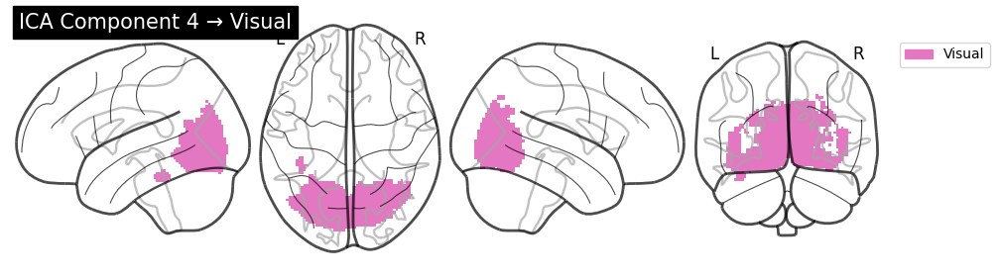

Saved: ./separate_ica_figures/ICA_Component_4_Dominant_Visual.png


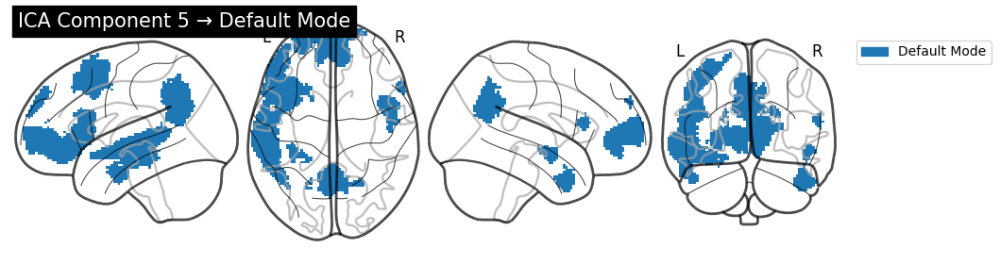

Saved: ./separate_ica_figures/ICA_Component_5_Dominant_Default Mode.png


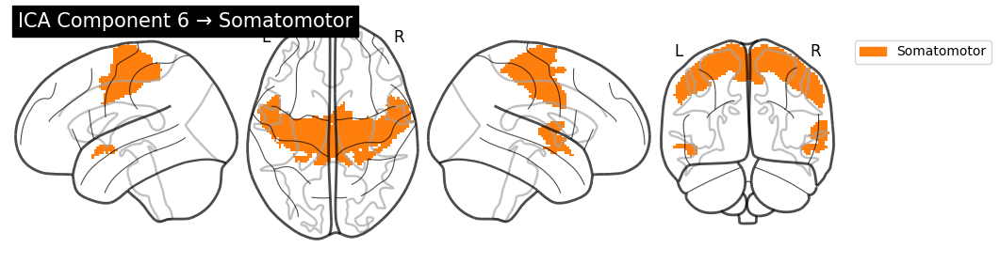

Saved: ./separate_ica_figures/ICA_Component_6_Dominant_Somatomotor.png


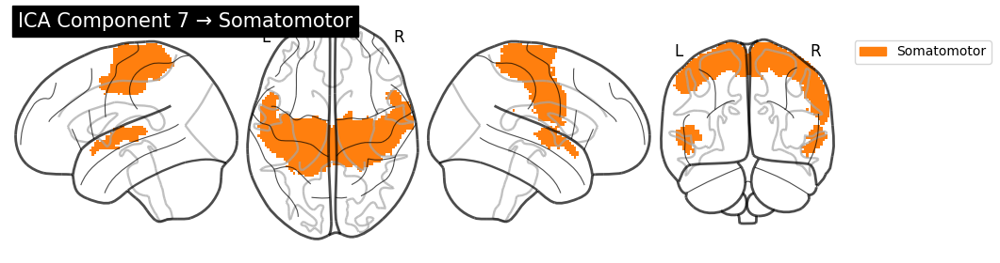

Saved: ./separate_ica_figures/ICA_Component_7_Dominant_Somatomotor.png


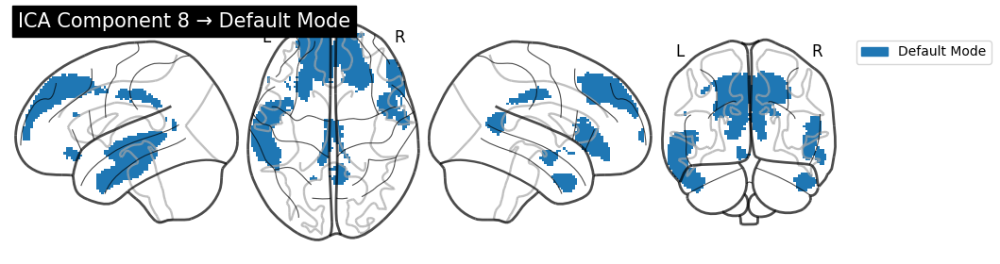

Saved: ./separate_ica_figures/ICA_Component_8_Dominant_Default Mode.png


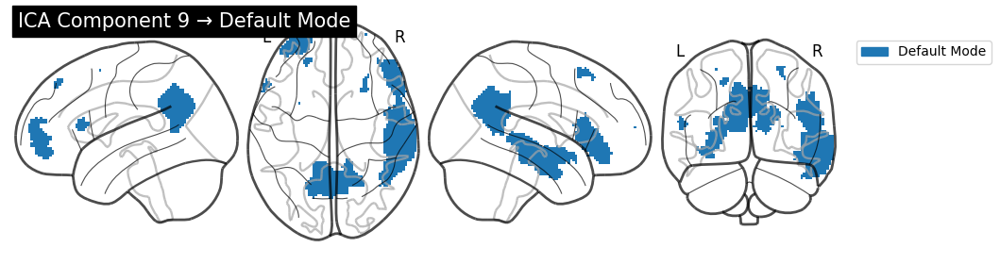

Saved: ./separate_ica_figures/ICA_Component_9_Dominant_Default Mode.png


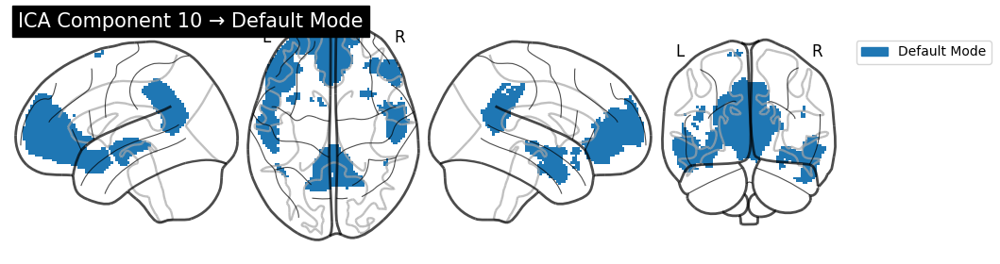

Saved: ./separate_ica_figures/ICA_Component_10_Dominant_Default Mode.png


In [48]:
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# Setup
network_ids = [1, 2, 3, 4, 5, 6, 7]
network_names = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                 "Limbic", "Frontoparietal", "Default Mode"]
network_colors = [
    "#e377c2",  # pink
    "#ff7f0e",  # orange
    "#2ca02c",  # green
    "#d62728",  # red
    "#9467bd",  # purple
    "#8c564b",  # brown
    "#1f77b4"   # blue
]
custom_cmap = ListedColormap(network_colors)

# Create lookup: ID → (name, color)
network_lookup = {nid: (name, color) for nid, name, color in zip(network_ids, network_names, network_colors)}

# Process each ICA component
for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    
    # Threshold: focus on strongest voxels
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Determine overlap with each network
    overlap_counts = []
    for net_id in network_ids:
        net_mask = atlas_network_map == net_id
        overlap = np.sum(active_voxels & net_mask)
        overlap_counts.append(overlap)

    # Find dominant network
    dominant_network_index = np.argmax(overlap_counts)
    dominant_net_id = network_ids[dominant_network_index]
    dominant_net_name, dominant_net_color = network_lookup[dominant_net_id]

    # Create labeled map for that network only
    labeled_map = np.zeros_like(comp_data)
    labeled_map[active_voxels & (atlas_network_map == dominant_net_id)] = dominant_net_id
    labeled_img = nib.Nifti1Image(labeled_map, affine=atlas_img.affine)

    # Plot it
    display = plotting.plot_glass_brain(
        labeled_img, cmap=ListedColormap([dominant_net_color]), display_mode='lzry',
        colorbar=False, title=f"ICA Component {comp_idx + 1} → {dominant_net_name}"
    )

    # Add legend for this one component
    legend_patch = mpatches.Patch(color=dominant_net_color, label=dominant_net_name)
    plt.legend(handles=[legend_patch], bbox_to_anchor=(1.05, 1), loc='upper left')

    # Save to file
    output_path = os.path.join(figdir, f"ICA_Component_{comp_idx + 1}_Dominant_{dominant_net_name}.png")
    plt.savefig(output_path, bbox_inches='tight', dpi=150)
    plt.show()
    print(f"Saved: {output_path}")

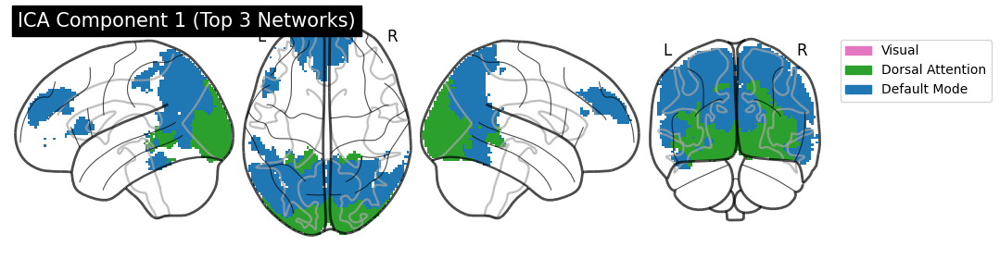

Saved: ./separate_ica_figures/ICA_Component_1_Top3Networks.png


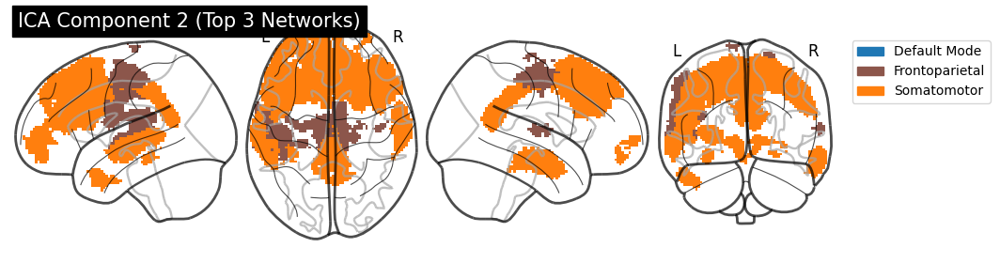

Saved: ./separate_ica_figures/ICA_Component_2_Top3Networks.png


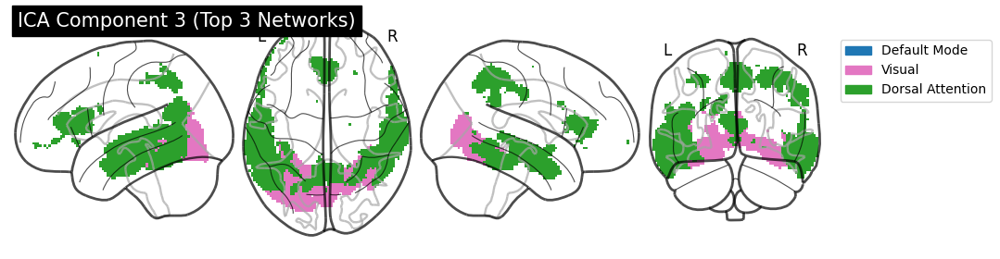

Saved: ./separate_ica_figures/ICA_Component_3_Top3Networks.png


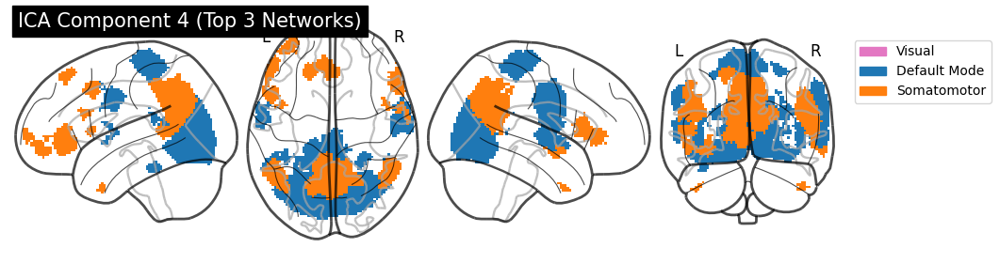

Saved: ./separate_ica_figures/ICA_Component_4_Top3Networks.png


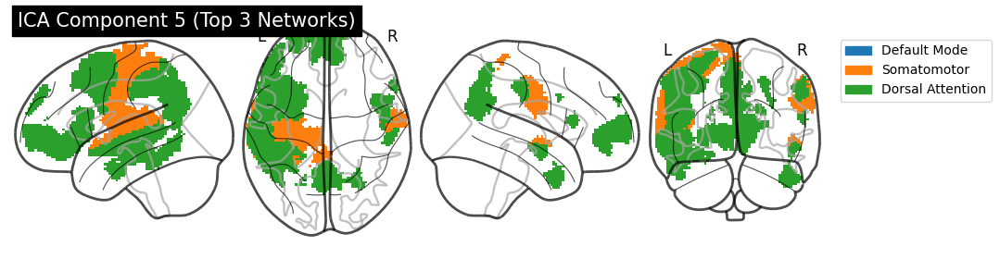

Saved: ./separate_ica_figures/ICA_Component_5_Top3Networks.png


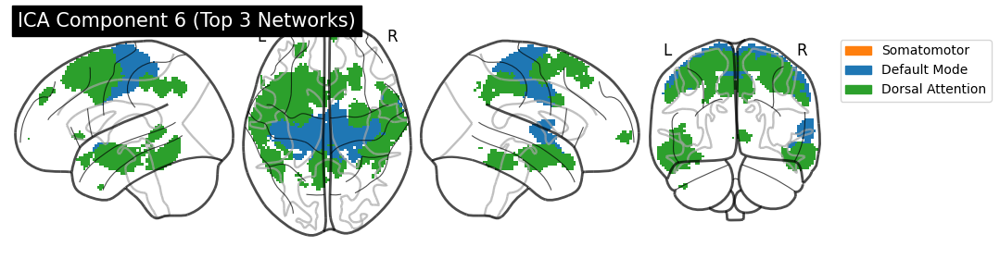

Saved: ./separate_ica_figures/ICA_Component_6_Top3Networks.png


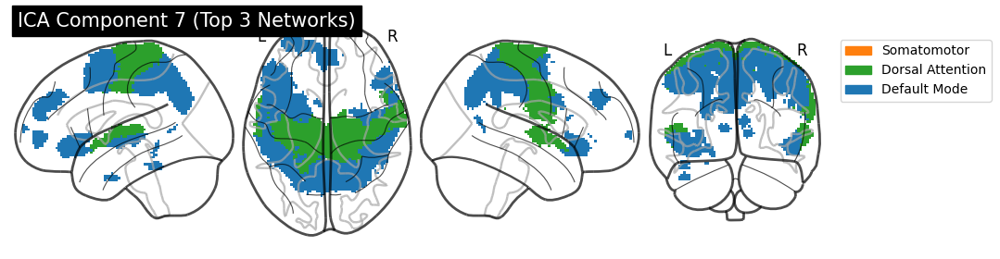

Saved: ./separate_ica_figures/ICA_Component_7_Top3Networks.png


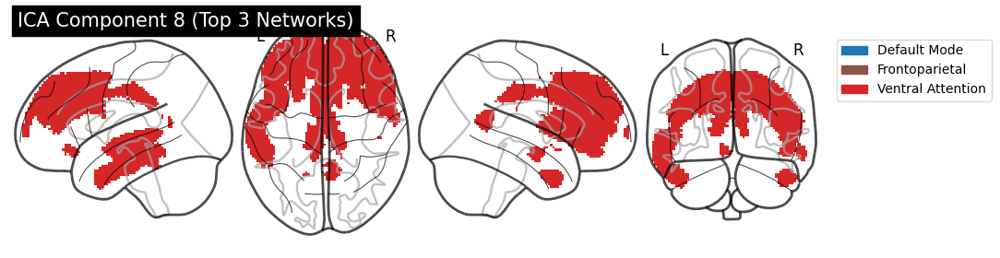

Saved: ./separate_ica_figures/ICA_Component_8_Top3Networks.png


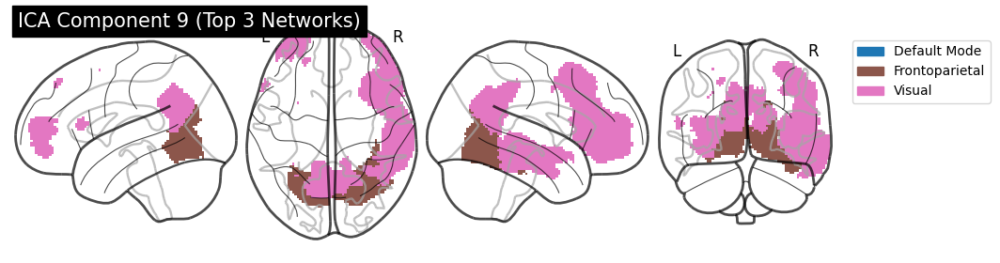

Saved: ./separate_ica_figures/ICA_Component_9_Top3Networks.png


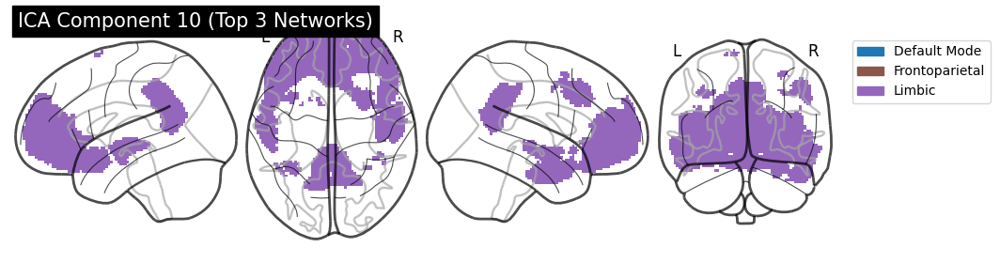

Saved: ./separate_ica_figures/ICA_Component_10_Top3Networks.png


In [49]:
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches

# Setup
network_ids = [1, 2, 3, 4, 5, 6, 7]
network_names = ["Visual", "Somatomotor", "Dorsal Attention", "Ventral Attention",
                 "Limbic", "Frontoparietal", "Default Mode"]
network_colors = [
    "#e377c2",  # pink
    "#ff7f0e",  # orange
    "#2ca02c",  # green
    "#d62728",  # red
    "#9467bd",  # purple
    "#8c564b",  # brown
    "#1f77b4"   # blue
]
custom_cmap = ListedColormap(network_colors)

# Create mapping: network_id → (name, color)
network_lookup = {nid: (name, color) for nid, name, color in zip(network_ids, network_names, network_colors)}

# Start visualization
for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()
    
    # Threshold top 5% voxels in absolute value
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Compute overlap with each network
    overlap_counts = []
    for net_id in network_ids:
        net_mask = atlas_network_map == net_id
        overlap = np.sum(active_voxels & net_mask)
        overlap_counts.append((net_id, overlap))

    # Select top 3 overlapping networks
    top_3 = sorted(overlap_counts, key=lambda x: x[1], reverse=True)[:3]
    top_net_ids = [net_id for net_id, _ in top_3]

    # Build a labeled map with top 3 network IDs
    labeled_map = np.zeros_like(comp_data)
    for net_id in top_net_ids:
        labeled_map[active_voxels & (atlas_network_map == net_id)] = net_id
    labeled_img = nib.Nifti1Image(labeled_map, affine=atlas_img.affine)

    # Create color map with only the top 3 colors (matched by ID)
    color_indices = [network_ids.index(nid) for nid in top_net_ids]
    cmap_colors = [network_colors[i] for i in color_indices]
    cmap_top3 = ListedColormap(cmap_colors)

    # Plot the glass brain
    display = plotting.plot_glass_brain(
        labeled_img, cmap=cmap_top3, display_mode='lzry',
        colorbar=False, title=f"ICA Component {comp_idx + 1} (Top 3 Networks)"
    )

    # Add legend
    legend_patches = [mpatches.Patch(color=network_colors[network_ids.index(nid)],
                                      label=network_names[network_ids.index(nid)])
                      for nid in top_net_ids]
    plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')

    # Save figure
    filename = f"ICA_Component_{comp_idx + 1}_Top3Networks.png"
    filepath = os.path.join(figdir, filename)
    plt.savefig(filepath, bbox_inches='tight', dpi=150)
    plt.show()
    print(f"Saved: {filepath}")

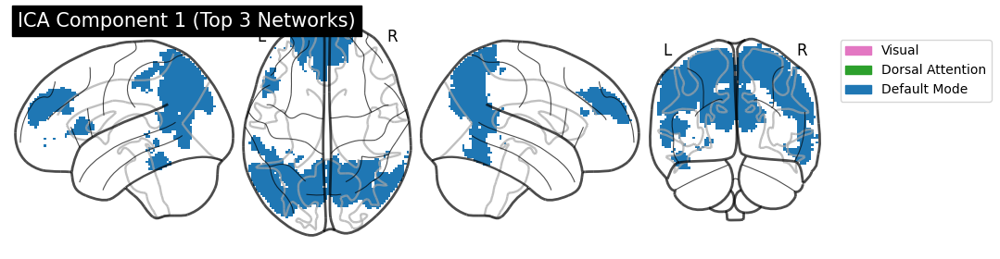

Saved: ./separate_ica_figures/ICA_Component_1_Top3Networks.png


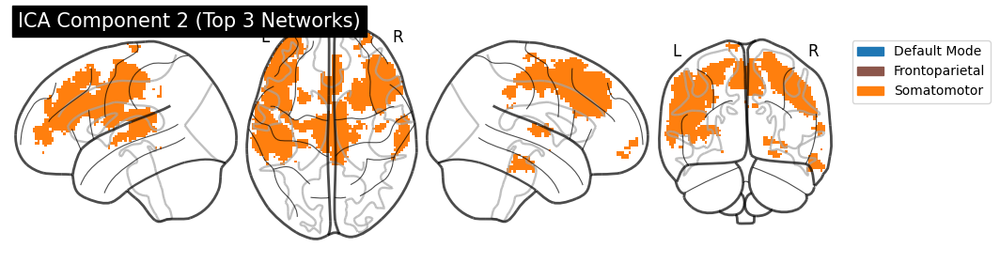

Saved: ./separate_ica_figures/ICA_Component_2_Top3Networks.png


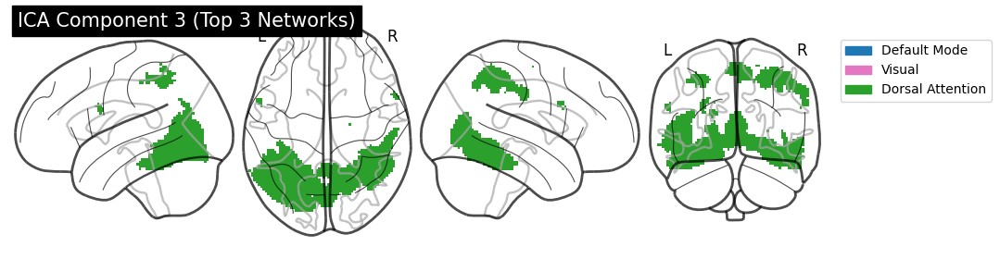

Saved: ./separate_ica_figures/ICA_Component_3_Top3Networks.png


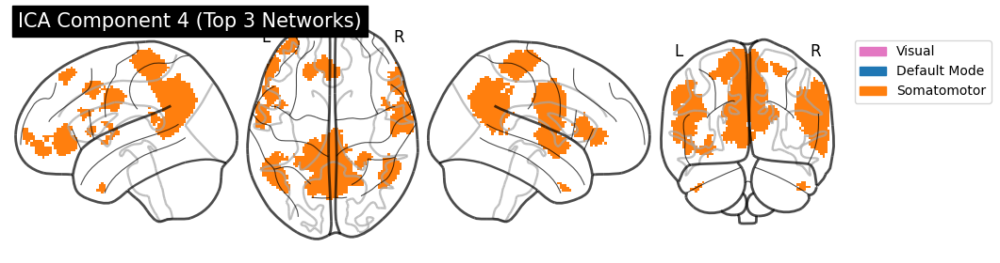

Saved: ./separate_ica_figures/ICA_Component_4_Top3Networks.png


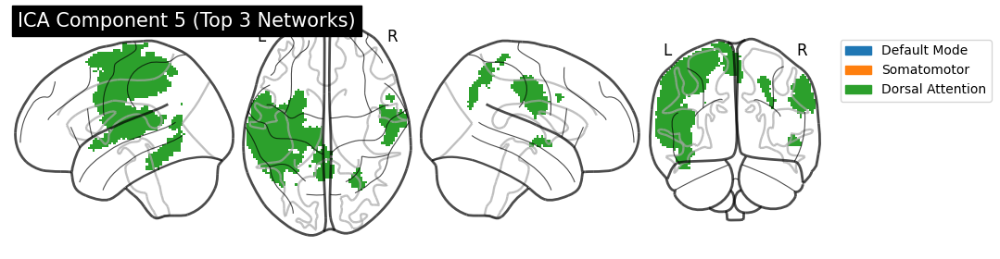

Saved: ./separate_ica_figures/ICA_Component_5_Top3Networks.png


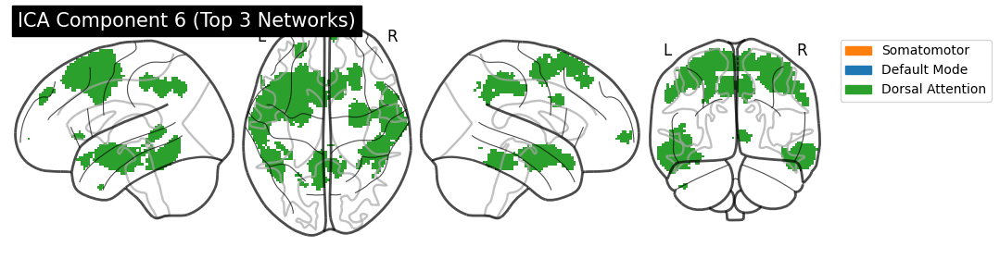

Saved: ./separate_ica_figures/ICA_Component_6_Top3Networks.png


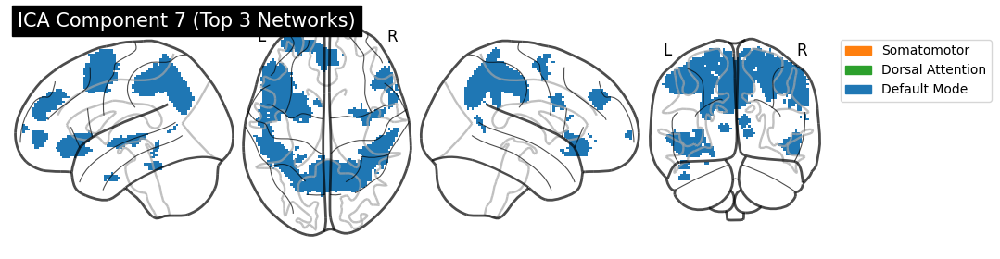

Saved: ./separate_ica_figures/ICA_Component_7_Top3Networks.png


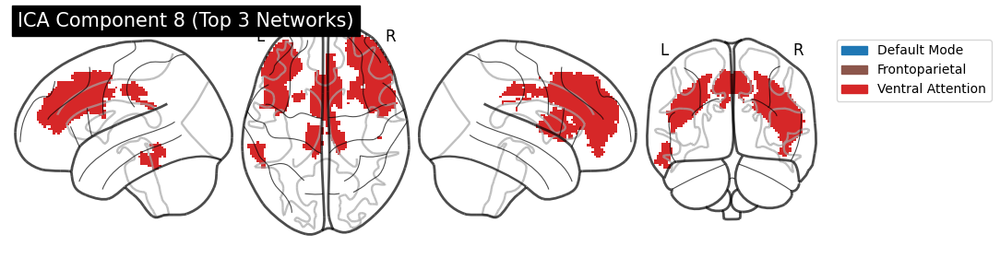

Saved: ./separate_ica_figures/ICA_Component_8_Top3Networks.png


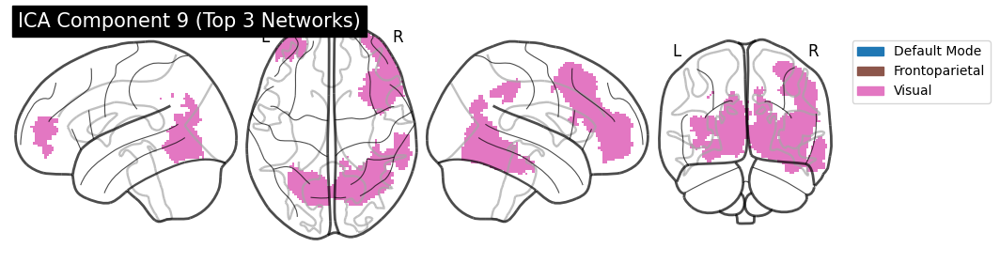

Saved: ./separate_ica_figures/ICA_Component_9_Top3Networks.png


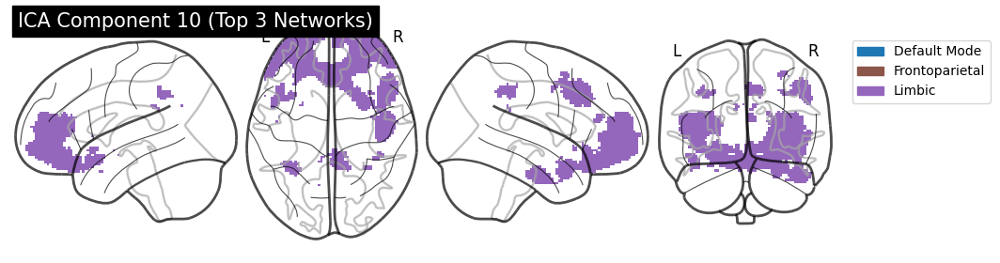

Saved: ./separate_ica_figures/ICA_Component_10_Top3Networks.png


In [50]:
for comp_idx, comp_img in enumerate(ica_imgs):
    resampled_img = resample_to_img(comp_img, atlas_img, interpolation='continuous')
    comp_data = resampled_img.get_fdata()

    # Top 5% threshold
    threshold = np.percentile(np.abs(comp_data), 95)
    active_voxels = np.abs(comp_data) >= threshold

    # Count overlaps with all 7 networks
    overlap_counts = []
    for net_id in network_ids:
        net_mask = atlas_network_map == net_id
        overlap = np.sum(active_voxels & net_mask)
        overlap_counts.append((net_id, overlap))

    # Pick top 3 overlapping network IDs
    top_3 = sorted(overlap_counts, key=lambda x: x[1], reverse=True)[:3]
    top_net_ids = [net_id for net_id, _ in top_3]

    # Remap to 0,1,2 for colormap indexing
    labeled_map = np.zeros_like(comp_data)
    for idx, net_id in enumerate(top_net_ids):
        net_mask = atlas_network_map == net_id
        labeled_map[active_voxels & net_mask] = idx  # <-- Important fix here
    labeled_img = nib.Nifti1Image(labeled_map, affine=atlas_img.affine)

    # Subset of 3 colors for the 3 selected networks
    cmap_top3 = ListedColormap([network_colors[network_ids.index(nid)] for nid in top_net_ids])

    # Plot
    display = plotting.plot_glass_brain(
        labeled_img, cmap=cmap_top3, display_mode='lzry',
        colorbar=False, title=f"ICA Component {comp_idx + 1} (Top 3 Networks)"
    )

    # Correct legend using matching labels
    legend_patches = [mpatches.Patch(color=network_colors[network_ids.index(nid)],
                                      label=network_names[network_ids.index(nid)])
                      for nid in top_net_ids]
    plt.legend(handles=legend_patches, bbox_to_anchor=(1.05, 1), loc='upper left')

    # Save and show
    filename = f"ICA_Component_{comp_idx + 1}_Top3Networks.png"
    filepath = os.path.join(figdir, filename)
    plt.savefig(filepath, bbox_inches='tight', dpi=150)
    plt.show()
    print(f"Saved: {filepath}")

## Quantify Overlaps and Volumes of ICA Components by Network

This quantifies how much each ICA component overlaps with each Schaefer 7-network parcellation region.

Ln

In [8]:
import os
import nibabel as nib
import numpy as np
import pandas as pd
from nilearn.image import resample_to_img

# Paths
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_Ln_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

# Load atlas
atlas_img = nib.load(atlas_path)
atlas_data = atlas_img.get_fdata()

# Load first ICA component to use as target reference image
sample_ica_path = os.path.join(ica_dir, sorted(os.listdir(ica_dir))[0])
ica_ref_img = nib.load(sample_ica_path)

# Resample atlas to match ICA image shape and affine
atlas_img_resampled = resample_to_img(atlas_img, target_img=ica_ref_img, interpolation='nearest')
atlas_data = atlas_img_resampled.get_fdata()

# Load Schaefer labels
with open(labels_path, 'r') as f:
    label_lines = f.readlines()

# Parse network label names from Schaefer text file
parcel_networks = [line.strip().split(',')[-1] for line in label_lines]  # Last entry is network
parcel_networks = np.array(parcel_networks)

# Get unique network names
unique_networks = sorted(set(parcel_networks))

# Create a map: parcel index -> network name
parcel_to_network = {i + 1: net for i, net in enumerate(parcel_networks)}  # Schaefer labels start at 1

# Build reverse: network -> list of parcel indices
network_parcels = {net: [] for net in unique_networks}
for idx, net in parcel_to_network.items():
    network_parcels[net].append(idx)

# Loop over ICA components
results = []

for file in sorted(os.listdir(ica_dir)):
    if file.endswith('.nii') or file.endswith('.nii.gz'):
        ica_path = os.path.join(ica_dir, file)
        ica_img = nib.load(ica_path)
        ica_data = ica_img.get_fdata()

        # Threshold ICA to binary mask (you can adjust threshold)
        binary_ica = (ica_data > np.percentile(ica_data, 95)).astype(int)
        
        ##  only the top 5% most active voxels in each ICA map, creating a binary mask (1 = active, 0 = inactive).

        component_result = {"Component": file}

        for network in unique_networks:
            # Build binary mask of the network
            parcel_indices = network_parcels[network]
            network_mask = np.isin(atlas_data, parcel_indices).astype(int)

            # Overlap
            overlap_voxels = np.sum(binary_ica * network_mask)
            total_network_voxels = np.sum(network_mask)

            percent_overlap = 100 * overlap_voxels / total_network_voxels if total_network_voxels > 0 else 0
            component_result[network] = round(percent_overlap, 2)

        results.append(component_result)

# Convert to DataFrame and display
df = pd.DataFrame(results)
print(df)
df.to_csv("ica_network_overlap_Ln.csv", index=False)

                 Component  1\t7Networks_LH_Vis_1\t120\t14\t127\t0  \
0   ica_component_1.nii.gz                                     0.0   
1  ica_component_10.nii.gz                                     0.0   
2   ica_component_2.nii.gz                                     0.0   
3   ica_component_3.nii.gz                                     0.0   
4   ica_component_4.nii.gz                                    63.3   
5   ica_component_5.nii.gz                                     0.0   
6   ica_component_6.nii.gz                                     0.0   
7   ica_component_7.nii.gz                                     0.0   
8   ica_component_8.nii.gz                                     0.0   
9   ica_component_9.nii.gz                                     0.0   

   10\t7Networks_LH_Vis_10\t120\t15\t128\t0  \
0                                      0.00   
1                                      0.00   
2                                     55.38   
3                                      6.

In [18]:
import os
import nibabel as nib
import numpy as np
import pandas as pd
from nilearn.image import resample_to_img

# Paths
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_Ln_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"
labels_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

# Load atlas
atlas_img = nib.load(atlas_path)
atlas_data = nib.load(atlas_path).get_fdata()

# Reference image (to match dimensions)
sample_ica_path = os.path.join(ica_dir, sorted(os.listdir(ica_dir))[0])
ica_ref_img = nib.load(sample_ica_path)

# Resample atlas to match ICA image
atlas_img_resampled = resample_to_img(atlas_img, target_img=ica_ref_img, interpolation='nearest')
atlas_data = atlas_img_resampled.get_fdata()

# Main network names to track
main_networks = ['Vis', 'SomMot', 'DorsAttn', 'SalVentAttn', 'Limbic', 'Cont', 'Default']

# Load and simplify labels
with open(labels_path, 'r') as f:
    lines = f.readlines()

# Extract just the network name prefix
parcel_networks = []
for line in lines:
    parts = line.strip().split()
    label = parts[1]
    for net in main_networks:
        if net in label:
            parcel_networks.append(net)
            break
    else:
        parcel_networks.append("Unknown")

parcel_networks = np.array(parcel_networks)
assert len(parcel_networks) == 1000, f"Expected 1000 parcels, got {len(parcel_networks)}"

# Build mapping from parcels (1-based) to 7 networks
parcel_to_network = {i + 1: parcel_networks[i] for i in range(len(parcel_networks))}

# Reverse map: network -> list of parcel indices
network_parcels = {net: [] for net in main_networks}
for parcel_idx, net in parcel_to_network.items():
    if net in network_parcels:
        network_parcels[net].append(parcel_idx)

# Loop over ICA components
results = []

for file in sorted(os.listdir(ica_dir)):
    if file.endswith('.nii') or file.endswith('.nii.gz'):
        ica_path = os.path.join(ica_dir, file)
        ica_img = nib.load(ica_path)
        ica_data = ica_img.get_fdata()

        # Threshold: top 5%
        binary_ica = (ica_data > np.percentile(ica_data, 95)).astype(int)

        component_result = {"Component": file}

        for network in main_networks:
            parcel_indices = network_parcels[network]
            network_mask = np.isin(atlas_data, parcel_indices).astype(int)

            overlap_voxels = np.sum(binary_ica * network_mask)
            total_network_voxels = np.sum(network_mask)

            percent_overlap = 100 * overlap_voxels / total_network_voxels if total_network_voxels > 0 else 0
            component_result[network] = round(percent_overlap, 2)

        results.append(component_result)

# Save final 7-network overlap
df = pd.DataFrame(results)
print(df)
df.to_csv("ica_network_overlap_7net_Ln.csv", index=False)

                 Component    Vis  SomMot  DorsAttn  SalVentAttn  Limbic  \
0   ica_component_1.nii.gz   3.18    2.76      0.73         3.59    0.20   
1  ica_component_10.nii.gz   0.14    7.57      8.92         6.42    0.96   
2   ica_component_2.nii.gz   4.42    4.77      9.02         1.88    3.56   
3   ica_component_3.nii.gz  15.05    1.47      4.22         2.90    0.00   
4   ica_component_4.nii.gz   3.77   19.37      8.01         7.59    2.16   
5   ica_component_5.nii.gz   0.00   18.85      8.90         8.95    0.00   
6   ica_component_6.nii.gz   0.03   30.77     12.30         5.12    0.00   
7   ica_component_7.nii.gz   0.00    6.85      3.82        13.95    0.00   
8   ica_component_8.nii.gz   9.13   14.87      6.83         9.32    1.46   
9   ica_component_9.nii.gz   1.80    2.50      0.14         1.41   11.23   

    Cont  Default  
0  11.71     8.52  
1  14.25    13.16  
2   5.48     8.51  
3   2.12     6.43  
4   3.29     6.60  
5   4.67     4.15  
6   5.06     2.82  
7  

calculate the percent overlap between each ICA component and known brain networks (like Visual, Somatomotor, Control, etc.) in the Schaefer parcellation atlas, and visualize how much each component relates to known brain regions.

For each ICA component and each brain network:

	•	compute how many voxels are shared between:
		       The ICA binary mask, and
		       The network’s binary mask from the Schaefer atlas.
               
	•	Then calculate the percent overlap:

         {Percent Overlap} = ( of shared voxels / of voxels in network) * 100

In [28]:
print(df.columns)

Index(['Component,1', '7Networks_LH_Vis_1', '120', '14', '127', '0,10',
       '7Networks_LH_Vis_10', '120.1', '15', '128',
       ...
       '7Networks_RH_Default_pCunPCC_18', '208.41', '65.18', '83.17', '0,999',
       '7Networks_RH_Cont_pCun_2', '235.1', '149.34', '37.12', '0.61'],
      dtype='object', length=5001)


Compute the total percent overlap (sum of all columns for each component).

Plot it as a bar graph to see which components align with known networks.

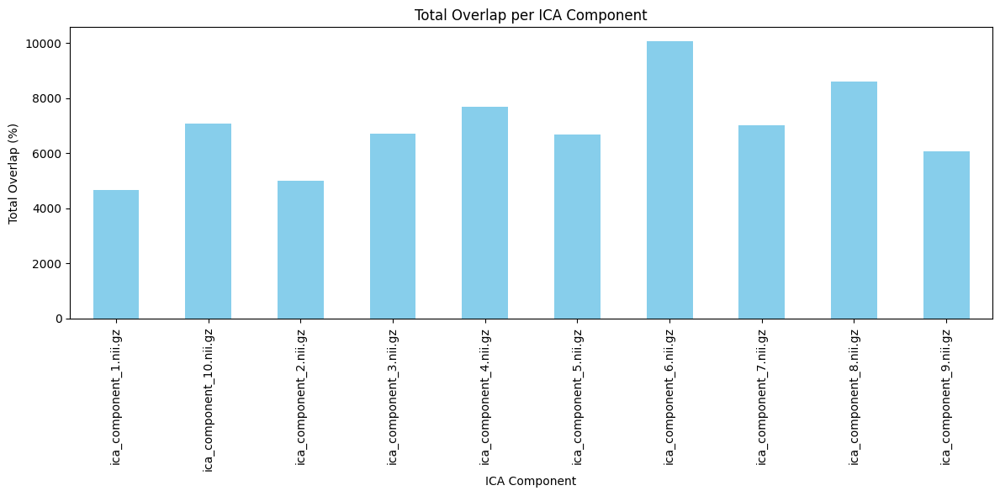

In [29]:
import pandas as pd
import matplotlib.pyplot as plt

# Load the CSV file
df = pd.read_csv("/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ica_network_overlap.csv", sep=",")  # Update path and separator if needed

# Set 'Component' as index
df.set_index("Component", inplace=True)

# Calculate total overlap per ICA component
total_overlap = df.sum(axis=1)

# Plot total overlap
plt.figure(figsize=(12, 6))
total_overlap.plot(kind='bar', color='skyblue')
plt.title("Total Overlap per ICA Component")
plt.ylabel("Total Overlap (%)")
plt.xlabel("ICA Component")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

* Adds up overlap %s across all networks for each component.
* Higher value = more total coverage of Yeo networks.

## visualizing the overlap of each ICA component

visualizing the overlap of each ICA component with each network (instead of just the total) gives much richer insight

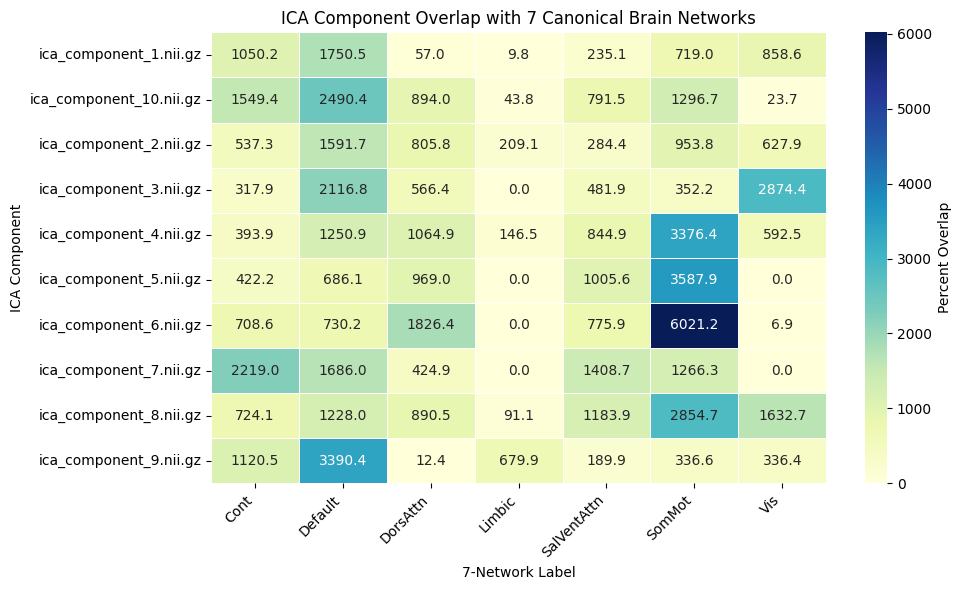

In [9]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the CSV file
df = pd.read_csv("/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ica_network_overlap_Ln.csv")
df.set_index("Component", inplace=True)

# Extract main network names from column labels (e.g., '7Networks_LH_Vis_1' → 'Vis')
def extract_network_name(col_name):
    parts = col_name.split('_')
    if len(parts) >= 3:
        return parts[2]  # e.g., 'Vis', 'SomMot', etc.
    return col_name

# Map each column (parcel) to its parent network (e.g., 'Vis', 'SomMot', etc.)
network_groups = df.columns.to_series().apply(extract_network_name)

# Group columns by parent network and sum their overlap
df_grouped = df.groupby(network_groups, axis=1).sum()

# Plot heatmap of ICA components × 7 Networks
plt.figure(figsize=(10, 6))
sns.heatmap(df_grouped, cmap="YlGnBu", annot=True, fmt=".1f", linewidths=0.5, cbar_kws={'label': 'Percent Overlap'})
plt.title("ICA Component Overlap with 7 Canonical Brain Networks")
plt.ylabel("ICA Component")
plt.xlabel("7-Network Label")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

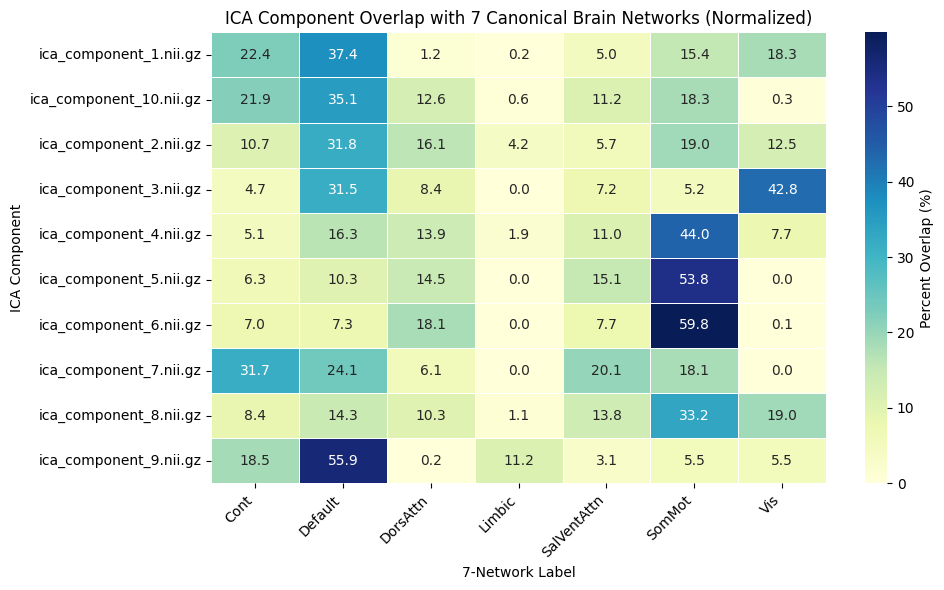

In [12]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Load the CSV file
df = pd.read_csv("/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ica_network_overlap_Ln.csv")
df.set_index("Component", inplace=True)

# Extract main network names from column labels (e.g., '7Networks_LH_Vis_1' → 'Vis')
def extract_network_name(col_name):
    parts = col_name.split('_')
    if len(parts) >= 3:
        return parts[2]  # e.g., 'Vis', 'SomMot', etc.
    return col_name

# Map each column (parcel) to its parent network (e.g., 'Vis', 'SomMot', etc.)
network_groups = df.columns.to_series().apply(extract_network_name)

# Group columns by parent network and sum their overlap
df_grouped = df.groupby(network_groups, axis=1).sum()

# Normalize each row to show percentage overlap per ICA component
df_percent = df_grouped.div(df_grouped.sum(axis=1), axis=0) * 100

# Plot heatmap of true percentages
plt.figure(figsize=(10, 6))
sns.heatmap(df_percent, cmap="YlGnBu", annot=True, fmt=".1f", linewidths=0.5,
            cbar_kws={'label': 'Percent Overlap (%)'})
plt.title("ICA Component Overlap with 7 Canonical Brain Networks (Normalized)")
plt.ylabel("ICA Component")
plt.xlabel("7-Network Label")
plt.xticks(rotation=45, ha='right')
plt.tight_layout()
plt.show()

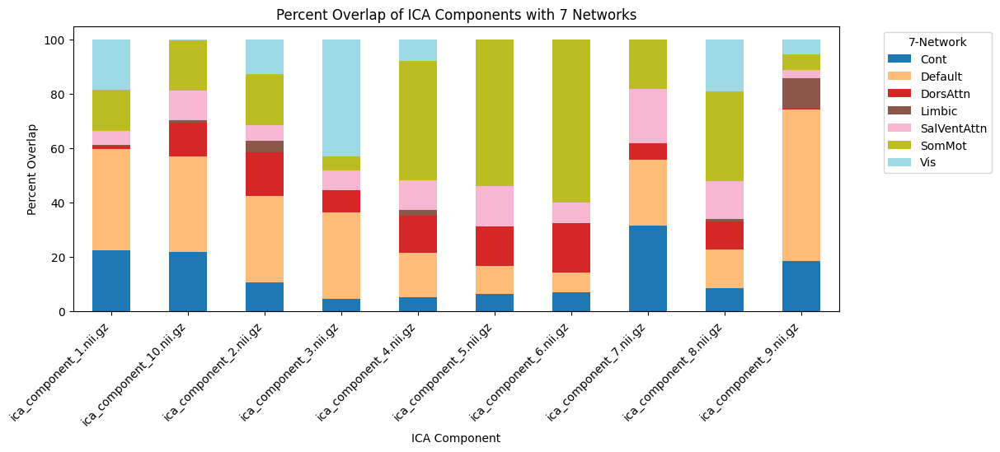

In [10]:
import matplotlib.pyplot as plt

# Normalize if needed (choose this if you want percentage stacked bar)
df_plot = df_grouped.div(df_grouped.sum(axis=1), axis=0) * 100  # for percent overlap

# Plot as stacked bar chart
ax = df_plot.plot(kind='bar', stacked=True, figsize=(12, 6), colormap='tab20')
plt.title("Percent Overlap of ICA Components with 7 Networks")
plt.ylabel("Percent Overlap")
plt.xlabel("ICA Component")
plt.legend(title="7-Network", bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.xticks(rotation=45, ha='right')
plt.show()

Raw Voxel Overlap (Unnormalized)

	•	Components such as ica_component_6, ica_component_5, and ica_component_4 show very high overlap with the Somatomotor network, with raw voxel counts exceeding 3000–6000, indicating these ICA components are largely motor-related.
	
    •	ica_component_9 has extremely high overlap with the Default Mode Network (DMN), suggesting a strong association with introspective or resting-state processes.
	
    •	Some components (e.g., ica_component_3 and ica_component_8) overlap notably with Visual or Dorsal Attention networks, hinting at their role in perceptual or attentional processes.
	
    •	These raw values reflect absolute spatial coverage, so high numbers can be due to large components or dense coverage.

Normalized Percent Overlap (Per ICA Component)

When normalized:

	•	ica_component_6 dedicates ~70% of its volume to the Somatomotor network, confirming it as highly motor-specific.
	•	ica_component_9 is dominated by the Default Mode Network, accounting for ~75–80% of its spatial extent.
	•	ica_component_7 shows a more balanced distribution across networks, with noticeable contributions from Control, Default, and Salience/Attention, implying it may integrate multiple functions.
	•	ica_component_1 spreads across Control, Default, and Visual, suggesting it’s less specialized and potentially captures noise or broad connectivity.

#### Brain Maps Showing ICA vs Atlas Overlaps

/Users/onilarasanjala/mambaforge/envs/neuro_project/lib/python3.9/site-packages/nilearn/_utils/param_validation.py:72: UserWarning: The given float value must not exceed 0.005936845138514485. But, you have given threshold=2.5 
  warnings.warn("The given float value must not exceed {0}. "


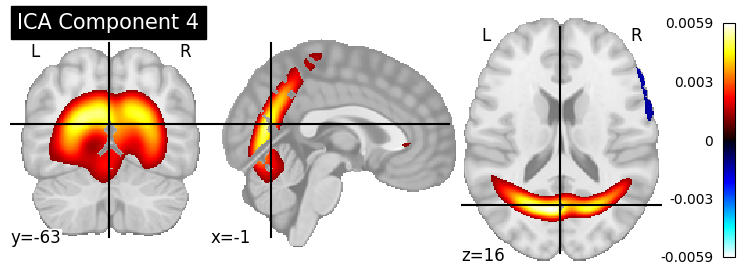

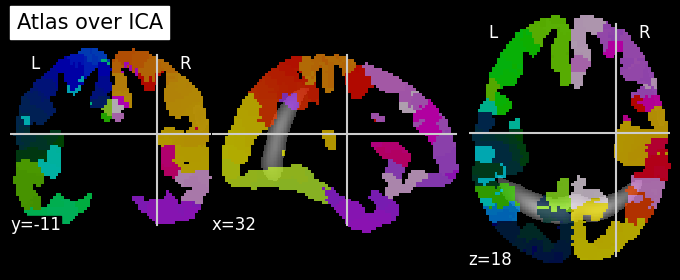

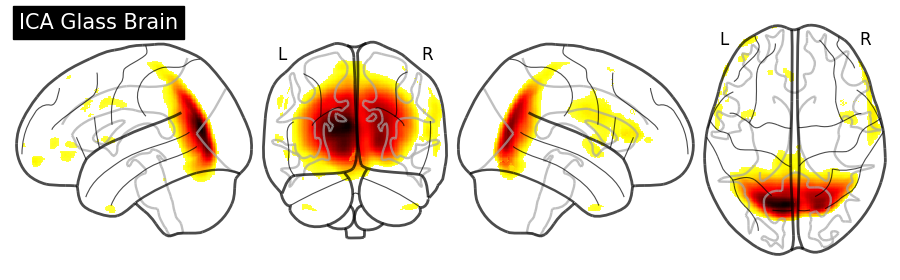

In [33]:
from nilearn import plotting, image
import os

# Load ICA component and atlas (NIfTI files)
ica_path = '/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_Ln_com/ica_component_3.nii.gz'  # update as needed
atlas_path = '/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz'

# Plot ICA component over the brain
plotting.plot_stat_map(ica_path, title='ICA Component 4')

# Threshold the ICA map and plot overlaps
ica_img = image.load_img(ica_path)
atlas_img = image.load_img(atlas_path)

# Threshold ICA image
thresholded_ica = image.threshold_img(ica_img, threshold=2.5)  # choose suitable threshold

# Plot overlay
plotting.plot_roi(atlas_img, bg_img=ica_img, title="Atlas over ICA")

# You can also use glass brain:
plotting.plot_glass_brain(ica_path, display_mode='lyrz', title="ICA Glass Brain")

##  correlation analysis between multiple ICA components

### Averaged signals over 1000 individual parcels from the Schaefer atlas

In [35]:
import numpy as np
import os
import nibabel as nib
from nilearn.maskers import NiftiLabelsMasker  # updated per deprecation warning
import pandas as pd
from nilearn.connectome import ConnectivityMeasure

# Paths
ica_dir = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/ICA_Ln_com"
atlas_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order_FSLMNI152_2mm.nii.gz"

# List ICA components
ica_paths = [os.path.join(ica_dir, f) for f in sorted(os.listdir(ica_dir)) if f.endswith('.nii') or f.endswith('.nii.gz')]

# Create masker for atlas
masker = NiftiLabelsMasker(labels_img=atlas_path, standardize=False)

# Extract average signal across parcels for each ICA component
ica_signals = []
for path in ica_paths:
    img = nib.load(path)
    signals = masker.fit_transform(img)  # shape = (1, 1000)
    mean_signal = np.mean(signals.reshape(-1, 1000), axis=0)  # 1D: (1000,)
    ica_signals.append(mean_signal)

ica_signals = np.array(ica_signals)  # shape = (10, 1000)

# Transpose to get shape (1000, 10) so we can correlate components
ica_signals = ica_signals.T

# Compute correlation matrix across components
corr_measure = ConnectivityMeasure(kind='correlation')
corr_matrix = corr_measure.fit_transform([ica_signals])[0]  # shape: (10, 10)

# Display and save
component_names = [os.path.basename(f) for f in ica_paths]
df_corr = pd.DataFrame(corr_matrix, index=component_names, columns=component_names)
print(df_corr)
df_corr.to_csv("ica_component_correlation_matrix.csv")

                         ica_component_1.nii.gz  ica_component_10.nii.gz  \
ica_component_1.nii.gz                 1.000000                 0.067296   
ica_component_10.nii.gz                0.067296                 1.000000   
ica_component_2.nii.gz                 0.021055                -0.016051   
ica_component_3.nii.gz                 0.052712                -0.049642   
ica_component_4.nii.gz                 0.055379                 0.021671   
ica_component_5.nii.gz                 0.040327                 0.163958   
ica_component_6.nii.gz                 0.036427                -0.059639   
ica_component_7.nii.gz                 0.072717                 0.133357   
ica_component_8.nii.gz                 0.074239                -0.070790   
ica_component_9.nii.gz                 0.003892                -0.065670   

                         ica_component_2.nii.gz  ica_component_3.nii.gz  \
ica_component_1.nii.gz                 0.021055                0.052712   
ica_component

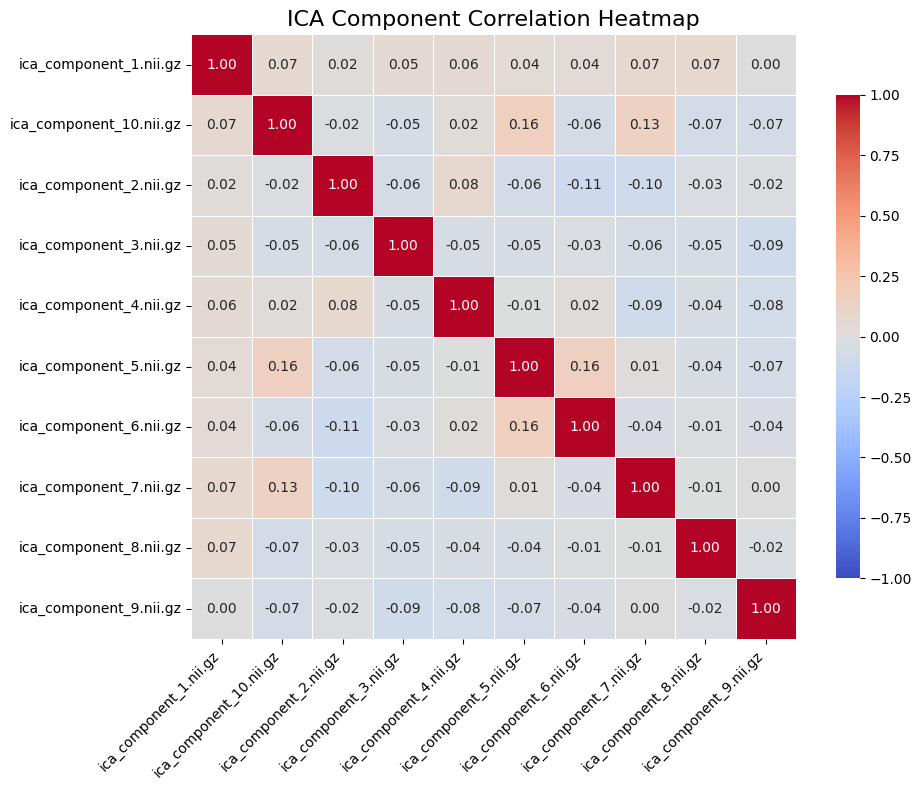

In [13]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the correlation matrix from the CSV file
df_corr = pd.read_csv("ica_component_correlation_matrix.csv", index_col=0)

# Set up the matplotlib figure
plt.figure(figsize=(10, 8))

# Draw the heatmap
sns.heatmap(df_corr, 
            annot=True,            # Show correlation values in each cell
            fmt=".2f",             # Format values to 2 decimal places
            cmap="coolwarm",       # Color scheme
            vmin=-1, vmax=1,       # Fix scale for better comparison
            linewidths=0.5,        # Line between cells
            square=True,           # Make cells square
            cbar_kws={"shrink": 0.8})  # Shrink color bar

# Titles and labels
plt.title("ICA Component Correlation Heatmap", fontsize=16)
plt.xticks(rotation=45, ha='right')  # Rotate x labels
plt.yticks(rotation=0)

# Show the plot
plt.tight_layout()
plt.show()

### Averaged signals over 7 large-scale networks (Visual, SomMot, etc.) using parcel-to-network mapping

In [40]:
import numpy as np
import os
import nibabel as nib
from nilearn.input_data import NiftiLabelsMasker
import pandas as pd
from nilearn.connectome import ConnectivityMeasure

# Mapping network names to IDs
network_name_to_id = {
    'Vis': 1,
    'SomMot': 2,
    'DorsAttn': 3,
    'SalVentAttn': 4,
    'Limbic': 5,
    'Cont': 6,
    'Default': 7
}

# Load and parse the file
network_labels = []

txt_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

with open(txt_path, 'r') as f:
    for line in f:
        parts = line.strip().split()
        if len(parts) < 2:
            continue
        label = parts[1]
        for key in network_name_to_id:
            if key in label:
                network_labels.append(network_name_to_id[key])
                break

network_labels = np.array(network_labels)

# Validate
assert len(network_labels) == 1000, f"Expected 1000 labels, got {len(network_labels)}"
print("Parsed 1000 parcel-to-network mappings successfully.")

# List ICA components
ica_paths = [os.path.join(ica_dir, f) for f in sorted(os.listdir(ica_dir)) if f.endswith('.nii') or f.endswith('.nii.gz')]

# Create masker for atlas
masker = NiftiLabelsMasker(labels_img=atlas_path, standardize=True)

ica_signals = []
for path in ica_paths:
    img = nib.load(path)
    signals = masker.fit_transform(img)  # shape: (1, 1000)
    
    if signals.ndim == 1:
        signals = signals[np.newaxis, :]
    
    # Mean signals across 7 networks
    network_means = []
    for net in range(1, 8):  # Network labels: 1 to 7
        indices = np.where(network_labels == net)[0]
        network_mean = np.mean(signals[:, indices], axis=1)  # mean across parcels in the network
        network_means.append(network_mean[0])
    
    ica_signals.append(network_means)

ica_signals = np.array(ica_signals)  # shape: (n_components, 7)

# Compute correlation across ICA components
corr_measure = ConnectivityMeasure(kind='correlation')
corr_matrix = corr_measure.fit_transform([ica_signals.T])[0]
df_corr = pd.DataFrame(corr_matrix, index=component_names, columns=component_names)

# Display and save
component_names = [os.path.basename(f) for f in ica_paths]
df_corr = pd.DataFrame(corr_matrix, index=component_names, columns=component_names)
print(df_corr)
df_corr.to_csv("ica_component_correlation_matrix_7net.csv")

Parsed 1000 parcel-to-network mappings successfully.


/Users/onilarasanjala/mambaforge/envs/neuro_project/lib/python3.9/site-packages/nilearn/signal.py:69: UserWarning: Standardization of 3D signal has been requested but would lead to zero values. Skipping.
  warnings.warn('Standardization of 3D signal has been requested but '


                         ica_component_1.nii.gz  ica_component_10.nii.gz  \
ica_component_1.nii.gz                 1.000000                 0.085123   
ica_component_10.nii.gz                0.085123                 1.000000   
ica_component_2.nii.gz                 0.045168                 0.190287   
ica_component_3.nii.gz                -0.176675                -0.026487   
ica_component_4.nii.gz                 0.065238                 0.020768   
ica_component_5.nii.gz                 0.100402                 0.097336   
ica_component_6.nii.gz                 0.071184                 0.069418   
ica_component_7.nii.gz                 0.100710                 0.229723   
ica_component_8.nii.gz                 0.028556                 0.002923   
ica_component_9.nii.gz                 0.138925                 0.044636   

                         ica_component_2.nii.gz  ica_component_3.nii.gz  \
ica_component_1.nii.gz                 0.045168               -0.176675   
ica_component

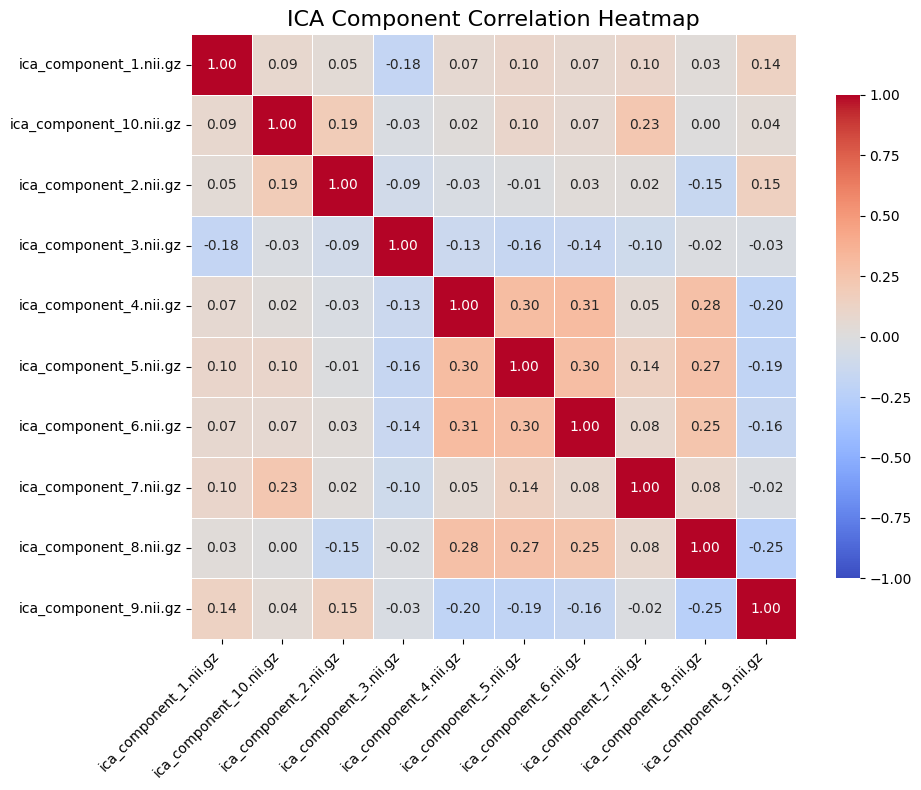

In [14]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load the correlation matrix from the CSV file
df_corr = pd.read_csv("ica_component_correlation_matrix_7net.csv", index_col=0)

# Set up the matplotlib figure
plt.figure(figsize=(10, 8))

# Draw the heatmap
sns.heatmap(df_corr, 
            annot=True,            # Show correlation values in each cell
            fmt=".2f",             # Format values to 2 decimal places
            cmap="coolwarm",       # Color scheme
            vmin=-1, vmax=1,       # Fix scale for better comparison
            linewidths=0.5,        # Line between cells
            square=True,           # Make cells square
            cbar_kws={"shrink": 0.8})  # Shrink color bar

# Titles and labels
plt.title("ICA Component Correlation Heatmap", fontsize=16)
plt.xticks(rotation=45, ha='right')  # Rotate x labels
plt.yticks(rotation=0)

# Show the plot
plt.tight_layout()
plt.show()

In [41]:
import numpy as np
import os
import nibabel as nib
from nilearn.input_data import NiftiLabelsMasker
import pandas as pd
from nilearn.connectome import ConnectivityMeasure

# Mapping network names to IDs
network_name_to_id = {
    'Vis': 1,
    'SomMot': 2,
    'DorsAttn': 3,
    'SalVentAttn': 4,
    'Limbic': 5,
    'Cont': 6,
    'Default': 7
}

# Load and parse the file
network_labels = []

txt_path = "/Users/onilarasanjala/Desktop/Third Semester/Cog Neu Science/Code files and data/networks/Schaefer2018_1000Parcels_7Networks_order.txt"

with open(txt_path, 'r') as f:
    for line in f:
        parts = line.strip().split()
        if len(parts) < 2:
            continue
        label = parts[1]
        for key in network_name_to_id:
            if key in label:
                network_labels.append(network_name_to_id[key])
                break

network_labels = np.array(network_labels)

# Validate
assert len(network_labels) == 1000, f"Expected 1000 labels, got {len(network_labels)}"
print("Parsed 1000 parcel-to-network mappings successfully.")

# List ICA components
ica_paths = [os.path.join(ica_dir, f) for f in sorted(os.listdir(ica_dir)) if f.endswith('.nii') or f.endswith('.nii.gz')]

# Create masker for atlas
masker = NiftiLabelsMasker(labels_img=atlas_path, standardize=True)

ica_signals = []
for path in ica_paths:
    img = nib.load(path)
    signals = masker.fit_transform(img)  # shape: (1, 1000)
    
    if signals.ndim == 1:
        signals = signals[np.newaxis, :]
    
    # Mean signals across 7 networks
    network_means = []
    for net in range(1, 8):  # Network labels: 1 to 7
        indices = np.where(network_labels == net)[0]
        network_mean = np.mean(signals[:, indices], axis=1)  # mean across parcels in the network
        network_means.append(network_mean[0])
    
    ica_signals.append(network_means)

ica_signals = np.array(ica_signals)  # shape: (n_components, 7)

# Compute correlation across ICA components
corr_measure = ConnectivityMeasure(kind='correlation')
corr_matrix = corr_measure.fit_transform([ica_signals])[0]
df_corr = pd.DataFrame(corr_matrix, index=network_labels_names, columns=network_labels_names)

# Display and save
component_names = [os.path.basename(f) for f in ica_paths]
df_corr = pd.DataFrame(corr_matrix, index=component_names, columns=component_names)
print(df_corr)
df_corr.to_csv("ica_component_correlation_matrix_7net.csv")

Parsed 1000 parcel-to-network mappings successfully.


/Users/onilarasanjala/mambaforge/envs/neuro_project/lib/python3.9/site-packages/nilearn/signal.py:69: UserWarning: Standardization of 3D signal has been requested but would lead to zero values. Skipping.
  warnings.warn('Standardization of 3D signal has been requested but '


NameError: name 'network_labels_names' is not defined

### Goal: Recreate Figure Similar to “SuperEEG” Style

Step 1: Plot ICA Components as Individual Brain Maps (Colored by ICA Number)

Step 2: For Each ICA Component, Show Pie Chart of Network Overlap %

Step 3: (Optional) Add a color-legend for networks